# This file is final version of data models except for AE and Analysis
- Saving plots, models and output is disabled
- Read UTD19 for city
- Read OSM map
- Crop map
- Geolocate detectors to edges
    - Plot of network and detectors
- Choose valid detectors and counts
    - Plot of network and final detectors
    - Sample plot of counts at time slice
- Choose OD nodes
- Choose routes
    - Plot of routes
- Make adjacency matrix for edge/route with and without counts
- Make route choice transition matrix with and without memory !calculation corrected from earlier!
- *No method of moments impelmentation here
- *CVXPY commented out does not give a result for tests thus far
- MCMC with Poisson draws (does tuning of variance mean it's negative binomial)
    - Final run was of validation and test sample 892 minutes 1.3GB lambda file
    - Heatmap of OD v time
    - Scatter of counts v estimated counts
    - Trace plots of lambda
- MLP with train and validation
    - Heatmap of OD v time
    - Scatter of counts v estimated counts
- AE ipynb same as MLP

# 1. Read in UTD19 data

Use python environment "ox" or "final_proj_torch"<br>

Permanent link:
https://doi.org/10.3929/ethz-b-000437802<br>

Rights / license:
Creative Commons Attribution-NonCommercial-ShareAlike 4.0 International<br>

Loder, A., Ambühl, L., Menendez, M. and Axhausen, K.W. (2020) UTD19: Urban traffic data
from 40 cities, , , Institute for Transport Planning and Systems (IVT), ETH Zurich, Zurich.


In [1]:
import pandas as pd
import geopandas
import numpy as np
import cvxpy as cvx
import osmnx as osmnx
import networkx as nx
import matplotlib.pyplot as plt

### Data directory

In [2]:
data_dir = "../UTD2019/"
counts_file = "utd19_u - Copy.csv"
detectors_file = "detectors_public - Copy.csv"
links_file = "links.csv"

### Hard-coded list of cities in the dataset

In [3]:
cities_list=np.array(['augsburg', 'basel', 'bern', 'birmingham', 'bolton', 'bordeaux',
       'bremen', 'cagliari', 'constance', 'darmstadt', 'essen',
       'frankfurt', 'graz', 'groningen', 'hamburg', 'innsbruck', 'kassel',
       'london', 'losangeles', 'luzern', 'madrid', 'melbourne',
       'manchester', 'marseille', 'munich', 'paris', 'rotterdam',
       'santander', 'speyer', 'strasbourg', 'stuttgart', 'taipeh',
       'torino', 'toronto', 'toulouse', 'utrecht', 'vilnius', 'wolfsburg',
       'zurich'], dtype=object)

### City to analyze

In [4]:
# city = "all" to read in original dataset (6GB) and write out each city's dataset separately
city="melbourne"
city_file = "counts_"+city+".csv"

## 1A. Read in counts

In [5]:
if(city=="all"):
    data = pd.read_csv("C:/Users/jkhac/Documents/AML/Project resources and readings/Transportation/UTD2019/utd19_u - Copy.csv")
    count_data = pd.read_csv(data_dir + counts_file)
else:
    print("Reading in data for " + city)
    count_data = pd.read_csv(data_dir + city_file)

Reading in data for melbourne


In [6]:
count_data.head()

,day,interval,detid,flow,occ,error,city,speed
0,2018-02-12,0,K1036.D1,16.0,NaN,1.0,melbourne,NaN
1,2018-02-12,900,K1036.D1,20.0,NaN,1.0,melbourne,NaN
2,2018-02-12,1800,K1036.D1,4.0,NaN,1.0,melbourne,NaN
3,2018-02-12,2700,K1036.D1,8.0,NaN,1.0,melbourne,NaN
4,2018-02-12,3600,K1036.D1,12.0,NaN,1.0,melbourne,NaN


In [7]:
count_data.shape

(1369849, 8)

In [8]:
count_data.dtypes

day          object
interval      int64
detid        object
flow        float64
occ         float64
error       float64
city         object
speed       float64
dtype: object

In [9]:
cities_list=count_data["city"].unique()

In [10]:
cities_list

array(['melbourne'], dtype=object)

### City to "all" to write separate city files from entire counts dataset (40 cities)

In [11]:
# Iterate cities list
if(city=="all"):
    for city in cities_list:
        print(city)
    #write to disk
        count_data.loc[count_data["city"]== city].to_csv(data_dir + "counts_" + city + ".csv", encoding = "utf-8", index = False)

## 1B. Read in the network links with detectors on them for all cities
- linkid links to detectors dataframe: type int64
- linkid signifies a <i>lane</i> of traffic
- used in UTD19 to determine if the detector is near an intersection in order to correct density measurements
### linkid is not the same as in the OSM network. Thus this link dataframe may not be useful at all
- piece is a spatial feature number and = 1
- group is group number of that spatial feature
- lat/lon refer to waypoint location (waypoint is OSM jargon for a point)
- order is the order of the waypoint sequence (indicating flow direction)
- missing value flag is unknown. Check for NaN, nan, Inf, inf, NA, na, ...

In [12]:
link_data = pd.read_csv(data_dir + links_file)

In [13]:
link_data.head()

,long,lat,order,piece,linkid,group,citycode
0,10.891016,48.361079,1,1,0,0.1,augsburg
1,10.890894,48.360993,2,1,0,0.1,augsburg
2,10.890642,48.360853,3,1,0,0.1,augsburg
3,10.890404,48.360719,4,1,0,0.1,augsburg
4,10.889994,48.360497,5,1,0,0.1,augsburg


In [14]:
link_data.dtypes

long        float64
lat         float64
order         int64
piece         int64
linkid        int64
group       float64
citycode     object
dtype: object

### Make a dataframe of links for city that is being analyzed

In [15]:
city_link_data=link_data.loc[link_data["citycode"]==city]

### Check the link dataset for missing values

In [16]:
city_link_data.head()

,long,lat,order,piece,linkid,group,citycode
84245,144.953848,-37.812491,1,1,0,0.1,melbourne
84246,144.953132,-37.812692,2,1,0,0.1,melbourne
84247,144.952239,-37.812960,3,1,0,0.1,melbourne
84248,144.951815,-37.813084,4,1,0,0.1,melbourne
84249,144.951553,-37.813167,5,1,0,0.1,melbourne


In [17]:
city_link_data.shape

(5153, 7)

In [18]:
#No missing values of linkid
np.where(pd.isna(link_data["linkid"]))

(array([], dtype=int64),)

## 1C. Read in attributes of the detectors
- Note the variable types were not specified at reading
- limit, lanes, linkid should be int
- missing values may be NA or Inf or blanks need to check all
- bordeaux, constance, utrecht have blank linkid's

In [19]:
detectors_data=pd.read_csv(data_dir + detectors_file)

In [20]:
detectors_data.head()

,detid,length,pos,fclass,road,limit,citycode,lanes,linkid,long,lat
0,U1-52G,0.196037,0.005512,secondary,Gögginger Straße,50,augsburg,1.0,72.0,10.889553,48.359957
1,U1-51G,0.130039,0.004013,secondary,Gögginger Straße,50,augsburg,1.0,73.0,10.889601,48.359945
2,U1-52L,0.155863,0.022228,secondary,Gögginger Straße,50,augsburg,1.0,70.0,10.889356,48.359876
3,U1-51L,0.197675,0.021889,secondary,Gögginger Straße,50,augsburg,1.0,71.0,10.889396,48.359862
4,U1-62,0.065183,0.024465,secondary,Rosenaustraße,50,augsburg,1.0,68.0,10.889361,48.360578


### Check data types in detectors dataFrame and check detectors for missing or bad-value data

In [21]:
#detectors_data["linkid"]=detectors_data["linkid"].astype(int) # type conversion gives error due to Inf or Na values

# Check where the detector link is not recorded. Test for null or na values gives the same indices
#np.where(pd.isnull(detectors_data["linkid"]))[0].size
np.where(pd.isna(detectors_data["linkid"]))[0].size

605

In [22]:
# Detectors with no linkid
detectors_data.loc[detectors_data["linkid"].isna()]

,detid,length,pos,fclass,road,limit,citycode,lanes,linkid,long,lat
1781,Z28CT8,0.474150,0.441611,secondary,Avenue Descartes,50,bordeaux,1.0,NaN,-0.696258,44.887152
1782,Z28CT6,0.382875,0.199677,secondary,Avenue Montaigne,0,bordeaux,1.0,NaN,-0.712123,44.893825
1783,Z28CT4,1.302693,0.189114,secondary,Avenue du Général de Gaulle,0,bordeaux,1.0,NaN,-0.722563,44.897409
1784,Z28CT5,0.625746,0.174092,tertiary,Rue Jean-Jacques Rousseau,0,bordeaux,1.0,NaN,-0.723640,44.895645
1785,Z9CT1,0.343356,0.240580,primary,Boulevard Antoine Gautier,0,bordeaux,2.0,NaN,-0.598935,44.835672
...,...,...,...,...,...,...,...,...,...,...,...
21887,PUT02_BT0092_BT0093,0.690000,NaN,secondary,Vleutenseweg,50,utrecht,1.0,NaN,5.095791,52.093473
21888,PUT02_BT0093_BT0094,0.829000,NaN,secondary,Vleutenseweg,50,utrecht,1.0,NaN,5.086000,52.094974
21889,PUT02_BT0094_BT0093,0.869000,NaN,primary,Oude Vleutenseweg,50,utrecht,1.0,NaN,5.075023,52.097846
21890,PUT03_BT0113_BT0114,0.416000,NaN,tertiary,Rijnlaan,50,utrecht,1.0,NaN,5.113597,52.067515


### Make a dataframe of detectors only for the city being analyzed and drop rows where no linkid
- linkid is useful later for finding the orientation of the link of the detector
- to get it onto the correct lane

In [23]:
sum(detectors_data.citycode==city)

1630

In [24]:
detectors_data = detectors_data[~detectors_data.linkid.isna()]
#df[~df['this_column'].isna()]

In [25]:
detectors_data.head()

,detid,length,pos,fclass,road,limit,citycode,lanes,linkid,long,lat
0,U1-52G,0.196037,0.005512,secondary,Gögginger Straße,50,augsburg,1.0,72.0,10.889553,48.359957
1,U1-51G,0.130039,0.004013,secondary,Gögginger Straße,50,augsburg,1.0,73.0,10.889601,48.359945
2,U1-52L,0.155863,0.022228,secondary,Gögginger Straße,50,augsburg,1.0,70.0,10.889356,48.359876
3,U1-51L,0.197675,0.021889,secondary,Gögginger Straße,50,augsburg,1.0,71.0,10.889396,48.359862
4,U1-62,0.065183,0.024465,secondary,Rosenaustraße,50,augsburg,1.0,68.0,10.889361,48.360578


### Drop the variable "limit" (speed limit) because it often has NaN and it's not needed

In [26]:
city_detectors_data=detectors_data[detectors_data["citycode"]==city]
city_detectors_data.drop(columns=["limit"])

,detid,length,pos,fclass,road,citycode,lanes,linkid,long,lat
13574,K4476.D1,0.086145,0.020738,tertiary,Bourke Street,melbourne,1.0,862.0,144.948762,-37.818452
13575,K4576.D5,0.113111,0.019706,tertiary,Exhibition Street,melbourne,1.0,343.0,144.971430,-37.813794
13576,K4576.D6,0.116698,0.020620,tertiary,Exhibition Street,melbourne,1.0,344.0,144.971401,-37.813805
13577,K4576.D10,0.212780,0.015236,tertiary,Collins Street,melbourne,1.0,345.0,144.971175,-37.814092
13578,K4576.D2,0.223094,0.023529,tertiary,Collins Street,melbourne,1.0,342.0,144.971878,-37.813996
...,...,...,...,...,...,...,...,...,...,...
15199,2128,0.156109,0.000000,tertiary,Power Street,melbourne,1.0,2128.0,144.961654,-37.823538
15200,2129,0.195684,0.000000,trunk,City Road,melbourne,1.0,2129.0,144.963250,-37.823050
15201,2130,0.190658,0.000000,trunk,City Road,melbourne,1.0,2130.0,144.963373,-37.823227
15202,2131,1.202346,0.000000,trunk,Alexandra Avenue,melbourne,1.0,2131.0,144.970273,-37.820673


In [27]:
city_detectors_data.dtypes

detid        object
length      float64
pos         float64
fclass       object
road         object
limit        object
citycode     object
lanes       float64
linkid      float64
long        float64
lat         float64
dtype: object

In [28]:
np.set_printoptions(threshold=np.inf)
print(len(city_detectors_data["detid"].unique()))
print(city_detectors_data["detid"].unique())

1630
['K4476.D1' 'K4576.D5' 'K4576.D6' 'K4576.D10' 'K4576.D2' 'K4576.D3'
 'K4576.D9' 'K4577.D7' 'K4577.D2' 'K4577.D4' 'K4577.D3' 'K4579.D2'
 'K4580.D3' 'K4580.D6' 'K4580.D7' 'K4582.D1' 'K4583.D5' 'K4583.D8'
 'K4583.D4' 'K4583.D2' 'K4584.D2' 'K4584.D3' 'K4584.D5' 'K4584.D8'
 'K4584.D10' 'K4584.D1' 'K4584.D4' 'K4584.D13' 'K4451.D3' 'K4451.D2'
 'K4451.D5' 'K4451.D6' 'K4453.D6' 'K4453.D1' 'K4453.D2' 'K4453.D4'
 'K4453.D3' 'K4455.D8' 'K4455.D10' 'K4455.D11' 'K4455.D7' 'K4455.D5'
 'K4455.D6' 'K4455.D3' 'K4455.D9' 'K4455.D4' 'K4457.D5' 'K4457.D6'
 'K4457.D4' 'K4457.D3' 'K4404.D9' 'K4404.D6' 'K4404.D5' 'K4404.D11'
 'K4404.D8' 'K4404.D10' 'K4404.D2' 'K4404.D7' 'K4404.D3' 'K4404.D16'
 'K4404.D12' 'K4405.D12' 'K4405.D13' 'K4405.D2' 'K4405.D14' 'K4405.D4'
 'K4405.D1' 'K4405.D9' 'K4405.D6' 'K4405.D8' 'K4405.D10' 'K4405.D5'
 'K4370.D7' 'K4370.D2' 'K4370.D1' 'K4370.D5' 'K4370.D3' 'K4370.D12'
 'K4370.D6' 'K1045.D5' 'K1051.D5' 'K1051.D1' 'K1051.D4' 'K1052.D2'
 'K1052.D4' 'K1052.D1' 'K1052.D5' 'K1052.D7

In [29]:
city_detectors_data.head()

,detid,length,pos,fclass,road,limit,citycode,lanes,linkid,long,lat
13574,K4476.D1,0.086145,0.020738,tertiary,Bourke Street,NaN,melbourne,1.0,862.0,144.948762,-37.818452
13575,K4576.D5,0.113111,0.019706,tertiary,Exhibition Street,40,melbourne,1.0,343.0,144.971430,-37.813794
13576,K4576.D6,0.116698,0.020620,tertiary,Exhibition Street,40,melbourne,1.0,344.0,144.971401,-37.813805
13577,K4576.D10,0.212780,0.015236,tertiary,Collins Street,40,melbourne,1.0,345.0,144.971175,-37.814092
13578,K4576.D2,0.223094,0.023529,tertiary,Collins Street,40,melbourne,1.0,342.0,144.971878,-37.813996


In [30]:
print(count_data.detid.unique())

['K1036.D1' 'K1036.D3' 'K1036.D4' 'K1037.D1' 'K1037.D2' 'K1037.D3'
 'K1038.D1' 'K1038.D2' 'K1038.D3' 'K1038.D4' 'K1038.D5' 'K1038.D6'
 'K1039.D1' 'K1039.D2' 'K1039.D3' 'K1039.D4' 'K1039.D6' 'K1045.D5'
 'K1051.D1' 'K1051.D4' 'K1051.D5' 'K1052.D1' 'K1052.D2' 'K1052.D4'
 'K1052.D5' 'K1052.D7' 'K1052.D9' 'K1057.D1' 'K1057.D3' 'K1057.D6'
 'K1057.D8' 'K1059.D2' 'K1061.D12' 'K1061.D2' 'K1061.D3' 'K1061.D4'
 'K1061.D5' 'K1061.D7' 'K1061.D8' 'K1061.D9' 'K1065.D2' 'K1065.D3'
 'K1065.D4' 'K1066.D1' 'K1066.D3' 'K1066.D4' 'K1066.D5' 'K2024.D1'
 'K2024.D2' 'K2024.D3' 'K2901.D10' 'K2901.D6' 'K2901.D7' 'K2901.D9'
 'K2902.D10' 'K2902.D11' 'K2902.D12' 'K2902.D2' 'K2902.D3' 'K2902.D5'
 'K2902.D6' 'K2902.D7' 'K2902.D8' 'K2902.D9' 'K2903.D10' 'K2903.D11'
 'K2903.D13' 'K2903.D14' 'K2903.D2' 'K2903.D3' 'K2903.D6' 'K2903.D7'
 'K2904.D10' 'K2904.D6' 'K2904.D7' 'K2904.D9' 'K2907.D11' 'K2907.D12'
 'K2907.D2' 'K2907.D3' 'K2907.D4' 'K2907.D5' 'K2907.D7' 'K2907.D8'
 'K2907.D9' 'K2909.D1' 'K2909.D14' 'K2909.D2' 'K29

In [31]:
city_detectors_data=city_detectors_data[city_detectors_data.detid.isin(list(count_data.detid))]

In [32]:
print(len(city_detectors_data["detid"].unique()))

954


## Adjust the data type of some columns -- only works if the NaN have been removed

In [33]:
#city_detectors_data["limit"]=city_detectors_data["limit"].astype("int64")
city_detectors_data["lanes"]=city_detectors_data["lanes"].astype("int64")
city_detectors_data["linkid"]=city_detectors_data["linkid"].astype("int64")

In [34]:
city_detectors_data.dtypes

detid        object
length      float64
pos         float64
fclass       object
road         object
limit        object
citycode     object
lanes         int64
linkid        int64
long        float64
lat         float64
dtype: object

## Sometimes a road link has speed limit 0
- Do not remove for now but make note for later troubleshooting
- Will be superceded in the road network by new speed limits from OSM

In [35]:
city_detectors_data.loc[city_detectors_data["limit"]==0]

,detid,length,pos,fclass,road,limit,citycode,lanes,linkid,long,lat


In [36]:
print(f"The number of detectors: {city_detectors_data.shape[0]} and links from UTD19: {city_link_data.shape[0]}")

The number of detectors: 954 and links from UTD19: 5153


# 2. Data quality
## 2A. Examine the counts data

### Figure out the missing data flags: max and min (only relevant on entire counts dataset)

In [37]:
count_data.max()

day         2018-02-26
interval         85500
detid         K4923.D3
flow            2568.0
occ                NaN
error              1.0
city         melbourne
speed              NaN
dtype: object

In [38]:
count_data.min()

day         2018-02-12
interval             0
detid         K1036.D1
flow               0.0
occ                NaN
error              1.0
city         melbourne
speed              NaN
dtype: object

In [39]:
(count_data[count_data["flow"]==99999 | count_data["flow"].isnull()]).size

0

### The bad data flag is not noted in the data release documentation. From tests with the entire counts dataset:

In [40]:
# speed is nan and linkid is blank. the "missing" or "null" value in pandas is nan
flow_bad=99999
occ_bad=999.99
error_bad=1

In [41]:
print(f"variable   good    bad        isnull")

good=(count_data[count_data["flow"]!=flow_bad]).size
bad=(count_data[count_data["flow"]==flow_bad]).size
isnull=(count_data[count_data["flow"].isnull()]).size
print(f"flow       {good}   {bad}    {isnull}")

good=(count_data[count_data["occ"]!=occ_bad]).size
bad=(count_data[count_data["occ"]==occ_bad ]).size
isnull=(count_data[count_data["occ"].isnull()]).size
print(f"occ        {good}   {bad}    {isnull}")

good=(count_data[count_data["speed"].notnull()]).size
bad=(count_data[count_data["speed"].isnull()]).size
print(f"speed      {good}   {bad}    {bad}")

good=(count_data[count_data["error"]!=error_bad]).size
bad=(count_data[count_data["error"]==error_bad]).size
isnull=(count_data[count_data["error"].isnull()]).size
print(f"error      {good}   {bad}    {isnull}")

variable   good    bad        isnull
flow       10958792   0    0
occ        10958792   0    10958792
speed      0   10958792    10958792
error      9314096   1644696    9314096


### For calculations we only need the flow.
### Speed may be useful as a calibration or initial condition but it doesn't seem to be reliable
### Occupancy (occ) is the fraction of time a vehicle is passing over a sensor and is not necessary for calculations
### Error is supposed to be 0 (good) or 1 (bad) but doesn't seem to be reliable

## Max count of up to 10,000 should be acceptable as real data (personal communication with Lukas Ambühl 4.2023)

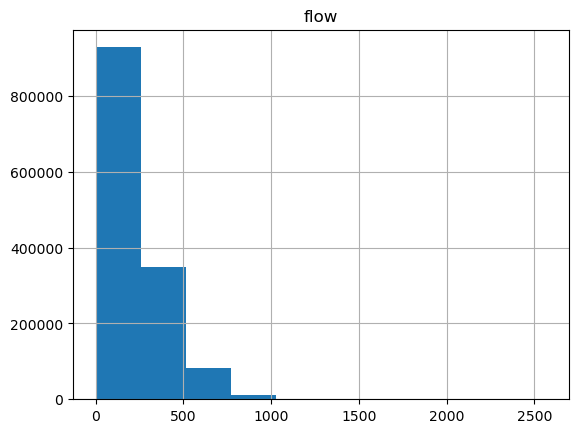

In [42]:
ax1=count_data.hist(column=["flow"])

# 3. Read in the city road network (geographically embedded graph model) from disk
## First, use "Download_OSM.ipynb" to download, simplify and save the city network
Boeing, G. 2017. "OSMnx: New Methods for Acquiring, Constructing, Analyzing, and Visualizing Complex Street Networks." Computers, Environment and Urban Systems 65, 126-139. doi:10.1016/j.compenvurbsys.2017.05.004<br>

In [43]:
import os
path = os.path.join(data_dir,"OSM")
print(path)

../UTD2019/OSM


### Uncomment to download the graph from OSM, otherwise load from local directory
- This should be coded with error handling:
- look for city graph file on local dir
- if not found, look up city in table and get corresponding OSM PLACE_NAME
- download OSM graph

In [44]:
import osmnx
#city = "melbourne"

## Make a lookup table for all 40 cities for OSM with PLACE_NAME and city
#PLACE_NAME = "melbourne, England" # 47 sec to download from osm

In [45]:
graph=osmnx.io.load_graphml(filepath=os.path.join(path,city,city+".graphml"))

## Extract the nodes and edges to pandas GeoDataFrame

In [46]:
nodes, edges = osmnx.graph_to_gdfs(graph)

In [47]:
nodes.head()

,y,x,highway,street_count,geometry
osmid,,,,,
26034662,-37.809868,144.966684,traffic_signals,4,POINT (144.96668 -37.80987)
26034663,-37.809157,144.969118,traffic_signals,4,POINT (144.96912 -37.80916)
26034664,-37.808418,144.971613,NaN,4,POINT (144.97161 -37.80842)
26034668,-37.809342,144.972047,NaN,4,POINT (144.97205 -37.80934)
26034669,-37.810808,144.967111,NaN,4,POINT (144.96711 -37.81081)


In [48]:
nodes.index

Int64Index([  26034662,   26034663,   26034664,   26034668,   26034669,
              26034670,   26034671,   26034672,   26034673,   26051948,
            ...
            9512482857, 9756035286, 9756035287, 9756035309, 9756035310,
            9756035315, 9756035316, 9756035317, 9756035318, 9991984390],
           dtype='int64', name='osmid', length=211)

In [49]:
edges.head()

osmid  oneway  \
u        v          key                                              
26034662 1985557963 0                            323916048   False   
         2181268836 0                            187918254    True   
26034663 589403294  0                            323916050    True   
26034668 26034664   0                            198005395    True   
         277089929  0    [958571816, 958571818, 387266131]    True   

                                           name        highway maxspeed  \
u        v          key                                                   
26034662 1985557963 0    Little Lonsdale Street  living_street       20   
         2181268836 0            Russell Street       tertiary       40   
26034663 589403294  0    Little Lonsdale Street  living_street       20   
26034668 26034664   0             Spring Street   unclassified      NaN   
         277089929  0           Lonsdale Street       tertiary       40   

                         reversed   length  \
u        v          key                      
26034662 1985557963 0       False   13.469   
         2181268836 0       False  111.036   
26034663 589403294  0       False   16.263   
26034668 26034664   0       False  109.550   
         277089929  0       False   13.127   

                                                                  geometry  \
u        v          key                                                      
26034662 1985557963 0    LINESTRING (144.96668 -37.80987, 144.96683 -37...   
         2181268836 0    LINESTRING (144.96668 -37.80987, 144.96667 -37...   
26034663 589403294  0    LINESTRING (144.96912 -37.80916, 144.96929 -37...   
26034668 26034664   0    LINESTRING (144.97205 -37.80934, 144.97203 -37...   
         277089929  0    LINESTRING (144.97205 -37.80934, 144.97207 -37...   

                        lanes  ref bridge access width tunnel  
u        v          key                                        
26034662 1985557963 0     NaN  NaN    NaN    NaN   NaN    NaN  
         2181268836 0     NaN  NaN    NaN    NaN   NaN    NaN  
26034663 589403294  0     NaN  NaN    NaN    NaN   NaN    NaN  
26034668 26034664   0       2  NaN    NaN    NaN   NaN    NaN  
         277089929  0       2  NaN    NaN    NaN   NaN    NaN

In [50]:
edges.index

MultiIndex([(  26034662, 1985557963, 0),
            (  26034662, 2181268836, 0),
            (  26034663,  589403294, 0),
            (  26034668,   26034664, 0),
            (  26034668,  277089929, 0),
            (  26034669, 1985557923, 0),
            (  26034669, 6207070037, 0),
            (  26034670,  589402311, 0),
            (  26034670, 6775859250, 0),
            (  26034671,  588876889, 0),
            ...
            (9756035310, 9756035309, 0),
            (9756035315, 9756035316, 0),
            (9756035315, 4544002874, 0),
            (9756035316, 9756035315, 0),
            (9756035316, 4544002877, 0),
            (9756035317, 9756035318, 0),
            (9756035317, 1985557927, 0),
            (9756035318, 9756035317, 0),
            (9756035318, 6696274752, 0),
            (9991984390,  317537930, 0)],
           names=['u', 'v', 'key'], length=377)

In [51]:
list(edges)

['osmid',
 'oneway',
 'name',
 'highway',
 'maxspeed',
 'reversed',
 'length',
 'geometry',
 'lanes',
 'ref',
 'bridge',
 'access',
 'width',
 'tunnel']

In [52]:
edges["highway"].value_counts()

tertiary          206
living_street      51
tertiary_link      47
unclassified       46
secondary          25
primary             1
secondary_link      1
Name: highway, dtype: int64

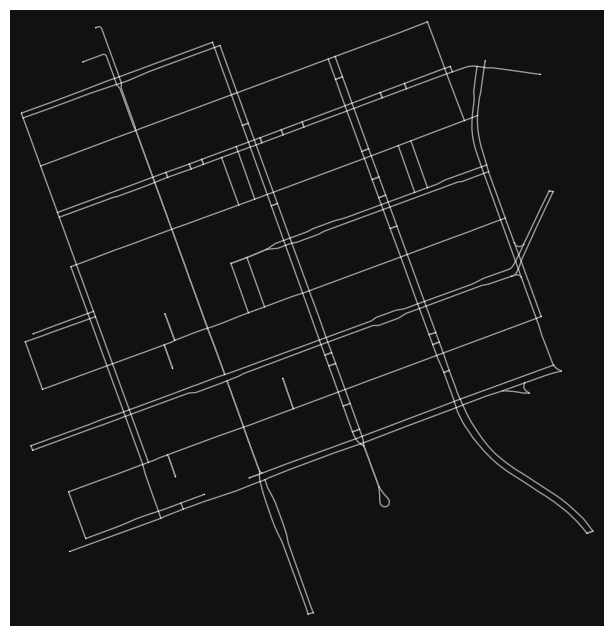

In [53]:
figure, ax = osmnx.plot_graph(graph,node_size=1)

In [54]:
# gt_intersections, gt_lines = osmnx.graph_to_gdfs(graph)
# for geodataframes. This structure enables treating individual components of the graph separately
# https://geographicdata.science/book/notebooks/03_spatial_data.html

## Make a geodataframe for the detectors
- Prepares the detectors to be matched to edges on the graph by distance
- Subset the detectors dataframe for the city
- Remove the detectors with missing data

In [55]:
graph.graph["crs"]

'epsg:4326'

In [56]:
gdf_detectors=geopandas.GeoDataFrame(city_detectors_data, geometry=geopandas.points_from_xy(city_detectors_data.long, city_detectors_data.lat),crs=graph.graph["crs"])

In [57]:
#gdf_detectors.rename(columns={"long":"x", "lat":"y"}, inplace = True)

In [58]:
gdf_detectors.head()

,detid,length,pos,fclass,road,limit,citycode,lanes,linkid,long,lat,geometry
13574,K4476.D1,0.086145,0.020738,tertiary,Bourke Street,NaN,melbourne,1,862,144.948762,-37.818452,POINT (144.94876 -37.81845)
13575,K4576.D5,0.113111,0.019706,tertiary,Exhibition Street,40,melbourne,1,343,144.971430,-37.813794,POINT (144.97143 -37.81379)
13576,K4576.D6,0.116698,0.020620,tertiary,Exhibition Street,40,melbourne,1,344,144.971401,-37.813805,POINT (144.97140 -37.81380)
13577,K4576.D10,0.212780,0.015236,tertiary,Collins Street,40,melbourne,1,345,144.971175,-37.814092,POINT (144.97117 -37.81409)
13578,K4576.D2,0.223094,0.023529,tertiary,Collins Street,40,melbourne,1,342,144.971878,-37.813996,POINT (144.97188 -37.81400)


## Overplot detector location on the map of the city graph to see where the sensors are
- for non-warped plot make sure both geodataframes and osmnx have "CRS" projection functions

In [59]:
pad=0.001
minx=gdf_detectors["long"].min()-pad
maxx=gdf_detectors["long"].max()+pad
miny=gdf_detectors["lat"].min()-pad
maxy=gdf_detectors["lat"].max()+pad

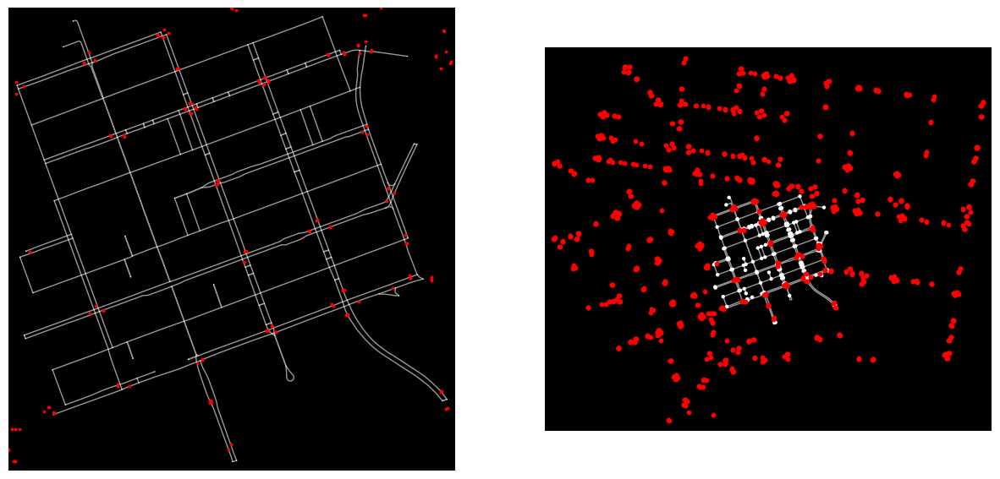

In [60]:
figure, ax = plt.subplots(1,2, figsize=(15,15))

#G=osmnx.project_graph(graph, to_crs=4326)
osmnx.plot_graph(graph,ax=ax[0],show=False, node_size=1)
#osmnx.plot_graph(G,ax=ax[0],show=False, node_size=1)
#GDF=osmnx.project_gdf(gdf_detectors,to_crs=4326)
gdf_detectors.plot(ax=ax[0], color="red", markersize=3 )
#GDF.plot(ax=ax[0], color="red", markersize=3 )
ax[0].set_facecolor("black")

osmnx.plot_graph(graph,ax=ax[1],show=False, node_size=10)
gdf_detectors.plot(ax=ax[1], color="red", markersize=10 )
ax[1].set_xlim(xmin=minx, xmax=maxx)
ax[1].set_ylim(ymin=miny, ymax=maxy)
ax[1].set_facecolor("black")
#plt.savefig(data_dir+"/OSM/"+city+"/counters_extent.png")
plt.show()
plt.close()

### How many sensors vs. how many nodes?
- Makes little sense because all the sensors are still here and the road graph has been cropped

In [61]:
# Number of nodes in the zoomed section of the graph around the detectors
sum(((nodes["y"]>miny) & (nodes["y"]<maxy)) & ((nodes["x"]>minx) & (nodes["x"]<maxx)))
#sum(((edges["y"]>miny) & (edges["y"]<maxy)) & ((edges["x"]>minx) & (edges["x"]<maxx)))
#df.query("miny< y < maxy")

211

In [62]:
# Number of detectors
print(gdf_detectors["long"].size)

954


## Define a copy of the city graph and clip out a subgraph coinciding with the Long/Lat box containing the detectors
- osmnx.truncate.truncate_graph.b_box

In [63]:
#cropped_graph=osmnx.graph_from_bbox(miny, maxy, minx, maxx, network_type="drive")
cropped_graph = osmnx.truncate.truncate_graph_bbox(graph, maxy, miny, maxx, minx, truncate_by_edge=True)

In [64]:
cropped_graph.graph["crs"]

'epsg:4326'

In [65]:
figure, ax = osmnx.plot_graph(cropped_graph,show=False, node_size=10, figsize=(10,10))
gdf_detectors.plot(ax=ax, color="red", markersize=30 )
#plt.savefig(data_dir+"/OSM/"+city+"/initial_network_with_counters.png")
plt.close()

In [66]:
n, e = osmnx.graph_to_gdfs(cropped_graph)

In [67]:
e.head()

osmid  oneway  \
u        v          key                                              
26034662 1985557963 0                            323916048   False   
         2181268836 0                            187918254    True   
26034663 589403294  0                            323916050    True   
26034668 26034664   0                            198005395    True   
         277089929  0    [958571816, 958571818, 387266131]    True   

                                           name        highway maxspeed  \
u        v          key                                                   
26034662 1985557963 0    Little Lonsdale Street  living_street       20   
         2181268836 0            Russell Street       tertiary       40   
26034663 589403294  0    Little Lonsdale Street  living_street       20   
26034668 26034664   0             Spring Street   unclassified      NaN   
         277089929  0           Lonsdale Street       tertiary       40   

                         reversed   length  \
u        v          key                      
26034662 1985557963 0       False   13.469   
         2181268836 0       False  111.036   
26034663 589403294  0       False   16.263   
26034668 26034664   0       False  109.550   
         277089929  0       False   13.127   

                                                                  geometry  \
u        v          key                                                      
26034662 1985557963 0    LINESTRING (144.96668 -37.80987, 144.96683 -37...   
         2181268836 0    LINESTRING (144.96668 -37.80987, 144.96667 -37...   
26034663 589403294  0    LINESTRING (144.96912 -37.80916, 144.96929 -37...   
26034668 26034664   0    LINESTRING (144.97205 -37.80934, 144.97203 -37...   
         277089929  0    LINESTRING (144.97205 -37.80934, 144.97207 -37...   

                        lanes  ref bridge access width tunnel  
u        v          key                                        
26034662 1985557963 0     NaN  NaN    NaN    NaN   NaN    NaN  
         2181268836 0     NaN  NaN    NaN    NaN   NaN    NaN  
26034663 589403294  0     NaN  NaN    NaN    NaN   NaN    NaN  
26034668 26034664   0       2  NaN    NaN    NaN   NaN    NaN  
         277089929  0       2  NaN    NaN    NaN   NaN    NaN

### The road types in the graph: no pedestrian zones, bicycle paths, etc.

In [68]:
e["highway"].value_counts()

tertiary          206
living_street      51
tertiary_link      47
unclassified       46
secondary          25
primary             1
secondary_link      1
Name: highway, dtype: int64

In [69]:
n.head()

,y,x,highway,street_count,geometry
osmid,,,,,
26034662,-37.809868,144.966684,traffic_signals,4,POINT (144.96668 -37.80987)
26034663,-37.809157,144.969118,traffic_signals,4,POINT (144.96912 -37.80916)
26034664,-37.808418,144.971613,NaN,4,POINT (144.97161 -37.80842)
26034668,-37.809342,144.972047,NaN,4,POINT (144.97205 -37.80934)
26034669,-37.810808,144.967111,NaN,4,POINT (144.96711 -37.81081)


# Assign a linkid in the road network to each detector in city_detectors_data DataFrame
### Some counters are clearly outside the road network and too far from edges
- Either the wrong lat/lon or they measure something else or they measure from a distance
- Using only the graph and the detector location we have no way of allocating these to an edge
### Threshold on distance to remove these detectors from the model
### In order to not lose the 1:1 correspondence between edge assignment and detector, do this thresholding after combining matched edges to detectors df

In [70]:
# Find the distance to the nearest edges from a point X,Y
# This is placing two detectors on the same edge sometimes
# I think these detectors should be in opposite lanes
# interpolate=None (0.5 sec), 1e-6 (56 sec), 1e-7 (cancelled after 7 mins)

det_uvk_list, dist=osmnx.distance.nearest_edges(cropped_graph, city_detectors_data["long"].tolist(), city_detectors_data["lat"].tolist(), interpolate=None, return_dist=True)

In [71]:
# Edges are labelled by u (source node), v (desintation node) and k (key)
print(det_uvk_list)

[(2180785582, 2180785617, 0), (589402289, 2180614756, 0), (589402289, 2180614756, 0), (9086096518, 2180614754, 0), (1449431554, 2180614752, 0), (1449431554, 2180614752, 0), (9086096518, 2180614754, 0), (8633729231, 9086096516, 0), (8633729231, 9086096516, 0), (1985557931, 9086096518, 0), (1985557931, 9086096518, 0), (2187874241, 2190478928, 0), (2190478930, 2190478924, 0), (2187874241, 2190478928, 0), (2190478932, 2180785617, 0), (2180785582, 2180785617, 0), (2180785582, 2180785617, 0), (2180785582, 2180785617, 0), (2180785582, 2180785617, 0), (2180785582, 2180785617, 0), (2180785582, 2180785617, 0), (2180785582, 2180785617, 0), (2180785582, 2180785617, 0), (2180785582, 2180785617, 0), (2180785582, 2180785617, 0), (2180785582, 2180785617, 0), (2180785582, 2180785617, 0), (2180785582, 2180785617, 0), (266739054, 576876287, 0), (266739054, 576876287, 0), (266739054, 576876287, 0), (266739054, 576876287, 0), (266739054, 576876287, 0), (266739054, 576876287, 0), (266739054, 576876287, 0), 

### Plot the distances between detectors and edges

In [72]:
plt.hist(dist, bins=100)
plt.title("Matched distance from detectors to edges, lat/lon units")
plt.close()

## See if there is one detector per edge, >1 detector per edge, or >1 edge per detector

In [73]:
#det_uvk_list=matched_edges[0] # list of (u,v,key) for each edge that was matched to a detector, length = number of detectors
# If this is NOT 1:1 and the same u,v,key matches more than one detector, then there has been a mistake and a detector has been assigned to the wrong traffic direction
# In fact, we are not guaranteed to have matched ANY detector to the correct direction simply by a distance match
# We need to check them all for direction (later)
res = list(set([ele for ele in det_uvk_list if det_uvk_list.count(ele) > 1]))
 
# printing result
print("The following tuples (u,v,key) are duplicates in the list : " + str(res))
print("If there are duplicate edge entries then there are > 1 detector matched to an edge")

The following tuples (u,v,key) are duplicates in the list : [(6207245783, 589472358, 0), (2181268830, 1985557963, 0), (26034668, 26034664, 0), (2383211191, 2181275340, 0), (26034673, 595594352, 0), (1985557938, 576877847, 0), (6207022860, 595594347, 0), (9756035309, 9086096512, 0), (2190483594, 9086096511, 0), (8873674098, 1449431465, 0), (9512482852, 9105320429, 0), (266739054, 576876287, 0), (589472357, 9991984390, 0), (2187770692, 2190483583, 0), (846547014, 846547082, 0), (2187770699, 2383211191, 0), (2190483597, 2190483594, 0), (2190478936, 2177124606, 0), (145261423, 2177124606, 0), (767587073, 589472358, 0), (1985557963, 26034663, 0), (589403294, 26034664, 0), (2181268836, 2181268832, 0), (252588303, 1449431504, 0), (2180785582, 2180785617, 0), (1449431504, 1449431544, 0), (2187983891, 2187983881, 0), (7388026644, 1833110301, 0), (9086096518, 2180614754, 0), (2187983885, 2187983882, 0), (8633729236, 1985557938, 0), (1449431630, 741702104, 0), (741702228, 591294679, 0), (74170222

In [74]:
for j in res:
    indices = [i for i, x in enumerate(det_uvk_list) if x == j]
    for ind in indices:
     print(city_detectors_data["detid"].tolist()[ind], j)

K4455.D8 (6207245783, 589472358, 0)
K4455.D10 (6207245783, 589472358, 0)
K4455.D11 (6207245783, 589472358, 0)
K4455.D7 (6207245783, 589472358, 0)
K4455.D5 (6207245783, 589472358, 0)
K4455.D6 (6207245783, 589472358, 0)
K4455.D3 (6207245783, 589472358, 0)
K4455.D9 (6207245783, 589472358, 0)
K4455.D4 (6207245783, 589472358, 0)
K3382.D2 (6207245783, 589472358, 0)
K3382.D7 (6207245783, 589472358, 0)
K3382.D6 (6207245783, 589472358, 0)
K3382.D1 (6207245783, 589472358, 0)
K3382.D17 (6207245783, 589472358, 0)
K3382.D18 (6207245783, 589472358, 0)
K3375.D1 (6207245783, 589472358, 0)
K3375.D2 (6207245783, 589472358, 0)
K3375.D3 (6207245783, 589472358, 0)
K3375.D4 (6207245783, 589472358, 0)
K4441.D11 (6207245783, 589472358, 0)
K4441.D6 (6207245783, 589472358, 0)
K4441.D9 (6207245783, 589472358, 0)
K4441.D7 (6207245783, 589472358, 0)
K4444.D8 (6207245783, 589472358, 0)
K4444.D7 (6207245783, 589472358, 0)
K4148.D2 (6207245783, 589472358, 0)
K4148.D1 (6207245783, 589472358, 0)
K3373.D2 (6207245783, 5

## This means the detectors for opposing or parallel lanes have been associated with the same lane

- The following will ensure that each detector is assigned to the edge that is going the correct direction
- This will eliminate most of the cases where more than one detector is assigned to an edge
- Find the compass bearing of the matched edge and the linkid-order=1 of the detector.
- If the matched edge aligns in the same quadrant as the linkid-order=1 of link_data then the edge is matched correctly
- Else swap u and v of the matched edge

In [75]:
# Make a new dataframe for aligning the detectors with the correct lane direction
detector_graph_map=city_detectors_data.copy()

In [76]:
len(detector_graph_map)

954

In [77]:
# Extract the edge u and v (point labels) from the tuple list into their own lists
edgev_match=[]
edgeu_match=[]
edge_dist=[]
for i in range(len(det_uvk_list)):
    edgeu_match.append(det_uvk_list[i][0])
    edgev_match.append(det_uvk_list[i][1])
    edge_dist.append(dist[i])

In [78]:
# Add the u and v of each edge that is associated with a detector to the detector dataframe
detector_graph_map["edgeu_match"]=edgeu_match
detector_graph_map["edgev_match"]=edgev_match
detector_graph_map["dist"]=edge_dist

### Remove detectors that are too far from road network

In [79]:
detector_graph_map=detector_graph_map[detector_graph_map.dist<0.0002]

In [80]:
len(detector_graph_map)

110

### Put the new list of detectors (with lat/lon and edge match) into a geodataframe for plotting

<Axes: >

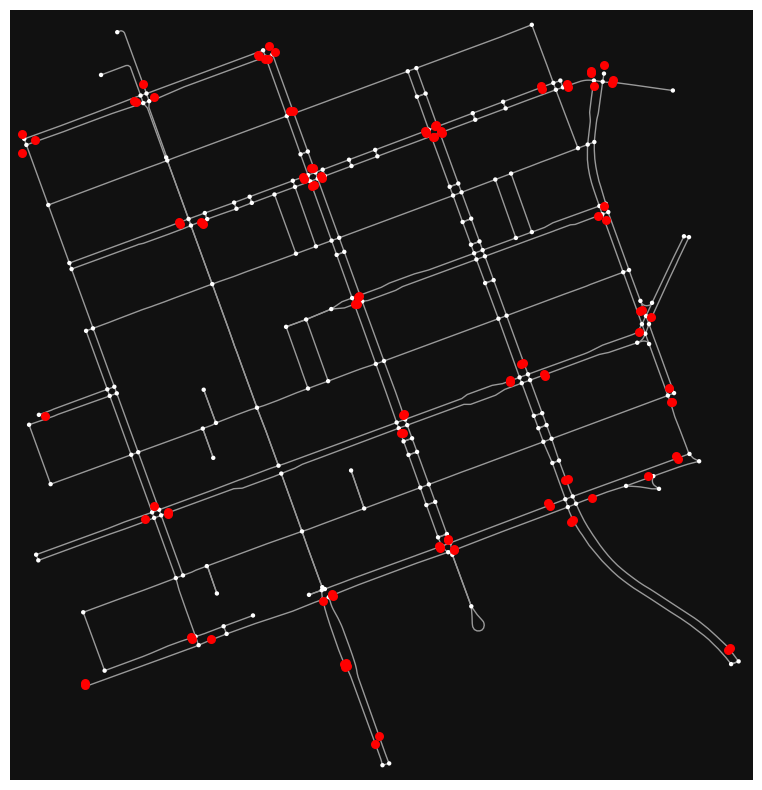

In [81]:
gdf_detector_graph_map=geopandas.GeoDataFrame(detector_graph_map, geometry=geopandas.points_from_xy(detector_graph_map.long, detector_graph_map.lat),crs=graph.graph["crs"])
figure, ax = osmnx.plot_graph(cropped_graph,show=False, node_size=10, figsize=(10,10))
gdf_detector_graph_map.plot(ax=ax, color="red", markersize=30 )

### We are assigning the detectors to links in the linkid file to determine the direction of the lane in which the detector lies
### If the linkid of a detector is not in the linkid file, this code will crash
### Since we don't otherwise know for sure which link the detector might be on
### we will drop any detector from the df which does not have a linkid in the UTD19 dataset

In [82]:
city_link_data=link_data[link_data.citycode==city]

In [83]:
detector_graph_map = detector_graph_map[detector_graph_map.linkid.isin(city_link_data.linkid) == True]

In [84]:
len(detector_graph_map)

110

In [85]:
#for each detector id in city detector df
# Get (long,lat) from order = 1 row for detector id in the links dataframe from UTD19
#
# This is the origin of the flow on the link
# 
# Get (long, lat) from order[-1] of last waypoint as destination of flow
#
s=detector_graph_map["linkid"]
linkx1=[]
linky1=[]
linkxn=[]
linkyn=[]
for i in s:
    
    # This is the origin of the flow on the link
    #if(i in link_data.loc[link_data["linkid"]]):
        linkx1.append(link_data.loc[(link_data["linkid"]==i) & (link_data["order"]==1) & (link_data["citycode"]==city)]["long"].values[0]) # x of first waypoint
        linky1.append(link_data.loc[(link_data["linkid"]==i) & (link_data["order"]==1) & (link_data["citycode"]==city)]["lat"].values[0])# y of first waypoint
        linkxn.append(link_data.loc[(link_data["linkid"]==i) & (link_data["citycode"]==city)].values[-1][0])# x of last waypoint
        linkyn.append(link_data.loc[(link_data["linkid"]==i) & (link_data["citycode"]==city)].values[-1][1])# y of last waypoint
        # Add the x and y of the link's root node (u) to the dataframe of the detectors    
detector_graph_map["linkx1"]=linkx1
detector_graph_map["linky1"]=linky1
detector_graph_map["linkxn"]=linkxn
detector_graph_map["linkyn"]=linkyn
    #else:
     #   detector=list(detector_graph_map[detector_graph_map["linkid"] == i]["detid"])[0]
     #   #df.loc[df['column_name'] == some_value]
     #   print(f"linkid {i} is not in link file. Detector {detector} will be dropped from the dataframe")
     #   detector_graph_map.loc[detector_graph_map["linkid"] == i].drop(,inplace=True)
     #   df = df[df.line_race != 0]



In [86]:
detector_graph_map.head()

,detid,length,pos,fclass,road,limit,citycode,lanes,linkid,long,lat,edgeu_match,edgev_match,dist,linkx1,linky1,linkxn,linkyn
13575,K4576.D5,0.113111,0.019706,tertiary,Exhibition Street,40,melbourne,1,343,144.971430,-37.813794,589402289,2180614756,0.000022,144.971091,-37.812997,144.971508,-37.813961
13576,K4576.D6,0.116698,0.020620,tertiary,Exhibition Street,40,melbourne,1,344,144.971401,-37.813805,589402289,2180614756,0.000053,144.971026,-37.812992,144.971482,-37.813979
13577,K4576.D10,0.212780,0.015236,tertiary,Collins Street,40,melbourne,1,345,144.971175,-37.814092,9086096518,2180614754,0.000014,144.969066,-37.814699,144.971339,-37.814049
13578,K4576.D2,0.223094,0.023529,tertiary,Collins Street,40,melbourne,1,342,144.971878,-37.813996,1449431554,2180614752,0.000018,144.973904,-37.813263,144.971624,-37.814063
13579,K4576.D3,0.217624,0.022012,tertiary,Collins Street,40,melbourne,1,341,144.971860,-37.813961,1449431554,2180614752,0.000021,144.973871,-37.813260,144.971628,-37.814035


In [87]:
# Need to compare the linkx1, linky1 to x,y of u on the matched edge and x,y of v on the matched edge
# So get the x,y of the edge endpoints from the n (nodes) dataframe
# Use the edgeu and edgev point name/number and match it to
# the osmid of n. The osmid of the node is in the index of geodataframe n
edgexu_match=[]
edgeyu_match=[]
edgexv_match=[]
edgeyv_match=[]

s=detector_graph_map["edgeu_match"]
for i in s:
    # This is the origin of the flow on the link
    edgexu_match.append(n.loc[(n.index==i)]["x"].values[0])
    edgeyu_match.append(n.loc[(n.index==i)]["y"].values[0])
    
s=detector_graph_map["edgev_match"]
for i in s:
    edgexv_match.append(n.loc[(n.index==i)]["x"].values[0])
    edgeyv_match.append(n.loc[(n.index==i)]["y"].values[0])

detector_graph_map["edgexu_match"]=edgexu_match
detector_graph_map["edgeyu_match"]=edgeyu_match
detector_graph_map["edgexv_match"]=edgexv_match
detector_graph_map["edgeyv_match"]=edgeyv_match


In [88]:
detector_graph_map.columns.values

array(['detid', 'length', 'pos', 'fclass', 'road', 'limit', 'citycode',
       'lanes', 'linkid', 'long', 'lat', 'edgeu_match', 'edgev_match',
       'dist', 'linkx1', 'linky1', 'linkxn', 'linkyn', 'edgexu_match',
       'edgeyu_match', 'edgexv_match', 'edgeyv_match'], dtype=object)

In [89]:
detector_graph_map.head()

,detid,length,pos,fclass,road,limit,citycode,lanes,linkid,long,...,edgev_match,dist,linkx1,linky1,linkxn,linkyn,edgexu_match,edgeyu_match,edgexv_match,edgeyv_match
13575,K4576.D5,0.113111,0.019706,tertiary,Exhibition Street,40,melbourne,1,343,144.971430,...,2180614756,0.000022,144.971091,-37.812997,144.971508,-37.813961,144.971106,-37.813041,144.971537,-37.813973
13576,K4576.D6,0.116698,0.020620,tertiary,Exhibition Street,40,melbourne,1,344,144.971401,...,2180614756,0.000053,144.971026,-37.812992,144.971482,-37.813979,144.971106,-37.813041,144.971537,-37.813973
13577,K4576.D10,0.212780,0.015236,tertiary,Collins Street,40,melbourne,1,345,144.971175,...,2180614754,0.000014,144.969066,-37.814699,144.971339,-37.814049,144.969065,-37.814690,144.971368,-37.814022
13578,K4576.D2,0.223094,0.023529,tertiary,Collins Street,40,melbourne,1,342,144.971878,...,2180614752,0.000018,144.973904,-37.813263,144.971624,-37.814063,144.973734,-37.813471,144.971579,-37.814066
13579,K4576.D3,0.217624,0.022012,tertiary,Collins Street,40,melbourne,1,341,144.971860,...,2180614752,0.000021,144.973871,-37.813260,144.971628,-37.814035,144.973734,-37.813471,144.971579,-37.814066


In [90]:
detector_graph_map["edgexu_match"].iloc[0]

144.9711064

## Here match the bearing of the matched edge to the bearing of the linkid in link_data

In [91]:
# Compare bearings of link (UTD19) and edge (osmnx match)
# Initialize the edge u and v equal to the matched ones
edgexu=detector_graph_map["edgexu_match"].tolist()
edgeyu=detector_graph_map["edgeyu_match"].tolist()
edgexv=detector_graph_map["edgexu_match"].tolist()
edgeyv=detector_graph_map["edgeyv_match"].tolist()
edgeu=detector_graph_map["edgeu_match"].tolist()
edgev=detector_graph_map["edgev_match"].tolist()


# Swap u and v if the link dataset from UTD19 is aligned 180 to this
for i in range(0,len(linkx1)):
    bearing_link=osmnx.bearing.calculate_bearing(linkx1[i],linky1[i],linkxn[i],linkyn[i])
    bearing_edge=osmnx.bearing.calculate_bearing(detector_graph_map["edgexu_match"].iloc[i],detector_graph_map["edgeyu_match"].iloc[i],detector_graph_map["edgexv_match"].iloc[i],detector_graph_map["edgeyv_match"].iloc[i])
    if(np.abs(bearing_link - bearing_edge)>90.):
        print(f"flipping edge, {i}, blink, {bearing_link}, bedge, {bearing_edge}")
        print(edgeu[i],edgev[i])
        edgeu[i]=detector_graph_map["edgev_match"].iloc[i]
        edgev[i]=detector_graph_map["edgeu_match"].iloc[i]
        edgexu[i]=detector_graph_map["edgexv_match"].iloc[i]
        edgeyu[i]=detector_graph_map["edgeyv_match"].iloc[i]
        edgexv[i]=detector_graph_map["edgexu_match"].iloc[i]
        edgeyv[i]=detector_graph_map["edgeyu_match"].iloc[i]
        #print(f"flipping edge, {i}, blink, {bearing_link}, bedge, {bearing_edge}")
detector_graph_map["edgeu"]=edgeu
detector_graph_map["edgev"]=edgev
detector_graph_map["edgexu"]=edgexu_match
detector_graph_map["edgeyu"]=edgeyu_match
detector_graph_map["edgexv"]=edgexu_match
detector_graph_map["edgeyv"]=edgeyv_match
 

flipping edge, 13, blink, 347.585116450739, bedge, 166.6543300687305
2190478932 2180785617
flipping edge, 17, blink, 61.83002488141235, bedge, 240.86307559527984
1449431476 2279153639
flipping edge, 28, blink, 60.19584463962448, bedge, 346.3145503205392
26034670 589402311
flipping edge, 42, blink, 351.591020327535, bedge, 171.9291816346005
589472357 9991984390
flipping edge, 44, blink, 352.3278798478308, bedge, 171.9291816346005
589472357 9991984390
flipping edge, 50, blink, 87.23516690108112, bedge, 347.382400481132
2189497200 2189497232
flipping edge, 51, blink, 347.8633907478478, bedge, 166.95149677078257
2189497210 2187983890
flipping edge, 52, blink, 60.62805451798604, bedge, 346.64748483718716
2187983891 2187983881
flipping edge, 54, blink, 61.602311246070485, bedge, 346.64748483718716
2187983891 2187983881
flipping edge, 70, blink, 346.8856878863601, bedge, 166.9680678789085
2187770692 2190483583
flipping edge, 89, blink, 61.328067987420496, bedge, 166.62080330547263
1985557963 

In [92]:
detector_graph_map.head

<bound method NDFrame.head of            detid    length       pos    fclass               road limit  \
13575   K4576.D5  0.113111  0.019706  tertiary  Exhibition Street    40   
13576   K4576.D6  0.116698  0.020620  tertiary  Exhibition Street    40   
13577  K4576.D10  0.212780  0.015236  tertiary     Collins Street    40   
13578   K4576.D2  0.223094  0.023529  tertiary     Collins Street    40   
13579   K4576.D3  0.217624  0.022012  tertiary     Collins Street    40   
...          ...       ...       ...       ...                ...   ...   
14438   K4531.D5  0.152890  0.006151  tertiary     Princes Bridge   NaN   
14465   K4530.D3  0.136550  0.010706  tertiary    Swanston Street   NaN   
14466   K4530.D4  0.134868  0.010963  tertiary    Swanston Street   NaN   
14467   K4530.D2  0.134868  0.005586  tertiary    Swanston Street   NaN   
14468   K4530.D1  0.136550  0.005349  tertiary    Swanston Street   NaN   

        citycode  lanes  linkid        long  ...  edgexu_match  edgey

In [93]:
# Clean up the dataframe
detector_graph_map=detector_graph_map.drop(["edgeu_match", "edgev_match", "linkx1", "linky1", "linkxn", "linkyn","edgexu_match","edgeyu_match","edgexv_match","edgeyv_match"],axis=1)

In [94]:
# Display all rows of the dataframe for troubleshooting
#pd.set_option('display.max_rows', None)
#display(detector_graph_map)

## Making a dict of edge (u,v,k) and detid allows setting detid as an attribute on the graph
## This may be useful or not
## A dict in this direction means there must be a 1:1 relationship between edge <--> detid
## Or else a detector will go "missing"
## Examine once again if there are still multiple detectors per edge
## Before zipping them into the following dict

In [95]:
len(detector_graph_map["detid"])

110

In [96]:
# The key of each edge is set to 0 in the osmnx package.
uvkeys=np.zeros(len(detector_graph_map["detid"])).astype(int)
uv_tuples=list(zip(detector_graph_map["edgeu"].tolist(),detector_graph_map["edgev"].tolist(),uvkeys))

In [97]:
len(uv_tuples)

110

In [98]:
# See if the tuple "edgeu, edgev", the matched edges after correcting for the direction of traffic, is repeated
res2 = list(set([ele for ele in uv_tuples if uv_tuples.count(ele) > 1]))
 
# printing result
print("The following tuples (u,v,key) are duplicates in the list : " + str(res2))
print("If there are duplicate edge entries then there are > 1 detector matched to an edge")

The following tuples (u,v,key) are duplicates in the list : [(6207245783, 589472358, 0), (26034673, 595594352, 0), (2187983881, 2187983891, 0), (1985557938, 576877847, 0), (6207022860, 595594347, 0), (9756035309, 9086096512, 0), (2190483594, 9086096511, 0), (9512482852, 9105320429, 0), (589472357, 9991984390, 0), (252588303, 1449431504, 0), (1449431504, 1449431544, 0), (7388026644, 1833110301, 0), (9086096518, 2180614754, 0), (2187983885, 2187983882, 0), (8633729236, 1985557938, 0), (741702228, 591294679, 0), (741702223, 266739054, 0), (2187874241, 2190478928, 0), (9991984390, 589472357, 0), (663497749, 252588303, 0), (1449431554, 2180614752, 0), (576877857, 9512482841, 0), (576876287, 576877857, 0), (589402289, 2180614756, 0), (8633729231, 9086096516, 0), (1833110282, 2165149751, 0), (26034662, 2181268836, 0), (6381474060, 26034670, 0), (6207022859, 26034668, 0), (1985557931, 9086096518, 0), (4544002874, 26034669, 0), (846547014, 598154601, 0), (6207070036, 1985557923, 0), (9756035317

In [99]:
for j in res2:
    indices = [i for i, x in enumerate(uv_tuples) if x == j]
    for ind in indices:
     print(city_detectors_data["detid"].iloc[ind], j)

K4455.D4 (6207245783, 589472358, 0)
K4457.D4 (6207245783, 589472358, 0)
K4453.D4 (26034673, 595594352, 0)
K4455.D10 (26034673, 595594352, 0)
K4404.D5 (2187983881, 2187983891, 0)
K4404.D8 (2187983881, 2187983891, 0)
K4404.D16 (1985557938, 576877847, 0)
K4405.D2 (1985557938, 576877847, 0)
K4584.D10 (6207022860, 595594347, 0)
K4451.D2 (6207022860, 595594347, 0)
K4451.D6 (6207022860, 595594347, 0)
K1052.D4 (9756035309, 9086096512, 0)
K1052.D1 (9756035309, 9086096512, 0)
K1052.D5 (2190483594, 9086096511, 0)
K1052.D7 (2190483594, 9086096511, 0)
K4405.D9 (9512482852, 9105320429, 0)
K4405.D6 (9512482852, 9105320429, 0)
K4583.D4 (589472357, 9991984390, 0)
K4583.D2 (589472357, 9991984390, 0)
K4575.D9 (252588303, 1449431504, 0)
K4575.D2 (252588303, 1449431504, 0)
K4453.D1 (1449431504, 1449431544, 0)
K4453.D2 (1449431504, 1449431544, 0)
K4370.D1 (7388026644, 1833110301, 0)
K4370.D3 (7388026644, 1833110301, 0)
K4370.D12 (7388026644, 1833110301, 0)
K4576.D6 (9086096518, 2180614754, 0)
K4576.D3 (9086

# Final set of detectors and road network
- The useful counters (correctly georeferenced to graph edges)
    - The validity of the counts from the detectors will be checked later
- The graph of a manageable size (number of nodes/edges/routes)

In [100]:
gdf_detector_graph_map=geopandas.GeoDataFrame(detector_graph_map, geometry=geopandas.points_from_xy(detector_graph_map.long, detector_graph_map.lat),crs=graph.graph["crs"])

In [101]:
figure, ax = osmnx.plot_graph(cropped_graph,show=False, node_size=10, figsize=(10,10))
gdf_detector_graph_map.plot(ax=ax, color="red", markersize=30 )
#plt.savefig(data_dir+"/OSM/"+city+"/final_network_with_counters.png")
plt.close()

In [102]:
len(gdf_detector_graph_map)

110

## In real traffic networks, there is sometimes more than one detector per graph edge.
- Serve to measure road speed and congestion along the road link
- For the purposes of generating an OD matrix, only the volumes are necessary
- And only one detector need be kept per edge
- The "zip" command to make a dict of {(u,v,k): detid} will take only one.
- For the purposes of estimating the total counts on an edge, check if the detectors are measuring multiple lanes
- If so, assign the one with more lanes to the edge.

In [103]:
edge_detector_dict=dict(zip(uv_tuples, detector_graph_map["detid"].tolist()))

In [104]:
len(edge_detector_dict)

68

In [105]:
edge_detector_dict

{(589402289, 2180614756, 0): 'K4576.D6',
 (9086096518, 2180614754, 0): 'K4576.D9',
 (1449431554, 2180614752, 0): 'K4576.D3',
 (8633729231, 9086096516, 0): 'K4577.D2',
 (1985557931, 9086096518, 0): 'K4577.D3',
 (2187874241, 2190478928, 0): 'K4580.D6',
 (2190478930, 2190478924, 0): 'K4580.D3',
 (2180785617, 2190478932, 0): 'K4580.D7',
 (2180614756, 1449431476, 0): 'K4575.D9',
 (6167357881, 1449431467, 0): 'K4575.D2',
 (8873674098, 1449431465, 0): 'K4575.D7',
 (2279153639, 1449431476, 0): 'K4575.D5',
 (589472357, 9991984390, 0): 'K2901.D6',
 (6207022859, 26034668, 0): 'K2901.D10',
 (6381474060, 26034670, 0): 'K2902.D10',
 (6207022860, 595594347, 0): 'K2902.D8',
 (6775859251, 589402311, 0): 'K2902.D5',
 (6381564384, 595594348, 0): 'K2902.D2',
 (589402311, 26034670, 0): 'K2902.D6',
 (595594347, 595594348, 0): 'K2902.D3',
 (1449431465, 1449431464, 0): 'K2024.D3',
 (1449431504, 1449431544, 0): 'K2024.D2',
 (26034673, 595594352, 0): 'K2903.D3',
 (4544002874, 26034669, 0): 'K2903.D13',
 (975603

In [106]:
cropped_graph.edges()

OutMultiEdgeDataView([(26034662, 1985557963), (26034662, 2181268836), (26034663, 589403294), (26034668, 26034664), (26034668, 277089929), (26034669, 1985557923), (26034669, 6207070037), (26034670, 589402311), (26034670, 6775859250), (26034671, 588876889), (26034671, 317537930), (26034672, 1985557912), (26034672, 6381564384), (26034673, 595594352), (26034673, 245532558), (26051948, 6775862780), (26051948, 1985557921), (26051949, 130015095), (26051949, 8633729233), (26051950, 1985557931), (26051950, 6775862757), (26051952, 176722502), (26051952, 2187983882), (114607245, 114607252), (114607245, 2190478940), (114607252, 114607245), (130015095, 1838361782), (130015095, 130015096), (130015096, 130015095), (145261423, 2177124606), (174792823, 174792857), (174792823, 174812829), (174792857, 174792823), (174812829, 174812848), (174812829, 2190478930), (174812848, 174812829), (176721271, 2187874242), (176721271, 176721287), (176721287, 2188404539), (176722502, 176721271), (176722502, 2188404539)

## Set detector ID in the edge attributes. The documentation says "G,name,values" but the function needs "G,values,name" !

In [107]:
# set_edge_attributes(graph,name, values ) # values (u,v,key) dict or list
import networkx as nx
nx.set_edge_attributes(cropped_graph, edge_detector_dict, "detid")
#osmnx.set_edge_attributes(cropped_graph, edge_detector_dict, "detid")

In [108]:
cropped_graph.edges()

OutMultiEdgeDataView([(26034662, 1985557963), (26034662, 2181268836), (26034663, 589403294), (26034668, 26034664), (26034668, 277089929), (26034669, 1985557923), (26034669, 6207070037), (26034670, 589402311), (26034670, 6775859250), (26034671, 588876889), (26034671, 317537930), (26034672, 1985557912), (26034672, 6381564384), (26034673, 595594352), (26034673, 245532558), (26051948, 6775862780), (26051948, 1985557921), (26051949, 130015095), (26051949, 8633729233), (26051950, 1985557931), (26051950, 6775862757), (26051952, 176722502), (26051952, 2187983882), (114607245, 114607252), (114607245, 2190478940), (114607252, 114607245), (130015095, 1838361782), (130015095, 130015096), (130015096, 130015095), (145261423, 2177124606), (174792823, 174792857), (174792823, 174812829), (174792857, 174792823), (174812829, 174812848), (174812829, 2190478930), (174812848, 174812829), (176721271, 2187874242), (176721271, 176721287), (176721287, 2188404539), (176722502, 176721271), (176722502, 2188404539)

In [109]:
nx.get_edge_attributes(cropped_graph, "detid")

{(26034662, 1985557963, 0): 'K2912.D3',
 (26034662, 2181268836, 0): 'K2920.D3',
 (26034673, 595594352, 0): 'K2903.D3',
 (252588303, 1449431504, 0): 'K2932.D4',
 (576876287, 576877857, 0): 'K4560.D2',
 (576877857, 9512482841, 0): 'K4561.D1',
 (589402289, 2180614756, 0): 'K4576.D6',
 (589472357, 9991984390, 0): 'K2901.D6',
 (591294679, 846547082, 0): 'K4531.D5',
 (595594347, 595594348, 0): 'K2902.D3',
 (663497749, 252588303, 0): 'K4560.D5',
 (741702052, 741702223, 0): 'K4560.D7',
 (741702104, 741702052, 0): 'K2931.D1',
 (741702223, 266739054, 0): 'K4528.D6',
 (741702228, 591294679, 0): 'K4562.D8',
 (767587073, 589472358, 0): 'K4444.D4',
 (846547014, 598154601, 0): 'K4530.D1',
 (1449431465, 1449431464, 0): 'K2024.D3',
 (1449431504, 1449431544, 0): 'K2024.D2',
 (1449431554, 2180614752, 0): 'K4576.D3',
 (1833110282, 2165149751, 0): 'K4563.D6',
 (1985557931, 9086096518, 0): 'K4577.D3',
 (1985557938, 576877847, 0): 'K4560.D10',
 (2180614756, 1449431476, 0): 'K4575.D9',
 (2181268830, 198555796

### Err "CRS" not found when read in again and nodes, edges extracted

In [110]:
#osmnx.io.save_graphml(cropped_graph,filepath=os.path.join(path,city,city+"01.graphml"),gephi=True,encoding="utf-8")

# Continue here with the cropped graph and its attributes

#### Add speed/travel time
- https://github.com/gboeing/osmnx-examples/blob/main/notebooks/02-routing-speed-time.ipynb

In [111]:
# impute speed on all edges missing data
cropped_graph = osmnx.add_edge_speeds(cropped_graph)

In [112]:
# calculate travel time (seconds) for all edges
cropped_graph = osmnx.add_edge_travel_times(cropped_graph)

In [113]:
# see mean speed/time values by road type
weighted_edges = osmnx.graph_to_gdfs(cropped_graph, nodes=False)
#edges,nodes=osmnx.graph_to_gdfs(cropped_graph)
weighted_edges["highway"] = weighted_edges["highway"].astype(str)
weighted_edges.groupby("highway")[["length","speed_kph", "travel_time"]].mean().round(1)

,length,speed_kph,travel_time
highway,,,
living_street,92.8,18.9,18.0
primary,12.2,34.1,1.3
secondary,112.8,40.4,9.9
secondary_link,14.4,34.1,1.5
tertiary,68.6,40.7,6.0
tertiary_link,14.4,40.0,1.3
unclassified,78.0,30.6,9.4


In [114]:
weighted_edges.head()

osmid  oneway  \
u        v          key                                              
26034662 1985557963 0                            323916048   False   
         2181268836 0                            187918254    True   
26034663 589403294  0                            323916050    True   
26034668 26034664   0                            198005395    True   
         277089929  0    [958571816, 958571818, 387266131]    True   

                                           name        highway maxspeed  \
u        v          key                                                   
26034662 1985557963 0    Little Lonsdale Street  living_street       20   
         2181268836 0            Russell Street       tertiary       40   
26034663 589403294  0    Little Lonsdale Street  living_street       20   
26034668 26034664   0             Spring Street   unclassified      NaN   
         277089929  0           Lonsdale Street       tertiary       40   

                         reversed   length     detid  speed_kph  travel_time  \
u        v          key                                                        
26034662 1985557963 0       False   13.469  K2912.D3       20.0          2.4   
         2181268836 0       False  111.036  K2920.D3       40.0         10.0   
26034663 589403294  0       False   16.263       NaN       20.0          2.9   
26034668 26034664   0       False  109.550       NaN       30.6         12.9   
         277089929  0       False   13.127       NaN       40.0          1.2   

                                                                  geometry  \
u        v          key                                                      
26034662 1985557963 0    LINESTRING (144.96668 -37.80987, 144.96683 -37...   
         2181268836 0    LINESTRING (144.96668 -37.80987, 144.96667 -37...   
26034663 589403294  0    LINESTRING (144.96912 -37.80916, 144.96929 -37...   
26034668 26034664   0    LINESTRING (144.97205 -37.80934, 144.97203 -37...   
         277089929  0    LINESTRING (144.97205 -37.80934, 144.97207 -37...   

                        lanes  ref bridge access width tunnel  
u        v          key                                        
26034662 1985557963 0     NaN  NaN    NaN    NaN   NaN    NaN  
         2181268836 0     NaN  NaN    NaN    NaN   NaN    NaN  
26034663 589403294  0     NaN  NaN    NaN    NaN   NaN    NaN  
26034668 26034664   0       2  NaN    NaN    NaN   NaN    NaN  
         277089929  0       2  NaN    NaN    NaN   NaN    NaN

In [115]:
# calculate two routes by minimizing travel distance vs travel time
orig = list(cropped_graph)[1]
dest = list(cropped_graph)[192]
route1 = osmnx.shortest_path(cropped_graph, orig, dest, weight="length")
route2 = osmnx.shortest_path(cropped_graph, orig, dest, weight="travel_time")

In [116]:
# gives key error even thought key is in dict (data frame)
#print(cropped_graph[203478][203493]['travel_time'])

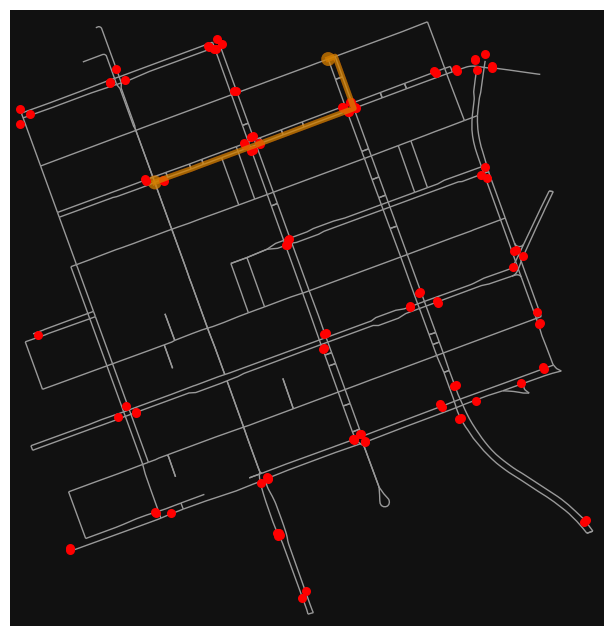

In [117]:
# plot the routes
#fig, ax = osmnx.plot_graph_routes(cropped_graph, routes=[route1, route2], route_colors=["r", "y"], route_linewidth=6, node_size=0)
fig, ax = osmnx.plot_graph_routes(cropped_graph,routes=[route1, route2], route_colors=["r", "y"], route_linewidth=6, node_size=0, close=False,show=False)
gdf_detector_graph_map.plot(ax=ax,color="red", markersize=30)
plt.show()
plt.close()

### nx k shortest paths between O,D
- In one example (melbourne cropped from 1 to 99) nx found different fastest route than osmnx

In [118]:
from itertools import islice

def k_shortest_paths(G, source, target, k, weight=None):

    return list(

        islice(nx.shortest_simple_paths(G, source, target, weight=weight), k)

    )
paths=[]
for path in k_shortest_paths(nx.DiGraph(cropped_graph), orig, dest, 4, weight="travel time"):

    #print(path)
    paths.append(path)

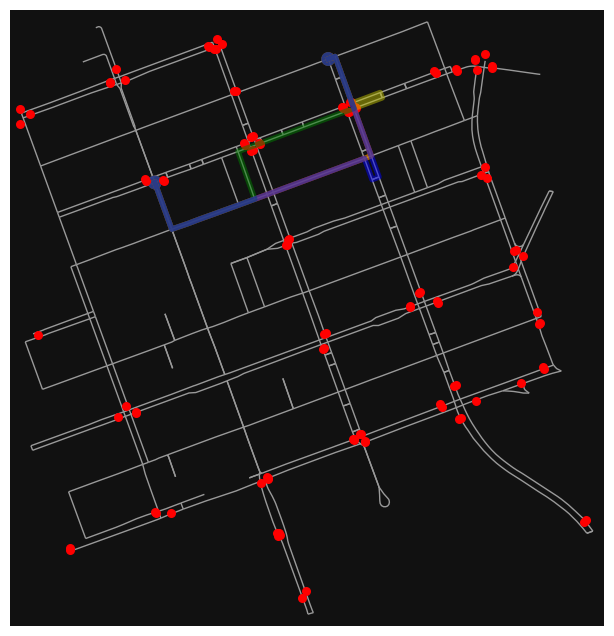

In [119]:
# plot the routes
fig, ax = osmnx.plot_graph_routes(
    cropped_graph, routes=paths, route_colors=["r", "y","g","b"], route_linewidth=6, node_size=0,close=False,show=False)
gdf_detector_graph_map.plot(ax=ax,color="red", markersize=30)
#plt.savefig(data_dir+"/OSM/"+city+"/_k_routes_example.png")
plt.show()
plt.close()

In [120]:
#_,nodes = osmnx.graph_to_gdfs(cropped_graph)
# This gives u, [1] gives v
weighted_edges.index[100][0]

767587073

# Make the objects that are needed for the calculation of OD flow

- nodes from n.index
- edges from e or edges (speeds and tt here)
- edges_uv from edges.index
- G from cropped_graph
- edge_weights from G edge "travel time"
- nodes_xy from n
- countkeys edges with counts from edge_detector_dict.keys()
- counts from countkeys and count_data



In [121]:
# Using map() and lambda
def listOfTuples(l1, l2):
    return list(map(lambda x, y:(x,y), l1, l2))


In [122]:
# node names
nodes = n.index
# edge names
edges=list(cropped_graph.edges(data=False))
# edges_uv
edge_uv=list(cropped_graph.edges(data=False))
# edge_weights
edge_weights=[]
for next in list(cropped_graph.edges(data="travel_time")):
    edge_weights.append(next[-1])
# nodes_xy
# Driver Code
list1 = n["x"]
list2 = n["y"]
node_xy=(listOfTuples(list1, list2))

# The graph needs u,v,k in edge key. The code I wrote for the toy model just u,v

In [123]:
edge_weights_dict=dict(zip(edge_uv,edge_weights))
edge_weights_dict_for_graph=dict(zip(weighted_edges.index, weighted_edges["travel_time"]))
edge_labels_dict=dict(zip(edges,edge_uv))
node_xy_dict = dict(zip(nodes,node_xy))

In [124]:
edge_weights_dict

{(26034662, 1985557963): 2.4,
 (26034662, 2181268836): 10.0,
 (26034663, 589403294): 2.9,
 (26034668, 26034664): 12.9,
 (26034668, 277089929): 1.2,
 (26034669, 1985557923): 1.3,
 (26034669, 6207070037): 3.5,
 (26034670, 589402311): 1.5,
 (26034670, 6775859250): 5.6,
 (26034671, 588876889): 22.8,
 (26034671, 317537930): 13.0,
 (26034672, 1985557912): 38.6,
 (26034672, 6381564384): 1.5,
 (26034673, 595594352): 10.0,
 (26034673, 245532558): 5.3,
 (26051948, 6775862780): 2.3,
 (26051948, 1985557921): 38.9,
 (26051949, 130015095): 19.0,
 (26051949, 8633729233): 5.5,
 (26051950, 1985557931): 38.8,
 (26051950, 6775862757): 6.0,
 (26051952, 176722502): 16.1,
 (26051952, 2187983882): 10.1,
 (114607245, 114607252): 9.8,
 (114607245, 2190478940): 8.1,
 (114607252, 114607245): 9.8,
 (130015095, 1838361782): 21.1,
 (130015095, 130015096): 8.4,
 (130015096, 130015095): 8.4,
 (145261423, 2177124606): 40.2,
 (174792823, 174792857): 22.5,
 (174792823, 174812829): 4.6,
 (174792857, 174792823): 22.5,
 (1

In [125]:
n.head()

,y,x,highway,street_count,geometry
osmid,,,,,
26034662,-37.809868,144.966684,traffic_signals,4,POINT (144.96668 -37.80987)
26034663,-37.809157,144.969118,traffic_signals,4,POINT (144.96912 -37.80916)
26034664,-37.808418,144.971613,NaN,4,POINT (144.97161 -37.80842)
26034668,-37.809342,144.972047,NaN,4,POINT (144.97205 -37.80934)
26034669,-37.810808,144.967111,NaN,4,POINT (144.96711 -37.81081)


In [126]:
G=cropped_graph
nx.set_node_attributes(G,node_xy_dict,name="pos")
nx.set_edge_attributes(G,edge_weights_dict_for_graph,name="weight")

In [127]:
#print(nx.get_node_attributes(G,"pos"))

In [128]:
#print(nx.get_edge_attributes(G,"travel_time"))

### See this link for total route travel time and also for plottign heatmaps of road speed (change to OD and route flow)
- https://max-coding.medium.com/osmnx-part-1-loading-data-from-open-street-maps-and-finding-shortest-route-between-two-points-5bb073b0a27d

In [129]:
edge_travel_time = osmnx.utils_graph.get_route_edge_attributes(
    G, route1, 'travel_time') 
route_travel_time = sum(edge_travel_time)
print("Travel time route 1 in minutes:", route_travel_time/60)

Travel time route 1 in minutes: 0.9349999999999999


# $Y_i$

### Remove the dropped detectors from the counts_data dataframe

In [130]:
print(len(edge_detector_dict))

68


In [131]:
keeplist=list(edge_detector_dict.values())
print(keeplist)

['K4576.D6', 'K4576.D9', 'K4576.D3', 'K4577.D2', 'K4577.D3', 'K4580.D6', 'K4580.D3', 'K4580.D7', 'K4575.D9', 'K4575.D2', 'K4575.D7', 'K4575.D5', 'K2901.D6', 'K2901.D10', 'K2902.D10', 'K2902.D8', 'K2902.D5', 'K2902.D2', 'K2902.D6', 'K2902.D3', 'K2024.D3', 'K2024.D2', 'K2903.D3', 'K2903.D13', 'K2903.D11', 'K2903.D7', 'K4444.D11', 'K4444.D7', 'K4444.D4', 'K4444.D1', 'K4593.D4', 'K4593.D2', 'K4593.D6', 'K4595.D4', 'K4595.D1', 'K4598.D2', 'K4560.D2', 'K4560.D5', 'K4560.D10', 'K4560.D7', 'K4563.D6', 'K4563.D4', 'K4564.D2', 'K2921.D6', 'K2921.D7', 'K2921.D4', 'K2921.D3', 'K4561.D1', 'K4561.D3', 'K4561.D10', 'K4562.D8', 'K4530.D1', 'K2904.D6', 'K2904.D10', 'K2912.D2', 'K2912.D3', 'K2920.D8', 'K2920.D7', 'K2920.D3', 'K2920.D9', 'K2920.D4', 'K2922.D1', 'K2922.D4', 'K2922.D6', 'K2931.D1', 'K2932.D4', 'K4528.D6', 'K4531.D5']


In [132]:
print(keeplist[19],sorted(keeplist)[19])

K2902.D3 K2920.D4


In [133]:
count_data.detid.nunique()

954

In [134]:
cropped_count_data=count_data[count_data.detid.isin(keeplist)]

In [135]:
cropped_count_data.detid.nunique()

68

In [136]:
len(cropped_count_data.day)

97021

In [137]:
cropped_count_data['day'] = cropped_count_data['day'].astype(str)
cropped_count_data['interval'] = cropped_count_data['interval'].astype(int)
cropped_count_data['flow'] = cropped_count_data['flow'].astype(float)
cropped_count_data['detid'] = cropped_count_data['detid'].astype(str)
cropped_count_data['time'] = pd.to_datetime(cropped_count_data['day']).values.astype(np.int64) // 10 ** 9 + cropped_count_data['interval']

C:\Users\jkhac\AppData\Local\Temp\ipykernel_9916\1870342441.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cropped_count_data['day'] = cropped_count_data['day'].astype(str)
C:\Users\jkhac\AppData\Local\Temp\ipykernel_9916\1870342441.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cropped_count_data['interval'] = cropped_count_data['interval'].astype(int)
C:\Users\jkhac\AppData\Local\Temp\ipykernel_9916\1870342441.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a

In [138]:
cropped_count_data.head()

,day,interval,detid,flow,occ,error,city,speed,time
4536,2018-02-12,0,K2024.D2,204.0,NaN,NaN,melbourne,NaN,1518393600
4537,2018-02-12,900,K2024.D2,124.0,NaN,NaN,melbourne,NaN,1518394500
4538,2018-02-12,1800,K2024.D2,84.0,NaN,NaN,melbourne,NaN,1518395400
4539,2018-02-12,2700,K2024.D2,80.0,NaN,NaN,melbourne,NaN,1518396300
4540,2018-02-12,3600,K2024.D2,84.0,NaN,NaN,melbourne,NaN,1518397200


In [139]:
print(f'The detectors have data from {min(cropped_count_data["day"])} until {max(cropped_count_data["day"])}')

The detectors have data from 2018-02-12 until 2018-02-26


In [140]:
counts=cropped_count_data.pivot(index="detid", columns="time", values="flow").values

In [141]:
print(counts.shape,type(counts))

(68, 1440) <class 'numpy.ndarray'>


### Pivoting the flows into a matrix of time versus detid causes nan
- There are no nan's in flow
- But some detid's don't have observations in some time slots
- They are forced to have SOME entry in the pivot table (matrix) and this is set to nan

In [142]:
print(np.count_nonzero(np.isnan(counts)), np.count_nonzero(~np.isnan(counts)))

899 97021


In [143]:
np.argwhere(np.isnan(counts))

array([[   0,  315],
       [   0,  319],
       [   0,  935],
       [   0, 1311],
       [   1,  123],
       [   1,  267],
       [   1,  315],
       [   1,  319],
       [   1,  447],
       [   1,  935],
       [   1, 1311],
       [  12,  367],
       [  12,  368],
       [  12,  369],
       [  12,  370],
       [  12,  371],
       [  12,  372],
       [  12,  373],
       [  12,  374],
       [  12,  375],
       [  12,  376],
       [  12,  377],
       [  12,  378],
       [  12,  379],
       [  12,  380],
       [  12,  381],
       [  12,  382],
       [  12,  383],
       [  12,  384],
       [  13,  363],
       [  13,  364],
       [  13,  365],
       [  13,  366],
       [  13,  367],
       [  13,  368],
       [  13,  369],
       [  13,  370],
       [  13,  371],
       [  13,  372],
       [  13,  373],
       [  13,  374],
       [  13,  375],
       [  13,  376],
       [  13,  377],
       [  13,  378],
       [  13,  379],
       [  13,  380],
       [  13,

### Row 19 has almost no valid measurements across time slices: drop this detector
- The 19th row of the pivot table has nan's
- The 19th row is index 19 and corresponds to a detector id in the index list
- The order of the rows, thus their indices, may not correspond anymore to the order of the det_id in the dataframe
- pandas alphabetizes the values in the index used to make the pivot table
- Luckily the unique listing of the detector id's is also sorted

In [144]:
# Row 19 detector has nearly all missing data: drop
print(cropped_count_data["detid"].unique()[19])
id=cropped_count_data["detid"].unique()[19]

K2920.D4


In [145]:
cropped_count_data["detid"].unique() == sorted(cropped_count_data["detid"].unique())

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True])

# Remake the I x Nt counts matrix with cleaned data
### NOTE in the pivot table the detectors and the time slices are sorted alphabetically

In [146]:
edge_detector_dict=dict(zip(uv_tuples, detector_graph_map["detid"].tolist()))
value_drop=cropped_count_data["detid"].unique()[19]
key_drop=(list(edge_detector_dict.keys())[list(edge_detector_dict.values()).index(id)]) 
del edge_detector_dict[key_drop]
keeplist=list(edge_detector_dict.values())
cropped_count_data=count_data[count_data.detid.isin(keeplist)]
cropped_count_data['day'] = cropped_count_data['day'].astype(str)
cropped_count_data['interval'] = cropped_count_data['interval'].astype(int)
cropped_count_data['flow'] = cropped_count_data['flow'].astype(float)
cropped_count_data['detid'] = cropped_count_data['detid'].astype(str)
cropped_count_data['time'] = pd.to_datetime(cropped_count_data['day']).values.astype(np.int64) // 10 ** 9 + cropped_count_data['interval']
counts=cropped_count_data.pivot(index="detid", columns="time", values="flow").values

C:\Users\jkhac\AppData\Local\Temp\ipykernel_9916\2255438571.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cropped_count_data['day'] = cropped_count_data['day'].astype(str)
C:\Users\jkhac\AppData\Local\Temp\ipykernel_9916\2255438571.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cropped_count_data['interval'] = cropped_count_data['interval'].astype(int)
C:\Users\jkhac\AppData\Local\Temp\ipykernel_9916\2255438571.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a

In [147]:
np.argwhere(np.isnan(counts))

array([[   0,  315],
       [   0,  319],
       [   0,  935],
       [   0, 1311],
       [   1,  123],
       [   1,  267],
       [   1,  315],
       [   1,  319],
       [   1,  447],
       [   1,  935],
       [   1, 1311],
       [  12,  367],
       [  12,  368],
       [  12,  369],
       [  12,  370],
       [  12,  371],
       [  12,  372],
       [  12,  373],
       [  12,  374],
       [  12,  375],
       [  12,  376],
       [  12,  377],
       [  12,  378],
       [  12,  379],
       [  12,  380],
       [  12,  381],
       [  12,  382],
       [  12,  383],
       [  12,  384],
       [  13,  363],
       [  13,  364],
       [  13,  365],
       [  13,  366],
       [  13,  367],
       [  13,  368],
       [  13,  369],
       [  13,  370],
       [  13,  371],
       [  13,  372],
       [  13,  373],
       [  13,  374],
       [  13,  375],
       [  13,  376],
       [  13,  377],
       [  13,  378],
       [  13,  379],
       [  13,  380],
       [  13,

### Not many nan's still need to treat them: remove detector, remove time slices, interpolate values

In [148]:
print(np.count_nonzero(np.isnan(counts)), np.count_nonzero(~np.isnan(counts)))

211 96269


### Get column indices containing nan's

In [149]:
s=np.argwhere(np.isnan(counts)).flatten()
col_ind=[]
for i in range(0,len(s),2):
    col_ind.append(s[i])
col_ind=np.array(col_ind)
col_ind=np.unique(col_ind)
print(col_ind)

[ 0  1 12 13 14 15 16 17 18 23 24 30 31 32 33 34 35 47 57]


### On detector less

In [150]:
counts.shape

(67, 1440)

In [151]:
interp_counts=pd.DataFrame(counts.T)
interp_counts.head()

,0,1,2,3,4,5,6,7,8,9,...,57,58,59,60,61,62,63,64,65,66
0,204.0,48.0,4.0,52.0,0.0,148.0,124.0,160.0,148.0,0.0,...,80.0,140.0,100.0,128.0,144.0,60.0,92.0,140.0,44.0,44.0
1,124.0,40.0,4.0,48.0,0.0,136.0,80.0,112.0,132.0,0.0,...,48.0,164.0,64.0,132.0,136.0,56.0,80.0,104.0,20.0,40.0
2,84.0,36.0,8.0,52.0,0.0,96.0,80.0,92.0,140.0,0.0,...,32.0,152.0,64.0,112.0,92.0,60.0,72.0,116.0,32.0,52.0
3,80.0,44.0,4.0,16.0,0.0,88.0,80.0,68.0,140.0,0.0,...,32.0,148.0,116.0,92.0,88.0,60.0,72.0,92.0,28.0,28.0
4,84.0,16.0,8.0,28.0,4.0,64.0,76.0,92.0,136.0,0.0,...,24.0,116.0,64.0,100.0,72.0,44.0,80.0,108.0,20.0,40.0


In [152]:
with pd.option_context('display.max_rows', None, 'display.max_columns', None):  # more options can be specified also
    print(interp_counts[47])

0       208.0
1       140.0
2       148.0
3       124.0
4       180.0
5       128.0
6        68.0
7       140.0
8       128.0
9        84.0
10      100.0
11       96.0
12      100.0
13      112.0
14      116.0
15      112.0
16       96.0
17       76.0
18      104.0
19      104.0
20      128.0
21      100.0
22      128.0
23      176.0
24      204.0
25      240.0
26      316.0
27      256.0
28      376.0
29      444.0
30      416.0
31      488.0
32      464.0
33      500.0
34      440.0
35      444.0
36      436.0
37      452.0
38      404.0
39      432.0
40      416.0
41      460.0
42      360.0
43      448.0
44      444.0
45      448.0
46      476.0
47      468.0
48      408.0
49      396.0
50      408.0
51      424.0
52      416.0
53      392.0
54      428.0
55      408.0
56      452.0
57      432.0
58      384.0
59      384.0
60      340.0
61      352.0
62      436.0
63      380.0
64      360.0
65      368.0
66      348.0
67      384.0
68      400.0
69      360.0
70      172.0
71    

In [153]:
means=interp_counts.mean(axis=0)
print(means[47])

279.34075104311546


In [154]:
#interp_counts.interpolate(method='pad', axis=1, inplace=True, columns=list(col_ind))
interp_counts.fillna(means,axis=0,inplace=True)

In [155]:
with pd.option_context('display.max_rows', None, 'display.max_columns', None):  # more options can be specified also
    print(interp_counts[47])

0       208.000000
1       140.000000
2       148.000000
3       124.000000
4       180.000000
5       128.000000
6        68.000000
7       140.000000
8       128.000000
9        84.000000
10      100.000000
11       96.000000
12      100.000000
13      112.000000
14      116.000000
15      112.000000
16       96.000000
17       76.000000
18      104.000000
19      104.000000
20      128.000000
21      100.000000
22      128.000000
23      176.000000
24      204.000000
25      240.000000
26      316.000000
27      256.000000
28      376.000000
29      444.000000
30      416.000000
31      488.000000
32      464.000000
33      500.000000
34      440.000000
35      444.000000
36      436.000000
37      452.000000
38      404.000000
39      432.000000
40      416.000000
41      460.000000
42      360.000000
43      448.000000
44      444.000000
45      448.000000
46      476.000000
47      468.000000
48      408.000000
49      396.000000
50      408.000000
51      424.000000
52      416.

In [156]:
list(pd.Series.sort_values(city_detectors_data["detid"]))[23]

'K1052.D4'

In [157]:
dename=list(pd.Series.sort_values(city_detectors_data["detid"]))[23]
plt.plot(range(0,1440),interp_counts[23])
plt.title("Melbourne Sensor "+dename+" with interpolated counts")
#plt.savefig(data_dir+"/OSM/"+city+"/interpolated_counts.png")
plt.close()

# Make the final counts matrix with cleaned up values
### Make associated indices for the pivot rows and columns

In [158]:
counts=(np.array(interp_counts).T)
counts_detectors=list(pd.Series.sort_values(city_detectors_data["detid"]))
counts_time=list(pd.Series.sort_values(cropped_count_data["time"]).unique())
print(counts.shape)
print(counts_detectors)
print(counts_time)

(67, 1440)
['K1036.D1', 'K1036.D3', 'K1036.D4', 'K1037.D1', 'K1037.D2', 'K1037.D3', 'K1038.D1', 'K1038.D2', 'K1038.D3', 'K1038.D4', 'K1038.D5', 'K1038.D6', 'K1039.D1', 'K1039.D2', 'K1039.D3', 'K1039.D4', 'K1039.D6', 'K1045.D5', 'K1051.D1', 'K1051.D4', 'K1051.D5', 'K1052.D1', 'K1052.D2', 'K1052.D4', 'K1052.D5', 'K1052.D7', 'K1052.D9', 'K1057.D1', 'K1057.D3', 'K1057.D6', 'K1057.D8', 'K1059.D2', 'K1061.D12', 'K1061.D2', 'K1061.D3', 'K1061.D4', 'K1061.D5', 'K1061.D7', 'K1061.D8', 'K1061.D9', 'K1065.D2', 'K1065.D3', 'K1065.D4', 'K1066.D1', 'K1066.D3', 'K1066.D4', 'K1066.D5', 'K2024.D1', 'K2024.D2', 'K2024.D3', 'K2901.D10', 'K2901.D6', 'K2901.D7', 'K2901.D9', 'K2902.D10', 'K2902.D11', 'K2902.D12', 'K2902.D2', 'K2902.D3', 'K2902.D5', 'K2902.D6', 'K2902.D7', 'K2902.D8', 'K2902.D9', 'K2903.D10', 'K2903.D11', 'K2903.D13', 'K2903.D14', 'K2903.D2', 'K2903.D3', 'K2903.D6', 'K2903.D7', 'K2904.D10', 'K2904.D6', 'K2904.D7', 'K2904.D9', 'K2907.D11', 'K2907.D12', 'K2907.D2', 'K2907.D3', 'K2907.D4', 'K29

### The countkeys are the (u,v) of each edge which has counts available

In [159]:
countkeys=list(edge_detector_dict.keys())
counts_dict=dict(zip(countkeys,counts[:,:]))
print(countkeys)

[(589402289, 2180614756, 0), (9086096518, 2180614754, 0), (1449431554, 2180614752, 0), (8633729231, 9086096516, 0), (1985557931, 9086096518, 0), (2187874241, 2190478928, 0), (2190478930, 2190478924, 0), (2180785617, 2190478932, 0), (2180614756, 1449431476, 0), (6167357881, 1449431467, 0), (8873674098, 1449431465, 0), (2279153639, 1449431476, 0), (589472357, 9991984390, 0), (6207022859, 26034668, 0), (6381474060, 26034670, 0), (6207022860, 595594347, 0), (6775859251, 589402311, 0), (6381564384, 595594348, 0), (589402311, 26034670, 0), (595594347, 595594348, 0), (1449431465, 1449431464, 0), (1449431504, 1449431544, 0), (26034673, 595594352, 0), (4544002874, 26034669, 0), (9756035317, 1985557927, 0), (6207070036, 1985557923, 0), (9991984390, 589472357, 0), (6207245783, 589472358, 0), (767587073, 589472358, 0), (2189497243, 589472357, 0), (2279153639, 2189497210, 0), (2189497232, 2189497200, 0), (2187983890, 2189497210, 0), (2187983881, 2187983891, 0), (2187983885, 2187983882, 0), (2190478

In [160]:
counts_dict

{(589402289,
  2180614756,
  0): array([204.        , 124.        ,  84.        ,  80.        ,
         84.        ,  80.        ,  64.        ,  80.        ,
         36.        ,  48.        ,  52.        ,  52.        ,
         36.        ,  60.        ,  40.        ,  44.        ,
         36.        ,  52.        ,  56.        ,  76.        ,
         76.        , 100.        , 112.        , 148.        ,
        188.        , 292.        , 324.        , 284.        ,
        432.        , 484.        , 392.        , 580.        ,
        564.        , 580.        , 580.        , 468.        ,
        552.        , 516.        , 444.        , 508.        ,
        472.        , 472.        , 412.        , 468.        ,
        360.        , 384.        , 436.        , 452.        ,
        476.        , 460.        , 476.        , 496.        ,
        484.        , 436.        , 472.        , 476.        ,
        356.        , 468.        , 448.        , 412.        ,
        

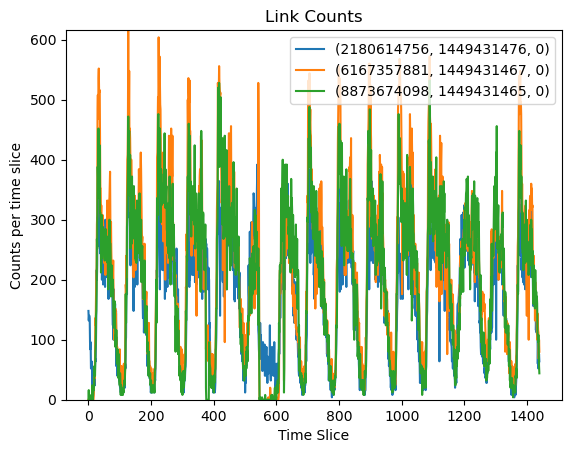

In [161]:
import matplotlib.pyplot as plt
x=list(range(0,counts.shape[1]))
ymax=0
for ii in range(8,11):#range(counts.shape[0]):
    y=counts[ii,:]
    y[np.where(np.isnan(y))]=0
    if(ymax < np.max(y)):
        ymax=np.max(y)
    plt.plot(x,counts[ii,:],label=str(list(counts_dict.keys())[ii]))
plt.ylim(0,ymax)
plt.xlabel("Time Slice")
plt.ylabel("Counts per time slice")
plt.legend()
plt.title("Link Counts")
#plt.savefig(data_dir+"/OSM/"+city+"/sample_counts_all.png")
plt.show()
plt.close()

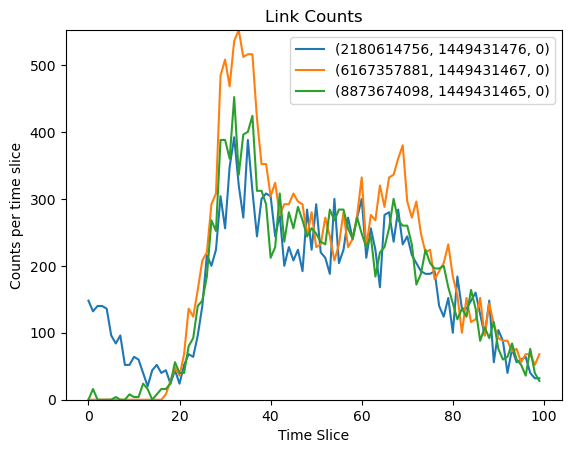

In [162]:
import matplotlib.pyplot as plt
x=range(0,100)
ymax=0
for ii in range(8,11):#range(counts.shape[0]):
    y=counts[ii,0:100]
    y[np.where(np.isnan(y))]=0
    if(ymax < np.max(y)):
        ymax=np.max(y)
    plt.plot(x,counts[ii,0:100],label=str(list(counts_dict.keys())[ii]))
plt.ylim(0,ymax)
plt.xlabel("Time Slice")
plt.ylabel("Counts per time slice")
plt.legend()
plt.title("Link Counts")
#plt.savefig(data_dir+"/OSM/"+city+"/sample_counts_day.png")
plt.show()
plt.close()

# Routes between O's and D's.
- one list of routes as edge sequences
- one list of routes as node sequences
- note that a dict of OD_pairs to routes must accomodate several routes per OD_pair later on
    - the "zip" can be replaced by an iterator over OD_Pairs, add a list of routes to the OD_Pair key

# $O, D$

In [163]:
len(nodes)

211

## In order to keep the size of the calculation manageable
## do not use all the nodes as origins and destinations
### Choosing only nodes of degree 1 (dead ends) and 2 (corners/dead ends) makes an interesting and manageable model

In [164]:
degs = [lis[1] for lis in list(G.degree())]
ns = [lis[0] for lis in list(G.degree())]
len(ns)
#print(np.array(ns)[np.argwhere(np.array(degs)<3)].tolist())
#ns=ns[np.argwhere(np.array(degs)<3)]
#len(ns)
origins=np.array(ns)[np.argwhere(np.array(degs)<3)].flatten().tolist()
destinations=origins
#print(origins)

(array([  7.,   0.,  22.,   0.,  43.,   0., 127.,   0.,   6.,   6.]),
 array([1. , 1.5, 2. , 2.5, 3. , 3.5, 4. , 4.5, 5. , 5.5, 6. ]),
 <BarContainer object of 10 artists>)

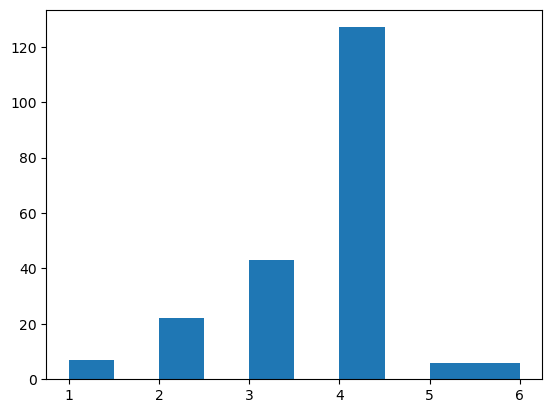

In [165]:
plt.hist(degs)

In [166]:
len(origins)

29

In [167]:
print(origins)

[26034664, 113536277, 114607252, 130015096, 145261423, 174792857, 174812848, 269334278, 277089929, 313278043, 767587073, 846547014, 846547082, 1449431464, 1449431630, 1833110279, 1833110282, 2177124604, 2177124606, 2180785582, 2180785617, 2181268830, 2181275340, 2187770699, 2190483580, 2190483587, 3313134384, 6207245783, 9105320429]


In [168]:
#origins=nodes#["A"]#nodes
#destinations=nodes#["F"]
od_pairs=[]
for o in origins:
   for d in nx.dfs_postorder_nodes(G,source=o):
    if((o!=d) and (d in destinations)):
        od_pairs.append((o,d))
#print(od_pairs)
print(len(od_pairs))

319


### Save the od's for later analysis

In [185]:
import pickle

with open(data_dir+"/OSM/"+city+"/od_pairs.pkl", 'wb') as f:
    # indent=2 is not needed but makes the file human-readable 
    # if the data is nested
    pickle.dump(od_pairs, f) 

#with open(data_dir+"/OSM/"+city+"/od_pairs.json", 'r') as f:
#    test = json.load(f)

#print(test)

In [171]:
od_route_n_dict={}
od_route_e_dict={}

# For a perfect result we need all possible routes between O and D
### This is prohibitively expensive to calculate, even on small networks
### Set max number of routes per OD here
# Route choice uses weighted paths with travel time
### Using 2 routes per OD covers more edges, makes a less sparse result
### This reduces the number of routes with zero flow vs. using 1 route per OD


### Routes from networkx library are lists of nodes. Make a list of edges, as well

In [172]:
# routes as sequence of nodes
routes_n=[]
routes_e=[]
nroutes_per_od=2
i=0
for od in od_pairs:
    if(i%100 == 0):
        print(f"Searching paths for od {od} {i/len(od_pairs)}")
    i+=1
    relist=[]
    rnlist=[]
    for path in k_shortest_paths(nx.DiGraph(cropped_graph), od[0], od[1], nroutes_per_od, weight="travel time"):
        rnlist.append(path)
        elist=[]
        for j in range(len(path)-1):
            e=(path[j], path[j+1])
            #print(f"e {e}")
            elist.append(e)
        #print(f"elist {elist}")
        relist.append(elist)
        #print(f"relist {relist}")
    od_route_e_dict[od]=relist
    routes_e.append(relist)
    od_route_n_dict[od]=rnlist
    routes_n.append(rnlist)

Searching paths for od (114607252, 174792857) 0.0
Searching paths for od (277089929, 9105320429) 0.31347962382445144
Searching paths for od (2177124604, 2177124606) 0.6269592476489029
Searching paths for od (3313134384, 9105320429) 0.9404388714733543


In [173]:
routes_e

[[[(114607252, 114607245),
   (114607245, 2190478940),
   (2190478940, 2190478937),
   (2190478937, 2190478932),
   (2190478932, 2190478922),
   (2190478922, 2190478924),
   (2190478924, 2187874240),
   (2187874240, 2187874242),
   (2187874242, 174792823),
   (174792823, 174792857)],
  [(114607252, 114607245),
   (114607245, 2190478940),
   (2190478940, 2190478937),
   (2190478937, 2190478932),
   (2190478932, 2190478922),
   (2190478922, 2190478924),
   (2190478924, 2187874240),
   (2187874240, 9086096517),
   (9086096517, 26051952),
   (26051952, 176722502),
   (176722502, 176721271),
   (176721271, 2187874242),
   (2187874242, 174792823),
   (174792823, 174792857)]],
 [[(114607252, 114607245),
   (114607245, 2190478940),
   (2190478940, 2190478937),
   (2190478937, 2190478932),
   (2190478932, 2190478922),
   (2190478922, 2190478924),
   (2190478924, 2187874240),
   (2187874240, 2187874242),
   (2187874242, 174792823),
   (174792823, 174812829),
   (174812829, 174812848)],
  [(11460

In [174]:
len(routes_e)

319

In [175]:
od_route_n_dict

{(114607252,
  174792857): [[114607252,
   114607245,
   2190478940,
   2190478937,
   2190478932,
   2190478922,
   2190478924,
   2187874240,
   2187874242,
   174792823,
   174792857], [114607252,
   114607245,
   2190478940,
   2190478937,
   2190478932,
   2190478922,
   2190478924,
   2187874240,
   9086096517,
   26051952,
   176722502,
   176721271,
   2187874242,
   174792823,
   174792857]],
 (114607252,
  174812848): [[114607252,
   114607245,
   2190478940,
   2190478937,
   2190478932,
   2190478922,
   2190478924,
   2187874240,
   2187874242,
   174792823,
   174812829,
   174812848], [114607252,
   114607245,
   2190478940,
   2190478937,
   2190478932,
   2190478922,
   2190478924,
   2187874240,
   9086096517,
   26051952,
   176722502,
   176721271,
   2187874242,
   174792823,
   174812829,
   174812848]],
 (114607252,
  2177124606): [[114607252,
   114607245,
   2190478940,
   2190478937,
   2190478932,
   2190478922,
   2190478934,
   145261423,
   2177124606], [1

In [176]:
od_route_e_dict

{(114607252,
  174792857): [[(114607252, 114607245),
   (114607245, 2190478940),
   (2190478940, 2190478937),
   (2190478937, 2190478932),
   (2190478932, 2190478922),
   (2190478922, 2190478924),
   (2190478924, 2187874240),
   (2187874240, 2187874242),
   (2187874242, 174792823),
   (174792823, 174792857)], [(114607252, 114607245),
   (114607245, 2190478940),
   (2190478940, 2190478937),
   (2190478937, 2190478932),
   (2190478932, 2190478922),
   (2190478922, 2190478924),
   (2190478924, 2187874240),
   (2187874240, 9086096517),
   (9086096517, 26051952),
   (26051952, 176722502),
   (176722502, 176721271),
   (176721271, 2187874242),
   (2187874242, 174792823),
   (174792823, 174792857)]],
 (114607252,
  174812848): [[(114607252, 114607245),
   (114607245, 2190478940),
   (2190478940, 2190478937),
   (2190478937, 2190478932),
   (2190478932, 2190478922),
   (2190478922, 2190478924),
   (2190478924, 2187874240),
   (2187874240, 2187874242),
   (2187874242, 174792823),
   (174792823,

In [177]:
od_route_names_dict={}
route_names=[]
for od in od_pairs:
    od_route_names=[]
    for i in range(0,len(od_route_e_dict[od])):
        string=((od[0],od[1],str(i)))
        od_route_names.append(string)
        route_names.append(string)
    od_route_names_dict[od]=tuple(od_route_names)


In [186]:
import pickle 

with open(data_dir+"/OSM/"+city+"/od_route_names_dict.pkl", "wb") as f:
    pickle.dump(od_route_names_dict, f)

 #with open('saved_dictionary.pkl', 'rb') as f:
 #   loaded_dict = pickle.load(f)

In [351]:
route_names

[(114607252, 174792857, '0'),
 (114607252, 174792857, '1'),
 (114607252, 174812848, '0'),
 (114607252, 174812848, '1'),
 (114607252, 2177124606, '0'),
 (114607252, 2177124606, '1'),
 (114607252, 2190483580, '0'),
 (114607252, 2190483580, '1'),
 (114607252, 145261423, '0'),
 (114607252, 145261423, '1'),
 (114607252, 2181275340, '0'),
 (114607252, 2181275340, '1'),
 (114607252, 313278043, '0'),
 (114607252, 313278043, '1'),
 (114607252, 846547082, '0'),
 (114607252, 846547082, '1'),
 (114607252, 3313134384, '0'),
 (114607252, 3313134384, '1'),
 (114607252, 1833110279, '0'),
 (114607252, 1833110279, '1'),
 (114607252, 9105320429, '0'),
 (114607252, 9105320429, '1'),
 (114607252, 130015096, '0'),
 (114607252, 130015096, '1'),
 (114607252, 1449431464, '0'),
 (114607252, 1449431464, '1'),
 (114607252, 26034664, '0'),
 (114607252, 26034664, '1'),
 (114607252, 277089929, '0'),
 (114607252, 277089929, '1'),
 (114607252, 2180785617, '0'),
 (114607252, 113536277, '0'),
 (130015096, 174792857, '0'

In [352]:
len(route_names)

627

In [353]:
od_route_names_dict

{(114607252, 174792857): ((114607252, 174792857, '0'),
  (114607252, 174792857, '1')),
 (114607252, 174812848): ((114607252, 174812848, '0'),
  (114607252, 174812848, '1')),
 (114607252, 2177124606): ((114607252, 2177124606, '0'),
  (114607252, 2177124606, '1')),
 (114607252, 2190483580): ((114607252, 2190483580, '0'),
  (114607252, 2190483580, '1')),
 (114607252, 145261423): ((114607252, 145261423, '0'),
  (114607252, 145261423, '1')),
 (114607252, 2181275340): ((114607252, 2181275340, '0'),
  (114607252, 2181275340, '1')),
 (114607252, 313278043): ((114607252, 313278043, '0'),
  (114607252, 313278043, '1')),
 (114607252, 846547082): ((114607252, 846547082, '0'),
  (114607252, 846547082, '1')),
 (114607252, 3313134384): ((114607252, 3313134384, '0'),
  (114607252, 3313134384, '1')),
 (114607252, 1833110279): ((114607252, 1833110279, '0'),
  (114607252, 1833110279, '1')),
 (114607252, 9105320429): ((114607252, 9105320429, '0'),
  (114607252, 9105320429, '1')),
 (114607252, 130015096): 

### Have to flatten the routes_e and routes_n lists in order to assign them to route_names

In [354]:
def flatten(l):
    return [item for sublist in l for item in sublist]

In [355]:
print(len(flatten(routes_e)))

627


In [356]:
# dict of origins and routes
routes_e_dict=dict(zip(route_names,flatten(routes_e)))# route names, edge sequence (tuple u,v)
routes_n_dict=dict(zip(route_names,flatten(routes_n)))# route names, node sequence (u)

In [357]:
routes_e_dict

{(114607252, 174792857, '0'): [(114607252, 114607245),
  (114607245, 2190478940),
  (2190478940, 2190478937),
  (2190478937, 2190478932),
  (2190478932, 2190478922),
  (2190478922, 2190478924),
  (2190478924, 2187874240),
  (2187874240, 2187874242),
  (2187874242, 174792823),
  (174792823, 174792857)],
 (114607252, 174792857, '1'): [(114607252, 114607245),
  (114607245, 2190478940),
  (2190478940, 2190478937),
  (2190478937, 2190478932),
  (2190478932, 2190478922),
  (2190478922, 2190478924),
  (2190478924, 2187874240),
  (2187874240, 9086096517),
  (9086096517, 26051952),
  (26051952, 176722502),
  (176722502, 176721271),
  (176721271, 2187874242),
  (2187874242, 174792823),
  (174792823, 174792857)],
 (114607252, 174812848, '0'): [(114607252, 114607245),
  (114607245, 2190478940),
  (2190478940, 2190478937),
  (2190478937, 2190478932),
  (2190478932, 2190478922),
  (2190478922, 2190478924),
  (2190478924, 2187874240),
  (2187874240, 2187874242),
  (2187874242, 174792823),
  (17479282

In [358]:
routes_n_dict

{(114607252, 174792857, '0'): [114607252,
  114607245,
  2190478940,
  2190478937,
  2190478932,
  2190478922,
  2190478924,
  2187874240,
  2187874242,
  174792823,
  174792857],
 (114607252, 174792857, '1'): [114607252,
  114607245,
  2190478940,
  2190478937,
  2190478932,
  2190478922,
  2190478924,
  2187874240,
  9086096517,
  26051952,
  176722502,
  176721271,
  2187874242,
  174792823,
  174792857],
 (114607252, 174812848, '0'): [114607252,
  114607245,
  2190478940,
  2190478937,
  2190478932,
  2190478922,
  2190478924,
  2187874240,
  2187874242,
  174792823,
  174812829,
  174812848],
 (114607252, 174812848, '1'): [114607252,
  114607245,
  2190478940,
  2190478937,
  2190478932,
  2190478922,
  2190478924,
  2187874240,
  9086096517,
  26051952,
  176722502,
  176721271,
  2187874242,
  174792823,
  174812829,
  174812848],
 (114607252, 2177124606, '0'): [114607252,
  114607245,
  2190478940,
  2190478937,
  2190478932,
  2190478922,
  2190478934,
  145261423,
  217712460

In [359]:
edge_labels_dict

{(26034662, 1985557963): (26034662, 1985557963),
 (26034662, 2181268836): (26034662, 2181268836),
 (26034663, 589403294): (26034663, 589403294),
 (26034668, 26034664): (26034668, 26034664),
 (26034668, 277089929): (26034668, 277089929),
 (26034669, 1985557923): (26034669, 1985557923),
 (26034669, 6207070037): (26034669, 6207070037),
 (26034670, 589402311): (26034670, 589402311),
 (26034670, 6775859250): (26034670, 6775859250),
 (26034671, 588876889): (26034671, 588876889),
 (26034671, 317537930): (26034671, 317537930),
 (26034672, 1985557912): (26034672, 1985557912),
 (26034672, 6381564384): (26034672, 6381564384),
 (26034673, 595594352): (26034673, 595594352),
 (26034673, 245532558): (26034673, 245532558),
 (26051948, 6775862780): (26051948, 6775862780),
 (26051948, 1985557921): (26051948, 1985557921),
 (26051949, 130015095): (26051949, 130015095),
 (26051949, 8633729233): (26051949, 8633729233),
 (26051950, 1985557931): (26051950, 1985557931),
 (26051950, 6775862757): (26051950, 6775

In [360]:
# route costs
routes_c_dict={}
for rn in route_names:
    es=routes_e_dict[rn]
    lc=[]
    for e in es:
 #       print(f"e {e}")
        c=edge_weights_dict[e]
        lc.append(c)
    routes_c_dict[rn]=lc
print(routes_c_dict)

{(114607252, 174792857, '0'): [9.8, 8.1, 2.4, 10.2, 0.9, 1.2, 20.2, 13.1, 13.9, 22.5], (114607252, 174792857, '1'): [9.8, 8.1, 2.4, 10.2, 0.9, 1.2, 20.2, 20.0, 9.9, 16.1, 6.8, 17.3, 13.9, 22.5], (114607252, 174812848, '0'): [9.8, 8.1, 2.4, 10.2, 0.9, 1.2, 20.2, 13.1, 13.9, 4.6, 19.8], (114607252, 174812848, '1'): [9.8, 8.1, 2.4, 10.2, 0.9, 1.2, 20.2, 20.0, 9.9, 16.1, 6.8, 17.3, 13.9, 4.6, 19.8], (114607252, 2177124606, '0'): [9.8, 8.1, 2.4, 10.2, 0.9, 9.7, 27.3, 40.2], (114607252, 2177124606, '1'): [9.8, 8.1, 2.4, 10.2, 0.9, 9.7, 10.0, 13.6], (114607252, 2190483580, '0'): [9.8, 8.1, 2.4, 10.2, 0.9, 9.7, 10.0, 1.1, 9.9], (114607252, 2190483580, '1'): [9.8, 8.1, 2.4, 10.2, 0.9, 1.2, 20.2, 13.1, 27.9, 40.5, 2.3], (114607252, 145261423, '0'): [9.8, 8.1, 2.4, 10.2, 0.9, 9.7, 27.3], (114607252, 145261423, '1'): [9.8, 8.1, 2.4, 10.2, 0.9, 1.2, 20.2, 13.1, 13.9, 4.6, 21.9, 2.4, 27.3], (114607252, 2181275340, '0'): [9.8, 8.1, 2.4, 10.2, 0.9, 1.2, 20.2, 13.1, 27.9, 13.2, 1.5, 13.2, 40.6, 10.0, 0

In [361]:
list(routes_e_dict.values())[0:2]

[[(114607252, 114607245),
  (114607245, 2190478940),
  (2190478940, 2190478937),
  (2190478937, 2190478932),
  (2190478932, 2190478922),
  (2190478922, 2190478924),
  (2190478924, 2187874240),
  (2187874240, 2187874242),
  (2187874242, 174792823),
  (174792823, 174792857)],
 [(114607252, 114607245),
  (114607245, 2190478940),
  (2190478940, 2190478937),
  (2190478937, 2190478932),
  (2190478932, 2190478922),
  (2190478922, 2190478924),
  (2190478924, 2187874240),
  (2187874240, 9086096517),
  (9086096517, 26051952),
  (26051952, 176722502),
  (176722502, 176721271),
  (176721271, 2187874242),
  (2187874242, 174792823),
  (174792823, 174792857)]]

In [362]:
# Make OD flows out of the route flows by summing over route flows for each OD

def od_flow_from_route_flow(od_pairs, route_flows):
    
 # Make OD flows out of the route flows by summing over route flows for each OD
    I=x.value.shape[1]
    J=len(od_pairs)
    j=0
    i_r=0
    od_flow=np.zeros((I))
    od_flow_matrix=np.zeros((J,I))
    for od in od_pairs:
        od_flow=0
        rs=od_route_names_dict[od]
        for r in rs:
            od_flow=od_flow+route_flows[i_r,:]
            print(j,i_r,r,od_flow, route_flows[i_r,:])
            i_r+=1
        od_flow_matrix[j,:]=od_flow
        j+=1
    return(od_flow_matrix)

# The network coverage if using only nodes of degree 1 and 2 for origins and destinations
### With 2 routes per OD, all the edges are sampled which have detectors on them
- Detectors with valid counts are blue dots
- Other dots are origins and destinations
- 627 routes are rainbow colors

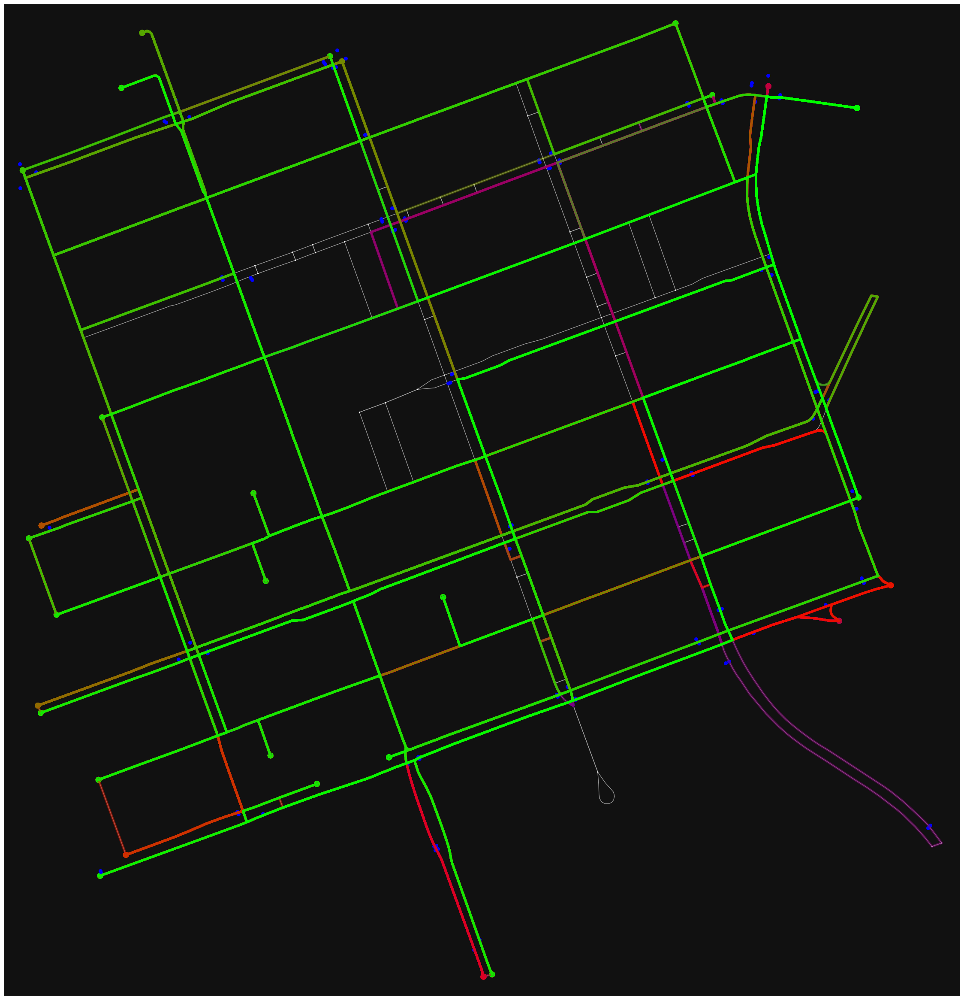

In [363]:
# plot the routes
nodez, edgez=n, e = osmnx.graph_to_gdfs(cropped_graph)
plotvals=list(routes_n_dict.values())
cols=osmnx.plot.get_colors(n=len(plotvals), cmap="brg", return_hex=True)
fig, ax = osmnx.plot_graph_routes(cropped_graph, routes=plotvals, route_colors= cols, route_linewidth=1, node_size=5,show=False, close=False,figsize=(30,30))
#for x,y, label in zip(nodez.geometry.x, nodez.geometry.y, nodez.index.tolist()):
#    ax.annotate(label, xy=(x,y),xytext=(10,10),textcoords="offset points",c="white",fontsize="large")
gdf_detector_graph_map.plot(ax=ax,color="blue", markersize=30)
#plt.savefig(data_dir+"/OSM/"+city+"/od_routes.png")
plt.show()
plt.close()

# Adjacency matrix (link-path incidence matrix) A=aij
- counted edges/links versus routes they are on
- 0,1 definition used by Vardi(1996) and Hazelton(2015)

In [188]:
len(route_names)

627

# This adjacency matrix is I (num counted edges) x J (num routes between OD's)

In [189]:
I=len(countkeys)
J=len(route_names)
print(I,J)
aij=np.zeros((I,J))
i=0
for e in countkeys:#I
 #   print(f"e {e} etype {type(e)}")
    j=0
    for rn in route_names:#J
 #       print(f"rn {rn} rntype {type(rn)}")
        rs=routes_e_dict[rn]
        for r in rs:
            #print(i,j,e,r)
            if((e[0],e[1]) == r):# countkeys is (u,v,key) tuple. just need u and v
                print(i,j,e,r)
                aij[i,j]=1
        j+=1
    i+=1
        

67 627
0 190 (589402289, 2180614756, 0) (589402289, 2180614756)
0 192 (589402289, 2180614756, 0) (589402289, 2180614756)
0 194 (589402289, 2180614756, 0) (589402289, 2180614756)
0 196 (589402289, 2180614756, 0) (589402289, 2180614756)
0 199 (589402289, 2180614756, 0) (589402289, 2180614756)
0 213 (589402289, 2180614756, 0) (589402289, 2180614756)
0 222 (589402289, 2180614756, 0) (589402289, 2180614756)
0 223 (589402289, 2180614756, 0) (589402289, 2180614756)
0 226 (589402289, 2180614756, 0) (589402289, 2180614756)
0 228 (589402289, 2180614756, 0) (589402289, 2180614756)
0 230 (589402289, 2180614756, 0) (589402289, 2180614756)
0 232 (589402289, 2180614756, 0) (589402289, 2180614756)
0 601 (589402289, 2180614756, 0) (589402289, 2180614756)
0 610 (589402289, 2180614756, 0) (589402289, 2180614756)
0 611 (589402289, 2180614756, 0) (589402289, 2180614756)
0 614 (589402289, 2180614756, 0) (589402289, 2180614756)
0 616 (589402289, 2180614756, 0) (589402289, 2180614756)
0 618 (589402289, 218061

In [190]:
aij# each column is a route between an OD pair J and each row has 1 if a link I is on the route

array([[0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0.,
        1., 0., 1., 0., 1., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 

In [191]:
np.sum(aij)

1516.0

### The aij matrix is sparse

In [192]:
np.sum(aij)/(aij.size)

0.036087505058439856

# Matrix of <i>all</i> edges which are on routes a2ij
- Map of all edges/links and the routes they are on
- 0,1
- Use to calculate the flows on non-measured links along the routes
- After the OD flows are calculated

In [193]:
edge_labels_dict.values()

dict_values([(26034662, 1985557963), (26034662, 2181268836), (26034663, 589403294), (26034668, 26034664), (26034668, 277089929), (26034669, 1985557923), (26034669, 6207070037), (26034670, 589402311), (26034670, 6775859250), (26034671, 588876889), (26034671, 317537930), (26034672, 1985557912), (26034672, 6381564384), (26034673, 595594352), (26034673, 245532558), (26051948, 6775862780), (26051948, 1985557921), (26051949, 130015095), (26051949, 8633729233), (26051950, 1985557931), (26051950, 6775862757), (26051952, 176722502), (26051952, 2187983882), (114607245, 114607252), (114607245, 2190478940), (114607252, 114607245), (130015095, 1838361782), (130015095, 130015096), (130015096, 130015095), (145261423, 2177124606), (174792823, 174792857), (174792823, 174812829), (174792857, 174792823), (174812829, 174812848), (174812829, 2190478930), (174812848, 174812829), (176721271, 2187874242), (176721271, 176721287), (176721287, 2188404539), (176722502, 176721271), (176722502, 2188404539), (245532

In [194]:
I=len(edge_labels_dict.keys())
J=len(route_names)
a2ij=np.zeros((I,J))
pi1=np.zeros((I,J))
i=0
for e in edge_labels_dict.values():#I
    j=0
    for rn in route_names:#J
        rs=routes_e_dict[rn]
        for r in rs:
#            print(i,j,e,r)
            if((e[0],e[1]) == r):
                a2ij[i,j]=1
                pi1[i,j]=edge_weights[i]
        j+=1
    i+=1

In [195]:
print(a2ij)

[[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 

In [196]:
np.sum(a2ij)

8988.0

In [197]:
a2ij.shape

(377, 627)

### For each time slice, Y is counts (dim m x 1) = A (dim m x n) * X (dim n x 1), m<n .
- Need to find X the OD flow
- m is the number of edges with counts on them
- n is the number of routes between OD
- dimension 1 becomes K for K time slices
- Here, K is 1440 slices of 0.25 hrs each = 360 hr = 15 d

In [198]:
print(aij.shape, counts.shape)

(67, 627) (67, 1440)


# Prepare some helper functions for calculating route travel times

In [199]:
# Average travel time on all routes from node curr to node d

def get_av_t(G,curr, d):
    #paths=nx.all_simple_paths(G,curr,d)
    paths=k_shortest_paths(nx.DiGraph(cropped_graph), curr, d, 2, weight="travel time")
    av_t=0
    sum=0
    for path in map(nx.utils.pairwise,paths):       
        for i in list(path):
 #           print(f"i {i} weight {edge_weights_dict[i]}")
            tp=edge_weights_dict[i]
  #          print(f"tp {tp}")
            av_t=av_t+tp
  #          print(f"tav {av_t}")
        sum+=1
#    print(f"sum {sum}")
    if(sum>0):
        av_t=av_t/sum#else there are no paths (curr = d)
    print(f"avt {av_t}")
    return(av_t)

In [200]:
print(nx.get_edge_attributes(G,"weight"))

{(26034662, 1985557963, 0): 2.4, (26034662, 2181268836, 0): 10.0, (26034663, 589403294, 0): 2.9, (26034668, 26034664, 0): 12.9, (26034668, 277089929, 0): 1.2, (26034669, 1985557923, 0): 1.3, (26034669, 6207070037, 0): 3.5, (26034670, 589402311, 0): 1.5, (26034670, 6775859250, 0): 5.6, (26034671, 588876889, 0): 22.8, (26034671, 317537930, 0): 13.0, (26034672, 1985557912, 0): 38.6, (26034672, 6381564384, 0): 1.5, (26034673, 595594352, 0): 10.0, (26034673, 245532558, 0): 5.3, (26051948, 6775862780, 0): 2.3, (26051948, 1985557921, 0): 38.9, (26051949, 130015095, 0): 19.0, (26051949, 8633729233, 0): 5.5, (26051950, 1985557931, 0): 38.8, (26051950, 6775862757, 0): 6.0, (26051952, 176722502, 0): 16.1, (26051952, 2187983882, 0): 10.1, (114607245, 114607252, 0): 9.8, (114607245, 2190478940, 0): 8.1, (114607252, 114607245, 0): 9.8, (130015095, 1838361782, 0): 21.1, (130015095, 130015096, 0): 8.4, (130015096, 130015095, 0): 8.4, (145261423, 2177124606, 0): 40.2, (174792823, 174792857, 0): 22.5, (

In [201]:
# Travel time on routes from node curr to node d

def get_tr(route,curr, d):
    tr=0
    es=routes_e_dict[route]
    start_i=0
    for e in es:
        if(e[0])==curr:
 #           print(f"get_tr {e},{curr}")
            start_i = start_i
            break
        else:
            start_i+=1
    #print(f"start_i {start_i}")        
    for i in range(start_i,len(es)):# add link costs along the route from curr node (start) to the end
        tr=tr+(edge_weights_dict[es[i]])
    print(f"tr {tr}")
    return(tr)

# Helper dict of all the nodes in the set of routes on the OD pairs

In [202]:
#
# Get all the nodes in all possible routes for each OD, flatten and make unique
# Loses the route sequence however
#
#for all od choose relation rel
od_nodes_dict={}
for od in od_pairs:
    od_nodes=[]
# get all routes on rel
    rs=od_route_names_dict[od]
    for r in rs:
        od_nodes.append(routes_n_dict[r])
    xx=flatten(od_nodes)
    xx_set=set(xx)
    od_nodes=list(xx_set)
    print(f"od {od} has {len(rs)} routes over nodes {od_nodes}")
    od_nodes_dict[od]=od_nodes

od (114607252, 174792857) has 2 routes over nodes [2187874240, 2187874242, 174792857, 9086096517, 176722502, 2190478922, 2190478924, 114607245, 26051952, 114607252, 2190478932, 174792823, 2190478937, 2190478940, 176721271]
od (114607252, 174812848) has 2 routes over nodes [2187874240, 2187874242, 9086096517, 176722502, 2190478922, 2190478924, 114607245, 174812848, 26051952, 114607252, 2190478932, 174792823, 2190478937, 2190478940, 174812829, 176721271]
od (114607252, 2177124606) has 2 routes over nodes [2190478922, 114607245, 145261423, 114607252, 2190478932, 2190478934, 2190478936, 2190478937, 2190478940, 2177124606]
od (114607252, 2190483580) has 2 routes over nodes [2187874240, 2187874242, 2190483586, 2187770693, 2190478922, 2190478924, 114607245, 2190478926, 2190483580, 114607252, 2190478932, 2190478934, 2190478936, 2190478937, 2190478940]
od (114607252, 145261423) has 2 routes over nodes [2187874240, 2187874242, 2190478922, 2190478924, 114607245, 145261423, 2190478930, 114607252, 

In [203]:
od_nodes_dict

{(114607252, 174792857): [2187874240,
  2187874242,
  174792857,
  9086096517,
  176722502,
  2190478922,
  2190478924,
  114607245,
  26051952,
  114607252,
  2190478932,
  174792823,
  2190478937,
  2190478940,
  176721271],
 (114607252, 174812848): [2187874240,
  2187874242,
  9086096517,
  176722502,
  2190478922,
  2190478924,
  114607245,
  174812848,
  26051952,
  114607252,
  2190478932,
  174792823,
  2190478937,
  2190478940,
  174812829,
  176721271],
 (114607252, 2177124606): [2190478922,
  114607245,
  145261423,
  114607252,
  2190478932,
  2190478934,
  2190478936,
  2190478937,
  2190478940,
  2177124606],
 (114607252, 2190483580): [2187874240,
  2187874242,
  2190483586,
  2187770693,
  2190478922,
  2190478924,
  114607245,
  2190478926,
  2190483580,
  114607252,
  2190478932,
  2190478934,
  2190478936,
  2190478937,
  2190478940],
 (114607252, 145261423): [2187874240,
  2187874242,
  2190478922,
  2190478924,
  114607245,
  145261423,
  2190478930,
  114607252,
  2

# Helper dict to list all edge tuples (u,v) on the set of routes on the OD pairs

In [204]:
#
# Get all the edges in all possible routes for each OD, flatten and make unique
# Sequence of the edges in the routes is lost
#
#for all od choose relation rel
od_edges_uv_dict={}
for od in od_pairs:
    od_edge_names=[]
    od_edges_uv=[]
# get all routes on rel
    rs=od_route_names_dict[od]
    for r in rs:
        od_edge_names.append(routes_e_dict[r])
    xx=flatten(od_edge_names)
    xx_set=set(xx)
    od_edge_names=list(xx_set)
#    print(od_edge_names)
    for en in od_edge_names:
 #       print(en)
        od_edges_uv.append(en)
    #xx=flatten(od_edges_uv)
    #xx_set=set(xx)
    #od_edges_uv=list(xx_set)
    print(f"od {od} has {len(rs)} routes over edges {od_edges_uv}")
    od_edges_uv_dict[od]=od_edges_uv

od (114607252, 174792857) has 2 routes over edges [(174792823, 174792857), (2190478924, 2187874240), (2190478937, 2190478932), (9086096517, 26051952), (26051952, 176722502), (114607252, 114607245), (2190478940, 2190478937), (2190478922, 2190478924), (2190478932, 2190478922), (2187874240, 2187874242), (2187874242, 174792823), (114607245, 2190478940), (176721271, 2187874242), (176722502, 176721271), (2187874240, 9086096517)]
od (114607252, 174812848) has 2 routes over edges [(26051952, 176722502), (2190478924, 2187874240), (2190478937, 2190478932), (9086096517, 26051952), (114607252, 114607245), (2190478940, 2190478937), (2190478922, 2190478924), (2190478932, 2190478922), (2187874240, 2187874242), (2187874242, 174792823), (174792823, 174812829), (174812829, 174812848), (114607245, 2190478940), (176721271, 2187874242), (176722502, 176721271), (2187874240, 9086096517)]
od (114607252, 2177124606) has 2 routes over edges [(2190478937, 2190478932), (2190478936, 2177124606), (2190478934, 14526

In [205]:
od_edges_uv_dict

{(114607252, 174792857): [(174792823, 174792857),
  (2190478924, 2187874240),
  (2190478937, 2190478932),
  (9086096517, 26051952),
  (26051952, 176722502),
  (114607252, 114607245),
  (2190478940, 2190478937),
  (2190478922, 2190478924),
  (2190478932, 2190478922),
  (2187874240, 2187874242),
  (2187874242, 174792823),
  (114607245, 2190478940),
  (176721271, 2187874242),
  (176722502, 176721271),
  (2187874240, 9086096517)],
 (114607252, 174812848): [(26051952, 176722502),
  (2190478924, 2187874240),
  (2190478937, 2190478932),
  (9086096517, 26051952),
  (114607252, 114607245),
  (2190478940, 2190478937),
  (2190478922, 2190478924),
  (2190478932, 2190478922),
  (2187874240, 2187874242),
  (2187874242, 174792823),
  (174792823, 174812829),
  (174812829, 174812848),
  (114607245, 2190478940),
  (176721271, 2187874242),
  (176722502, 176721271),
  (2187874240, 9086096517)],
 (114607252, 2177124606): [(2190478937, 2190478932),
  (2190478936, 2177124606),
  (2190478934, 145261423),
  (1

In [206]:
countkeys_uv=[]
for uvk in countkeys:
    countkeys_uv.append((uvk[0],uvk[1]))
countkeys_uv

[(589402289, 2180614756),
 (9086096518, 2180614754),
 (1449431554, 2180614752),
 (8633729231, 9086096516),
 (1985557931, 9086096518),
 (2187874241, 2190478928),
 (2190478930, 2190478924),
 (2180785617, 2190478932),
 (2180614756, 1449431476),
 (6167357881, 1449431467),
 (8873674098, 1449431465),
 (2279153639, 1449431476),
 (589472357, 9991984390),
 (6207022859, 26034668),
 (6381474060, 26034670),
 (6207022860, 595594347),
 (6775859251, 589402311),
 (6381564384, 595594348),
 (589402311, 26034670),
 (595594347, 595594348),
 (1449431465, 1449431464),
 (1449431504, 1449431544),
 (26034673, 595594352),
 (4544002874, 26034669),
 (9756035317, 1985557927),
 (6207070036, 1985557923),
 (9991984390, 589472357),
 (6207245783, 589472358),
 (767587073, 589472358),
 (2189497243, 589472357),
 (2279153639, 2189497210),
 (2189497232, 2189497200),
 (2187983890, 2189497210),
 (2187983881, 2187983891),
 (2187983885, 2187983882),
 (2190478936, 2177124606),
 (576876287, 576877857),
 (663497749, 252588303),
 (

In [207]:
od_route_e_dict

{(114607252,
  174792857): [[(114607252, 114607245),
   (114607245, 2190478940),
   (2190478940, 2190478937),
   (2190478937, 2190478932),
   (2190478932, 2190478922),
   (2190478922, 2190478924),
   (2190478924, 2187874240),
   (2187874240, 2187874242),
   (2187874242, 174792823),
   (174792823, 174792857)], [(114607252, 114607245),
   (114607245, 2190478940),
   (2190478940, 2190478937),
   (2190478937, 2190478932),
   (2190478932, 2190478922),
   (2190478922, 2190478924),
   (2190478924, 2187874240),
   (2187874240, 9086096517),
   (9086096517, 26051952),
   (26051952, 176722502),
   (176722502, 176721271),
   (176721271, 2187874242),
   (2187874242, 174792823),
   (174792823, 174792857)]],
 (114607252,
  174812848): [[(114607252, 114607245),
   (114607245, 2190478940),
   (2190478940, 2190478937),
   (2190478937, 2190478932),
   (2190478932, 2190478922),
   (2190478922, 2190478924),
   (2190478924, 2187874240),
   (2187874240, 2187874242),
   (2187874242, 174792823),
   (174792823,

### Helper dict of route names and the travel time (cost =c) on the route

In [208]:
routes_c_dict

{(114607252, 174792857, '0'): [9.8,
  8.1,
  2.4,
  10.2,
  0.9,
  1.2,
  20.2,
  13.1,
  13.9,
  22.5],
 (114607252, 174792857, '1'): [9.8,
  8.1,
  2.4,
  10.2,
  0.9,
  1.2,
  20.2,
  20.0,
  9.9,
  16.1,
  6.8,
  17.3,
  13.9,
  22.5],
 (114607252, 174812848, '0'): [9.8,
  8.1,
  2.4,
  10.2,
  0.9,
  1.2,
  20.2,
  13.1,
  13.9,
  4.6,
  19.8],
 (114607252, 174812848, '1'): [9.8,
  8.1,
  2.4,
  10.2,
  0.9,
  1.2,
  20.2,
  20.0,
  9.9,
  16.1,
  6.8,
  17.3,
  13.9,
  4.6,
  19.8],
 (114607252, 2177124606, '0'): [9.8, 8.1, 2.4, 10.2, 0.9, 9.7, 27.3, 40.2],
 (114607252, 2177124606, '1'): [9.8, 8.1, 2.4, 10.2, 0.9, 9.7, 10.0, 13.6],
 (114607252, 2190483580, '0'): [9.8, 8.1, 2.4, 10.2, 0.9, 9.7, 10.0, 1.1, 9.9],
 (114607252, 2190483580, '1'): [9.8,
  8.1,
  2.4,
  10.2,
  0.9,
  1.2,
  20.2,
  13.1,
  27.9,
  40.5,
  2.3],
 (114607252, 145261423, '0'): [9.8, 8.1, 2.4, 10.2, 0.9, 9.7, 27.3],
 (114607252, 145261423, '1'): [9.8,
  8.1,
  2.4,
  10.2,
  0.9,
  1.2,
  20.2,
  13.1,
  13

In [209]:
od_route_names_dict

{(114607252, 174792857): ((114607252, 174792857, '0'),
  (114607252, 174792857, '1')),
 (114607252, 174812848): ((114607252, 174812848, '0'),
  (114607252, 174812848, '1')),
 (114607252, 2177124606): ((114607252, 2177124606, '0'),
  (114607252, 2177124606, '1')),
 (114607252, 2190483580): ((114607252, 2190483580, '0'),
  (114607252, 2190483580, '1')),
 (114607252, 145261423): ((114607252, 145261423, '0'),
  (114607252, 145261423, '1')),
 (114607252, 2181275340): ((114607252, 2181275340, '0'),
  (114607252, 2181275340, '1')),
 (114607252, 313278043): ((114607252, 313278043, '0'),
  (114607252, 313278043, '1')),
 (114607252, 846547082): ((114607252, 846547082, '0'),
  (114607252, 846547082, '1')),
 (114607252, 3313134384): ((114607252, 3313134384, '0'),
  (114607252, 3313134384, '1')),
 (114607252, 1833110279): ((114607252, 1833110279, '0'),
  (114607252, 1833110279, '1')),
 (114607252, 9105320429): ((114607252, 9105320429, '0'),
  (114607252, 9105320429, '1')),
 (114607252, 130015096): 

# Calculate the finite-memory Markov P transitions from the travel times on the routes as in Figure 1 of Dey.
# P matrix is i links x j OD relations
# $P_i{^j}$ is a sum over M links per route on each OD j this of dim M+1 x M+1 as in Dey (9)
# Use only edges with counts on them
- Edge ID of counted edges in countkeys (uvk) or countkey_uv (uv)
- Library networkx returns (uv) while osmnx returns (uvk)
- This matrix is called A in Dey et al. (eqn 24)
- It is the initial routing probability: zero memory Markov routing
- The probability of a vehicle at a node to travel to all the adjacent nodes toward d
- Does not take into account what route it's on
- Djikstra algorithm chooses max

In [210]:
#
# It is correct in Dey to use J as the number of OD's
# This is smaller than the number of routes
# 
#
I=len(countkeys_uv)# all edges with counts
J=len(od_pairs)# one column per OD
pij=np.zeros((I, J))
#c_inv=np.zeros((I, J))
for j in range(len(od_pairs)):
    od=od_pairs[j]
    o=od[0]
    d=od[1]
    i=0
    for curr in countkeys_uv:# the I dimension of the pij array. curr is (o,next)
        rns = od_route_names_dict[od]
        i_n = 0
        tr=0
        av_t=0
        for name in rns:# for each route on this od sum the travel time of the edges
            av_t=av_t+np.sum(routes_c_dict[name])
        av_t=av_t/len(rns)
#        print(f"av_t {av_t}")

        # if this curr edge is in the route with the name
        # get the route travel time over this edge
        for name in rns:
            path=routes_e_dict[name]
 #           print((curr[0],curr[1]), path)
            if(((curr[0],curr[1])) in path): # if this u,v,k edge is in this route
                tr=tr+np.sum(routes_c_dict[name])
                pij[i,j]=np.exp(-2*np.abs((av_t-tr)/av_t))
#                print(f"i_n tr av_t {i_n} {tr} {av_t}")
            i_n+=1 #index the next route for this od

#        print(f"i j tr av_t p {i} {j} {tr} {av_t} {pij[i,j]}")
        i+=1 # increment the row, ie next edge with counts
#
# Each entry in pij sums to one over the routes passing through edge i
# C= sum of each time a u node is passed by a route
# Following code lists the u of each node in each edge in pij and counts its ocurrence
# Each appearance of a u corresponds to a different v so the sum is the number
# of route alternatives at each node u
# The result is actually matrix A (27) in Dey
#
c_inv=np.zeros(pij.shape[0])
tmp=[]
for i in range(0,pij.shape[0]):
    tmp.append(countkeys[i][0])
#   print(f"tmp {tmp}")
for i in range(0,len(tmp)):
    c_inv[i]=tmp.count(tmp[i])
#   print(f"c_inv ,{c_inv}")
c=1./c_inv
for i in range(0,pij.shape[0]):
      pij[i,:]=pij[i,:]*c[i]
print(c_inv)
print(pij)

                

[1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 2. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 2. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 2. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 2. 1. 1. 2. 1. 1. 2. 1. 1. 1. 1. 1.]
[[0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.         0.         0.
  0.         0.

In [211]:
print(np.sum(pij))

434.87781669001237


In [212]:
np.max(pij)

1.0

# $P$ is the matrix of the probability of a vehicle on OD pair j passing over link i (Dey equation 30)
- It is a route-dependent choice of next node toward d
- Probability of choosing next node (n+1) depends on which route was taken to arrive at node (n)
- Thus a finite-memory Markov transition matrix

In [213]:
#
# To acquire the P matrix (finite-memory markov transition)
# we need to multiply the edge pi's over each j in each OD column
# then sum them over all j in the OD relation
#
# for each column (j in J)
#   for each edge (i in I)
#       get edge u_v
#       find the route for j that u_v is on
#       get the pij for all these edges
#       multiply them together and add them to next result for next route in j        
#
I=len(countkeys)# all edges with counts
J=len(od_pairs)# one column per OD
P_mat=np.zeros((I,J))
for j in range(0,J):
       od=od_pairs[j]
       rs=od_route_e_dict[od]
       #print(f"rs {rs}")
       for i in range(0,I):
            ptemp=0
            e=list(countkeys_uv)[i]
 #           print(f"Running for edge {e} and od {od}")
            for r in rs:
 #             print(f"e tuple {e} r {r}")
              if(e in r):
 #               print(f"  Edge {e} in Route {r}")
                product=[]
                for ee in r:
 #                   print(f"ee {ee} r {r}")
                    if(ee in list(countkeys_uv)):
                        ii=list(countkeys_uv).index(ee)
                        product.append(pij[ii,j])
 
                ptemp=np.prod(product)+ptemp
 
 #       print(f"i,j, ptemp,e,od {i}, {j}, {ptemp},{e},{od}")
#        print(i,j,ptemp)
       P_mat[i,j]=ptemp


In [214]:
P_mat

array([[0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.000000

In [215]:
print(np.sum(P_mat))

0.1201559674534303


In [216]:
print(np.max(P_mat))

0.028890439833520683


# The model Y = M @ X can use
### M = aij dim (n_edges_with_counts, n_routes)
### M = pij dim (n_edges_with_counts, n_od_pairs)
### M = P_mat dim (n_edges_with_counts, n_od_pairs)
### It is a question of how much information the matrix should contain to constrain the solution
### Realistic "turning probabilities" could also be used if one knew details of traffic lights, congestion queues, etc.

# aij: Model time slices of counts on measured links for all routes (each OD pair can have a different number of routes). Flows are per route, not per OD

In [217]:
counts100=counts[:,0:99]

In [218]:
print(counts100.shape,aij.shape)

(67, 99) (67, 627)


# MCMC estimation of the OD flows

### joint log-posterior conditional on parameter values

$yhat_i=aij*\lambda_j$<br>
$p_i=N(yhat_i,t)$


In [219]:
i_tr=int(0.75*(counts.shape[1]))
i_va=i_tr+int(0.2*(counts.shape[1]))
print(i_tr, i_va)

1080 1368


In [220]:
Y=counts[:,i_tr+1:i_va]

In [221]:
Y.shape

(67, 287)

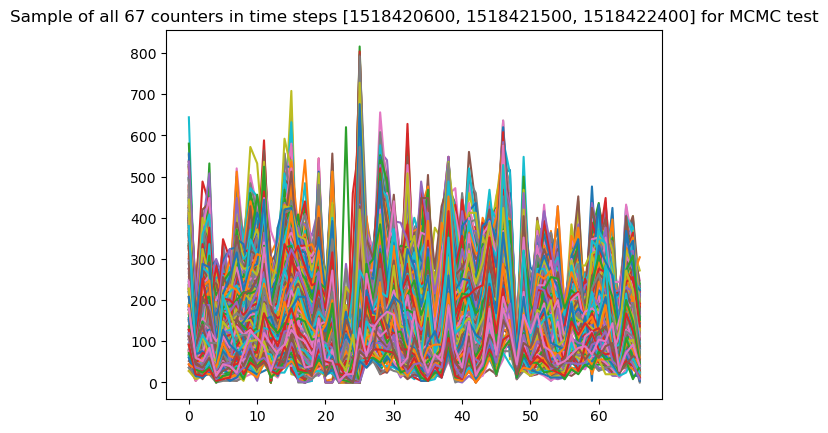

In [222]:
plt.plot(Y)
time_of_day = counts_time[30:33]
plt.title("Sample of all 67 counters in time steps "+str(time_of_day)+" for MCMC test")
plt.show()
plt.close()

In [223]:
from scipy.stats import distributions

dgamma = distributions.gamma.logpdf
dnorm = distributions.norm.logpdf


def calc_posterior(lam, y=Y, A=aij):
    a= .1#1. rate of occurrences (successes)
    b= 1#10 number of poisson distributions in the gamma
    # Y I x 1
    # aij I x J
    # lam J x 1
    ##b=len(lam)
    # Calculate joint posterior, given values for lambda (this is the average of X)
    # The gamma pdf gives a likelihood for a Poisson distributed parameter of
    # rate a (lambda) and number of Poisson distributions b
    logp = dgamma(lam, lam,b)
    #logp=dgamma(lam,b)
    #print(f"calc_posterior b  {b} ... logp {logp}")
    yhat = A @ lam
    # Data likelihood. How appropriate is Std Dev 1?
    #print(f"calc_posterior yhat {yhat.shape} Y {Y.shape} lam {lam.shape}")
    #print(f"calc_posterior yhat {yhat}")
    logp += sum(dnorm(Y, yhat, 1.))
    logp=logp.sum()
    
    return logp

In [224]:
from scipy.stats import distributions

dgamma = distributions.gamma.logpdf
dnorm = distributions.norm.logpdf


def calc_posterior_t(lam, time_step, y=Y, A=aij):
    a= .1#1. rate of occurrences (successes)
    b= 1#10 number of poisson distributions in the gamma
    # Y I x 1
    # aij I x J
    # lam J x 1
    #b=len(lam)
    # Calculate joint posterior, given values for lambda (this is the average of X)
    # The gamma pdf gives a likelihood for a Poisson distributed parameter of
    # rate a (lambda) and number of Poisson distributions b
    logp = dgamma(lam, lam,b)
    #print(f"calc_posterior lam {lam}")
    yhat = A @ lam
    # Data likelihood. How appropriate is Std Dev 1?
    #print(f"calc_posterior yhat {yhat.shape} Y {Y.shape} lam {lam.shape}")
    logp += sum(dnorm(Y[:,time_step], yhat, 1.))
    logp=logp.sum()
    
    return logp

In [225]:
#dgamma(lam_init,lam_init,1)

### Acceptance step of Metropolis-Hastings is tuned here
### Only a 1D input array, no time slices are expected
### Use with calc_posterior

In [226]:
from scipy.stats import poisson

rnorm=np.random.normal
runif = np.random.rand

def metropolis_tuned(n_iterations, initial_values, prop_var=1, 
                     tune_for=None, tune_interval=100):
    
    n_params = len(initial_values)
    #n_params = initial_values.shape[1]# one time step
            
    # Initial proposal standard deviations
    prop_sd = [prop_var] * n_params
    
    # Initialize trace for parameters
    trace = np.empty((n_iterations+1, n_params))
    
    # Set initial values
    trace[0,:] = initial_values# iteration, route flows
    # Initialize acceptance counts
    accepted = [0]*n_params
    
    # Calculate joint posterior for initial values
    #current_log_prob = calc_posterior(*trace[0])
 #   print(f"MH current lambda {trace[0]}")
    current_log_prob = calc_posterior(trace[0,:])
 #   print(f"MH current_lp {current_log_prob}")
    if (tune_for > n_iterations):
        print("WARNING: set tune_for < n_iterations or the output arrays will be empty")
    if tune_for is None:
        tune_for = n_iterations/2
    
    for i in range(n_iterations):
    
        if not i%1000: print('Iteration %i' % i)
    
        # Grab current parameter values
        current_params = trace[i,:]
        param_index=np.arange(n_params)
        np.random.shuffle(param_index)
    
        for j in param_index:# route flows
    
            # Get current value for parameter j
            p = trace[i,:].copy()
    
            # Propose new value
            
            # Ensure theta is positive
            #theta = np.exp(rnorm(np.log(current_params[j]), prop_sd[j]))
            # Propose new value > 0 ... draw from an integer distribution instead of
                #theta = np.exp(rnorm(np.log(current_params[j]), prop_sd[j]))
            uu=runif()
            kk=1.
            if (uu < 0.5):
                kk=-1.
            step=np.max(kk*prop_sd[j],0)
            mu = current_params[j]+step
            if(mu >=0):
                theta = poisson.rvs(current_params[j]+step,size=1)
            else:
                print(f"MH Warning mu = {mu} < 0 and no new theta can be proposed from Poisson distribution.")
            # Insert new value 
            p[j] = theta
    
            # Calculate log posterior with proposed value
 #           print(f"MH new lambda {p}")
            #proposed_log_prob = calc_posterior(*p)
            proposed_log_prob = calc_posterior(p)
 #           print(f"MH proposed_lp {proposed_log_prob}")
    
            # Log-acceptance rate
            alpha = proposed_log_prob - current_log_prob
    
            # Sample a uniform random variate
            u = runif()
    
            # Test proposed value
#            print(f"MH iteration {i} before acceptance test  u {u} alpha {alpha}")
            if np.log(u) < alpha:
                # Accept
 #               print(f"MH logu < alpha {np.log(u)} {alpha}")
                trace[i+1,j] = theta
                current_log_prob = proposed_log_prob
                accepted[j] += 1
            else:
                # Reject
                trace[i+1,j] = trace[i,j]
                
            # Tune every 100 iterations
            if (not (i+1) % tune_interval) and (i < tune_for):
        
                # Calculate aceptance rate
                acceptance_rate = (1.*accepted[j])/tune_interval
                if acceptance_rate<0.2:
                    prop_sd[j] *= 0.9
                elif acceptance_rate>0.5:
                    prop_sd[j] *= 1.1
                accepted[j] = 0
                
    return trace, accepted#trace[tune_for:], accepted

### MH 2 with time-slice dimension
### Estimates one theta per time slice
### Time slices are independent
### Uses calc_posterior_t

In [227]:
rnorm=np.random.normal
from scipy.stats import poisson
runif = np.random.rand

def metropolis_tuned2(n_iterations, initial_values, prop_var=1, 
                     tune_for=None, tune_interval=100):
    # For each time slice ii we estimate all theta
    # First initial_values index is time
    # Second intitial_values index is number of theta
    n_params = initial_values.shape[0]
    trace = np.empty((n_iterations+1,n_params,initial_values.shape[1]))# iters, routes, time slices
    # Initialize acceptance counts
    accepted = np.zeros(initial_values.shape)# routes, time slices
    for ii in range(initial_values.shape[1]):
        
    #n_params = initial_values.shape[1]# one time step
            
    # Initial proposal standard deviations
        prop_sd = [prop_var] * n_params# each lambda can have a different variance if needed
    
    # Initialize trace for parameters
    #    trace = np.empty((n_iterations+1, n_params))
    
    # Set initial values
        trace[0,:,ii] = initial_values[:,ii]
    
    # Calculate joint posterior for initial values
    #current_log_prob = calc_posterior(*trace[0])
 #       print(f"MH2 time {ii} initial lambda {trace[0,:,ii]}")
        current_log_prob = calc_posterior_t(trace[0,:,ii],ii)
        #current_log_prob = calc_posterior(trace[0,:,ii])
 #   print(f"MH current_lp {current_log_prob}")
        if tune_for is None:
            tune_for = n_iterations/2
    
        for i in range(n_iterations):
    
            if not i%200: print('Iteration %i' % i)
    
        # Grab current parameter values
            current_params = trace[i,:,ii]
            param_index=np.arange(n_params)
            np.random.shuffle(param_index)

            for j in param_index:
    
            # Get current value for parameter j
                p = trace[i,:,ii].copy()
    
            # Propose new value > 0 ... draw from an integer distribution instead of
                #theta = np.exp(rnorm(np.log(current_params[j]), prop_sd[j]))
                uu=runif()
                kk=1.
                if (uu < 0.5):
                    kk=-1.
                step=np.max(kk*prop_sd[j],0)
                mu = current_params[j]+step
                if(mu >=0):
                    theta = poisson.rvs(current_params[j]+step,size=1)
                else:
                    print(f"MH2 Warning mu = {mu} < 0 and no new theta can be proposed from Poisson distribution.")
                #if(int(prop_sd[j]))>=1:
                #    theta = current_params[j]+np.random.randint(-int(prop_sd[j]),int(prop_sd[j]))
                #else:
                #    print(f"MH2 iteration {i} prop_sd < 1 theta[{j}] stopped updating")
            # Insert new value 
                p[j] = theta
    
            # Calculate log posterior with proposed value
#            print(f"MH new lambda {p}")
            #proposed_log_prob = calc_posterior(*p)
                #proposed_log_prob = calc_posterior(p)
                proposed_log_prob = calc_posterior_t(p,ii)
#            print(f"MH current_lp {proposed_log_prob}")
    
            # Log-acceptance rate
                alpha = proposed_log_prob - current_log_prob
    
            # Sample a uniform random variate
                u = runif()
    
            # Test proposed value
                if np.log(u) < alpha:
                # Accept
                    trace[i+1,j,ii] = theta
                    current_log_prob = proposed_log_prob
                    accepted[j,ii] += 1
                else:
                # Reject
                    trace[i+1,j,ii] = trace[i,j,ii]
                
            # Tune every 100 iterations
                if (not (i+1) % tune_interval) and (i < tune_for):
        
                # Calculate aceptance rate
                    acceptance_rate = (1.*accepted[j,ii])/tune_interval
                    if acceptance_rate<0.2:
                        prop_sd[j] *= 0.9
                    elif acceptance_rate>0.5:
                        prop_sd[j] *= 1.1
                    accepted[j,ii] = 0
                
    return trace, accepted#trace[tune_for:], accepted

### Run MH with tuned proposal variance

In [228]:
# The result is sensitive to these assumptions because of the random walk
# Plot the autocorrelation of lambdas
#lam_init=np.array([100,100, 100, 100, 100, 100])
lam_init=np.zeros(aij.shape[1])+10.
# six routes in the rows, 5 time slices across the columns
lam_init2=np.zeros((aij.shape[1],Y.shape[1]))+10
lam_init2.shape

(627, 287)

# Markov chain monte carlo takes ca. 3 mins per time slice, 5hr to run a day (96 slices)

In [229]:
run_MCMC=False
n_iter = 1000
if(run_MCMC):
#trace_tuned, acc = metropolis_tuned(n_iter, lam_init, prop_var=1, tune_interval = 50, tune_for=600)
    trace_tuned, acc = metropolis_tuned2(n_iter, lam_init2, prop_var=1,tune_interval=50,tune_for=600)
    np.save(data_dir+"/OSM/"+city+"/route_flows_trace_mcmc.npy", trace_tuned)    # .npy extension is added if not given
else:
    trace_tuned = np.load(data_dir+"/OSM/"+city+"/route_flows_mcmc.npy")

In [233]:
trace_tuned.shape

(1001, 627, 287)

In [273]:
#np.save(data_dir+"/OSM/"+city+"/route_flows_mcmc.npy", trace_tuned[-1])    # .npy extension is added if not given

### Print the acceptance rate of the new proposals

In [234]:
# percent accepted
#np.array(acc, float)/trace_tuned.shape[0]
print(f"{np.array2string(np.array(acc, float)/trace_tuned.shape[0],precision=2, floatmode='fixed')}")


[[0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.15 0.00 0.00 0.00 0.00 0.15 0.00
  0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00
  0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00
  0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00
  0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00
  0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00
  0.00 0.00 0.00 0.00 0.00 0.00 0.21 0.02 0.11 0.14 0.00 0.00 0.00 0.00
  0.00 0.11 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00
  0.00 0.00 0.00 0.00 0.06 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00
  0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00
  0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00
  0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00
  0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00
  0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.

### Print all tuned results (iteration, route, time slice)
### Note that y = aij * X requires (edge, time slice) = (edge, route)  * (route, time slice)

In [235]:
trace_tuned.shape

(1001, 627, 287)

# Print final result of route flows in first time slice

In [236]:
trace_tuned[-1,:,0]
#trace_tuned[0,:]

array([ 16.,   1.,   8.,  26.,   1.,   1.,   4.,  23.,  19.,  21.,   4.,
         9.,   6.,   2.,  12.,   1.,   1.,   1.,   7.,   1.,  16.,   1.,
         3.,  12.,   1.,   7.,   1.,   1.,   1.,  14.,   1.,   1.,   1.,
        41.,   3.,  11.,   2.,   1.,   1.,  12.,   5.,   4.,   1.,   1.,
         1.,   4.,   1.,   1.,   1.,   1.,   1.,   1.,   3.,   5.,   1.,
         1.,   1.,   1.,   1.,   1.,   1.,  50.,   1.,   9.,   1.,   3.,
         6.,   1.,   1.,   1.,   1.,   7.,   2.,  10.,   1.,   1.,   2.,
        11.,   1.,   1.,   1.,   1.,   1.,   1.,   1.,   1.,   1.,   1.,
         1.,   1.,   1.,   1.,   1.,   1.,   2.,   1.,   1.,   1.,   1.,
         1.,   1.,   1.,   1.,   1.,   1.,   3.,   1.,   5.,   1.,   1.,
         1.,   3.,   1.,   1.,   1.,   1.,   1.,   1.,   1.,   1.,   1.,
         1.,   1.,   1.,   1.,   1.,   1.,   1.,   1.,   1.,   1.,   1.,
         1.,   1.,   1.,   1.,   1.,   1.,   1.,   1.,   1.,   1.,   1.,
         1.,   1.,   1.,   1.,   1.,   1.,   1.,   

In [241]:
yhat=aij@trace_tuned[-1]

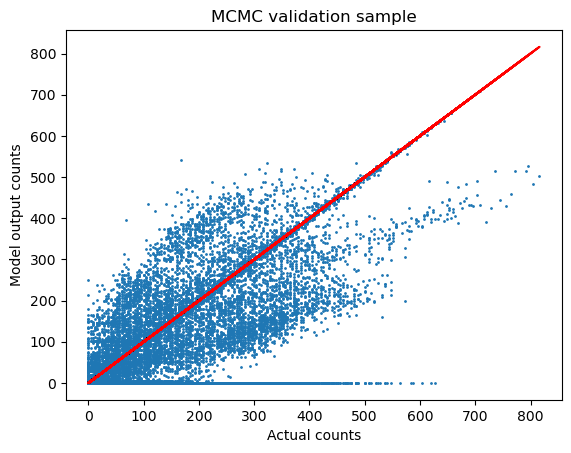

In [245]:
#fig,ax=plt.subplots(1,2,figsize=(10,5))
plt.scatter(Y,yhat, s=1)
plt.plot(Y,Y,"-",color="red")
plt.title('MCMC validation sample')
plt.ylabel("Model output counts")
plt.xlabel("Actual counts")

#plt.savefig(data_dir+"/OSM/"+city+"/MCMC_counts.png")
plt.show()
plt.close()

### Plot every 30 lambda estimates (route flows) on an arbitrary time slice

In [257]:
lam_labels=[]
lamfile=[]
for j in range(0,trace_tuned.shape[1],20):
    string='$\\lambda'+str(j)+'$'
    lam_labels.append(string)
    lamfile.append("lam"+str(j))

In [254]:
print(lam_labels)

['$\\lambda0$', '$\\lambda20$', '$\\lambda40$', '$\\lambda60$', '$\\lambda80$', '$\\lambda100$', '$\\lambda120$', '$\\lambda140$', '$\\lambda160$', '$\\lambda180$', '$\\lambda200$', '$\\lambda220$', '$\\lambda240$', '$\\lambda260$', '$\\lambda280$', '$\\lambda300$', '$\\lambda320$', '$\\lambda340$', '$\\lambda360$', '$\\lambda380$', '$\\lambda400$', '$\\lambda420$', '$\\lambda440$', '$\\lambda460$', '$\\lambda480$', '$\\lambda500$', '$\\lambda520$', '$\\lambda540$', '$\\lambda560$', '$\\lambda580$', '$\\lambda600$', '$\\lambda620$']


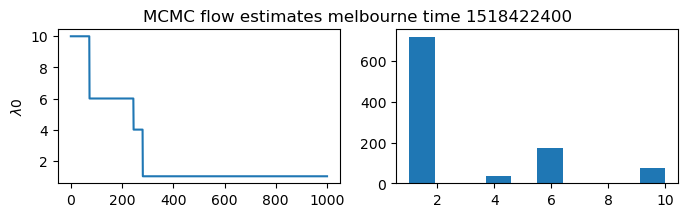

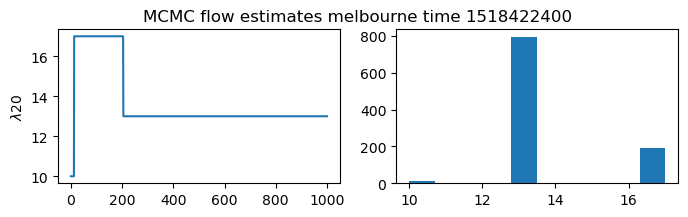

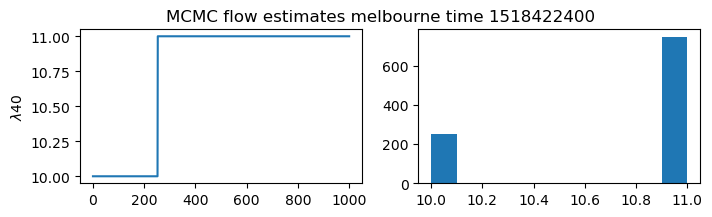

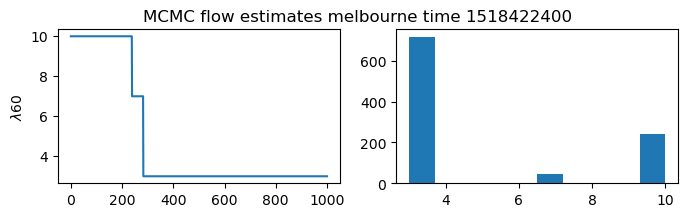

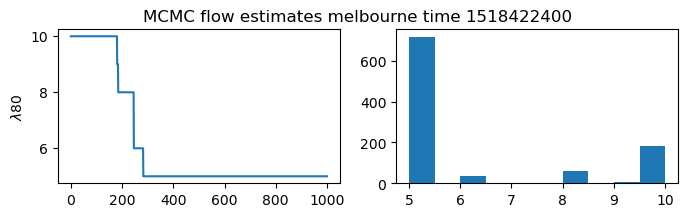

...

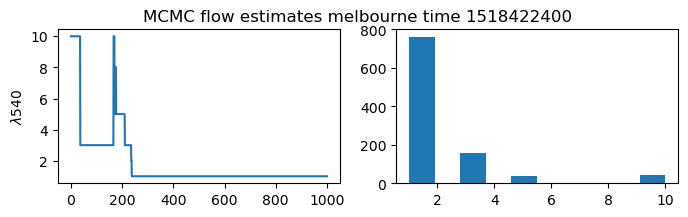

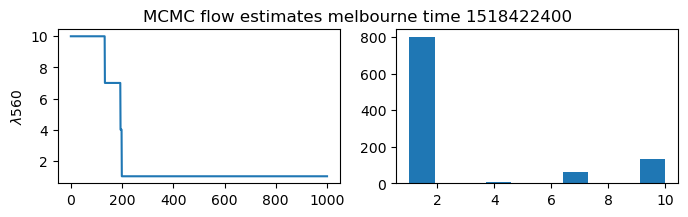

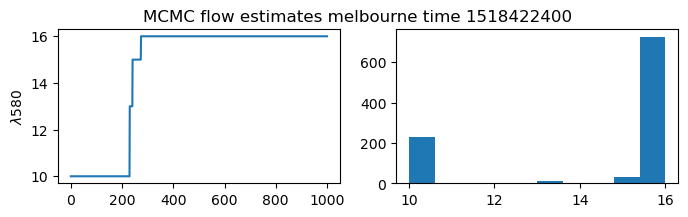

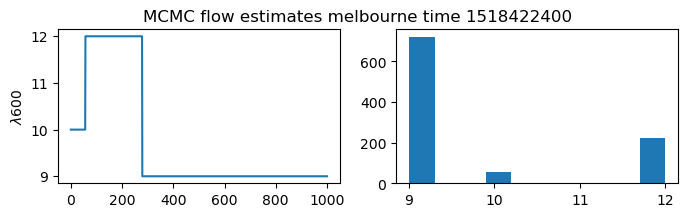

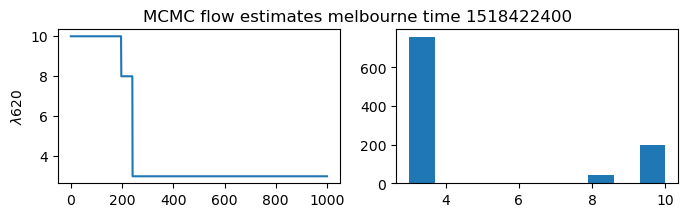

In [260]:
time_slice=2
time_of_day=counts_time[30+time_slice]
lams=trace_tuned[:,:,time_slice]
#lams=trace_tuned
#lam_labels=["$\lambda1$", "$\lambda2$", "$\lambda3$","$\lambda4$","$\lambda5$","$\lambda6$",
#            "$\lambda7$","$\lambda8$","$\lambda9$","$\lambda610$","$\lambda11$","$\lambda12$",
#            "$\lambda13$","$\lambda14$","$\lambda15$","$\lambda16$"]
jj=0
for param, samples in zip(lam_labels, lams.T):
    fig, axes = plt.subplots(1, 2, figsize=(8, 2))
    axes[0].plot(samples)
    axes[0].set_ylabel(param)
    #axes[1].hist(samples[int(len(samples)/2):])
    axes[1].hist(samples)
    plt.suptitle("MCMC flow estimates "+city+" time "+str(time_of_day))
 #   plt.savefig(data_dir+"/OSM/"+city+"/MCMC_"+lamfile[jj]+".png")
    jj+=1
    plt.show()
    plt.close()

### Helper function to calculate autocorrelation of each lambda trace

In [261]:
def autocorr(x, t=1):
    return np.corrcoef(np.array([x[:-t], x[t:]]))

### This assigns the wrong color to each line

In [262]:
def legend_without_duplicate_labels(ax):
    handles, labels = ax.get_legend_handles_labels()
    unique = [(h, l) for i, (h, l) in enumerate(zip(handles, labels)) if l not in labels[:i]]
    ax.legend(*zip(*unique))

# Plot the lamdba trace autocorrelation
- Some time slices are more correlated than others
    - a_b : a is the coefficient (Lambda) and b is the time slice
- These got "stuck" or optimized earlier

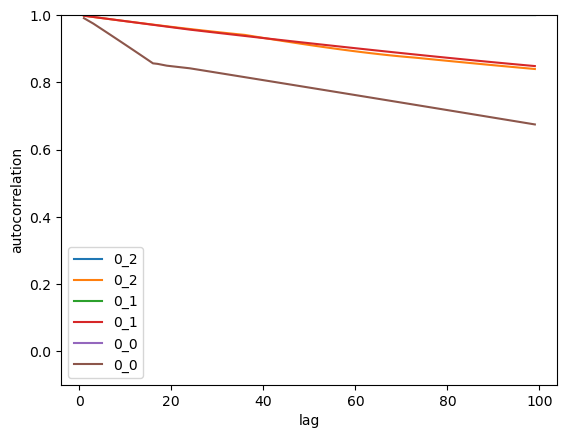

In [263]:
lags = np.arange(1, 100)
fig, ax = plt.subplots()
coeff=0# which lambda to plot
#ax.plot(lags, [autocorr(trace_tuned[:,coeff,4], l)[:,0] for l in lags], label=str(coeff)+'_4')
#ax.plot(lags, [autocorr(trace_tuned[:,coeff,3], l)[:,0] for l in lags], label=str(coeff)+'_3')
ax.plot(lags, [autocorr(trace_tuned[:,coeff,2], l)[:,0] for l in lags], label=str(coeff)+'_2')
ax.plot(lags, [autocorr(trace_tuned[:,coeff,1], l)[:,0] for l in lags], label=str(coeff)+'_1')
ax.plot(lags, [autocorr(trace_tuned[:,coeff,0], l)[:,0] for l in lags], label=str(coeff)+'_0')

#ax.plot(lags, [autocorr(trace_tuned[:,coeff], l)[:,0] for l in lags], label=str(coeff)+'_4')
#ax.plot(lags, [autocorr(trace_tuned[:,coeff], l)[:,0] for l in lags], label=str(coeff)+'_3')
#ax.plot(lags, [autocorr(trace_tuned[:,coeff], l)[:,0] for l in lags], label=str(coeff)+'_2')
#ax.plot(lags, [autocorr(trace_tuned[:,coeff], l)[:,0] for l in lags], label=str(coeff)+'_1')
#ax.plot(lags, [autocorr(trace_tuned[:,coeff], l)[:,0] for l in lags], label=str(coeff)+'_0')
ax.legend()
_ = ax.set(xlabel='lag', ylabel='autocorrelation', ylim=(-.1, 1))

### The mean of lambdas over the final iterations: all results are the same across iterations

### Need lambda in (route flow, time) to calculate od flow matrix (od_pairs, time)

In [264]:
x_flows=trace_tuned[-1,:,:]
od_flow_matrix_mcmc=od_flow_from_route_flow(od_pairs,x_flows)
print(od_flow_matrix_mcmc)

[[ 17.  22.  14.  16.  16.  22.  26.  10.  15.  10.  20.  24.   2.  22.
   27.  27.  14.  15.  17.  22.  11.  11.  16.  21.  37.  14.  32.  21.
   33.  27.  30.  23.  18.  18.  15.  10.  24.  16.  18.  26.  22.  26.
   25.  24.  14.  21.  12.  16.  18.  25.  21.  11.  13.  22.  14.  20.
   14.  16.  20.  23.  20.  20.  16.  18.  24.  20.  20.   7.  19.  17.
   16.  24.  10.  11.  13.  29.  18.  20.  11.  43.  27.  13.   7.  27.
   24.  26.  21.  32.  20.  23.  35. 157.   4.   4.  24.  35.   9.  12.
    2.   2.  18.  22.  25.  22.  21.  29.  35.  25.  20.  22.  19.  26.
   23.  12.  16.  21.  45.  27.  20.  24.  15.  30.  37.  15.  20.  26.
   18.  30.  17.  23.   6.  25.  12.  18.  14.  22.  28.  19.  23.  11.
   19.  24.   9.  18.   3.  30.  19.  12.  16.  17.  13.  14.  25.  15.
   17.  32.  19.  20.  17.  18.  26.  14.  16.  22.  16.  21.  19.  34.
   20.  27.  49.  26.  54.  26.  45.  20.  15.  15.   3.  10.   9.   7.
   24.  31.  28.  12.  19.  22.  19.   6.  21.  23.  13.  24.  1

In [265]:
od_flow_matrix_mcmc.shape# number of OD relations vs. time slices

(319, 287)

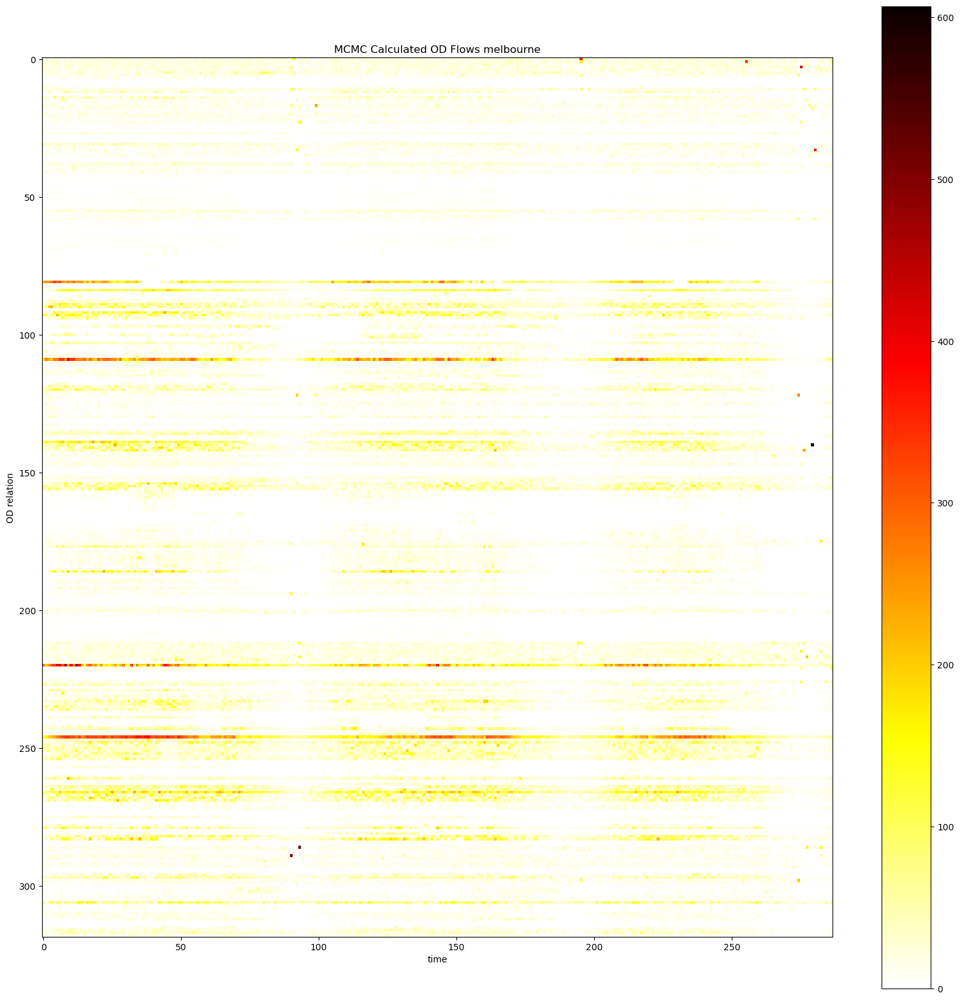

In [274]:
fig, ax = plt.subplots(figsize=(20,20))
im = ax.imshow(od_flow_matrix_mcmc, cmap='hot_r', interpolation='nearest',vmin=0, vmax=np.max(od_flow_matrix_mcmc))

ax.title.set_text('Validation Sample')
ax.set_ylabel("OD relation")
ax.set_xlabel("time")

plt.title("MCMC Calculated OD Flows "+ city)
plt.colorbar(im)
#plt.savefig(data_dir+"/OSM/"+city+"/MCMC_ODFLow_val_heat.png")
# plt.show()


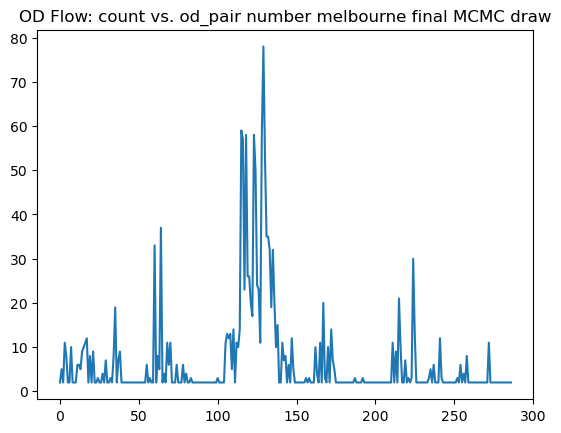

In [276]:
plt.plot(od_flow_matrix_mcmc[245,:])
plt.title("OD Flow: count vs. od_pair number "+city+" final MCMC draw")
#plt.savefig(data_dir+"/OSM/"+city+"/MCMC_ODFLow_val_vs_ODpair.png")
plt.show()
plt.close()

In [271]:
#x_flows=np.mean(trace_tuned,axis=0)
#np.mean(x_flows,axis=1)

print(f"{np.array2string(np.mean(x_flows,axis=1),precision=1, floatmode='fixed')}")
print(f"{np.array2string(np.std(x_flows,axis=1),precision=1, floatmode='fixed')}")
print(np.sum(np.mean(x_flows,axis=1)))

[  9.6  11.4   9.5  11.1   9.4   8.8   9.0  10.8   8.7   9.3   5.3  14.9
   9.4   5.4   3.6   1.0   1.6   1.0   1.1   1.0   3.2   1.0   9.8  10.2
   1.0  20.7   2.5   1.0   1.0  18.9   9.9   8.9   2.2  11.4   2.2   9.3
   2.3   2.6   2.1   9.4   2.2   9.6   1.3   4.9   2.4   9.5   1.0   1.0
   1.0   1.0   1.0   1.0   9.6   2.2   1.0   1.0   1.2   1.0   1.3   2.7
   1.0  19.0   2.2   9.9  11.4   8.7   8.9   1.2   1.8   1.6   1.3   8.9
   9.1   9.3   1.5   1.6   4.3   9.2   1.5   1.6   1.6   1.7   1.1   1.5
   1.0   1.1   1.0   1.0   1.0   1.2   1.0   1.5   1.5   1.0   2.1   1.1
   1.0   1.0   2.8   1.6   1.6   1.2   1.8   1.6   1.3   8.6   9.3   9.2
   1.6   1.7   4.1   9.6   1.4   1.6   1.6   1.5   1.2   1.6   1.0   1.1
   1.0   1.0   1.0   1.3   1.0   1.6   1.7   1.0   2.3   1.2   1.0   1.0
   3.1   1.2   1.0   1.3   1.0   1.2   1.0   1.0   1.0   1.0   1.1   1.0
   1.1   1.0   1.1   1.0   1.0   1.0   1.0   1.0   1.0   1.0   1.0   1.0
   1.0   1.4 111.6   1.0   1.0   1.3   1.0   1.0  6

In [272]:
print("The flows on each edge (one edge per row) in the 5 time slices (one time slice per column")
print("NOTE that all flows equal counts and that edge 2 flows have been imputed by the algorithm")
np.dot(a2ij,x_flows[:,-1])

The flows on each edge (one edge per row) in the 5 time slices (one time slice per column
NOTE that all flows equal counts and that edge 2 flows have been imputed by the algorithm


array([ 59.,  88.,  61., 103., 199.,   0.,  28.,  69.,   0.,  10.,  80.,
        65.,   0.,   8.,  48.,   4., 144., 303.,   0.,  57.,   0., 149.,
         0., 324., 364., 244.,  80., 285.,  62.,  77., 151., 302.,  37.,
       189., 151.,  38., 149.,   0.,   0., 149.,   0., 116., 116.,   0.,
         0.,   0.,   0.,  24.,  75.,   8.,  98., 160., 187., 153.,   0.,
         8.,  75.,   9.,  22., 105.,  12.,   0.,  10.,   0.,  10.,  65.,
         9.,  25., 178.,   0., 114.,  45.,  16., 100., 286.,   6.,  40.,
       149.,  88.,  64.,   0.,  88.,  28.,  68.,   0.,  68.,   0.,   0.,
       170., 147.,  85.,  24., 103.,   5.,   5.,   8., 119.,   0.,  52.,
       189., 158., 168.,   1.,   0., 170., 271., 123.,   0.,  18.,  84.,
       189.,  48., 102., 151., 222.,  52.,  10.,  27.,   2.,  36., 103.,
        58.,  42., 444.,  36.,  56.,  18., 239., 101.,   9.,  69.,  88.,
         9.,  65.,  32.,  62., 136.,   3.,  78.,  61.,  48., 101.,  37.,
       217.,  12.,  32., 189.,  66.,  32.,  67., 17

# CVXPY integer solver doesn't give an answer: x.value = None:

### Here is the mixed integer solver ECOS_BB for x == Integer
- This is with min(least squares). I can't solve it with below-recommended norm. It says there are too few constraints.
<br>
<blockquote>
===============================================================================
                                     CVXPY                                     
                                     v1.3.1                                    
===============================================================================
(CVXPY) Jun 03 07:05:50 PM: Your problem has 62073 variables, 1 constraints, and 0 parameters.
(CVXPY) Jun 03 07:05:50 PM: It is compliant with the following grammars: DCP, DQCP
(CVXPY) Jun 03 07:05:50 PM: (If you need to solve this problem multiple times, but with different data, consider using parameters.)
(CVXPY) Jun 03 07:05:50 PM: CVXPY will first compile your problem; then, it will invoke a numerical solver to obtain a solution.
-------------------------------------------------------------------------------
                                  Compilation                                  
-------------------------------------------------------------------------------
(CVXPY) Jun 03 07:05:50 PM: Compiling problem (target solver=ECOS_BB).
(CVXPY) Jun 03 07:05:50 PM: Reduction chain: Dcp2Cone -> CvxAttr2Constr -> ConeMatrixStuffing -> ECOS_BB
(CVXPY) Jun 03 07:05:50 PM: Applying reduction Dcp2Cone
(CVXPY) Jun 03 07:05:50 PM: Applying reduction CvxAttr2Constr
(CVXPY) Jun 03 07:05:50 PM: Applying reduction ConeMatrixStuffing
(CVXPY) Jun 03 07:05:50 PM: Applying reduction ECOS_BB
(CVXPY) Jun 03 07:05:50 PM: Finished problem compilation (took 1.758e-01 seconds).
-------------------------------------------------------------------------------
                                Numerical solver                               
-------------------------------------------------------------------------------
(CVXPY) Jun 03 07:05:50 PM: Invoking solver ECOS_BB  to obtain a solution.
</blockquote>

https://stackoverflow.com/questions/65526377/cvxpy-returns-infeasible-inaccurate-on-quadratic-programming-optimization-proble

    One particular reformulation that we strongly encourage is to eliminate quadratic forms—that is, functions like sum_square, sum(square(.)) or quad_form—whenever it is possible to construct equivalent models using norm instead. Our experience tells us that quadratic forms often pose a numerical challenge for the underlying solvers that CVX uses.

    We acknowledge that this advice goes against conventional wisdom: quadratic forms are the prototypical smooth convex function, while norms are nonsmooth and therefore unwieldy. But with the conic solvers that CVX uses, this wisdom is exactly backwards. It is the norm that is best suited for conic formulation and solution. Quadratic forms are handled by converting them to a conic form—using norms, in fact! This conversion process poses some interesting scaling challenges. It is better if the modeler can eliminate the need to perform this conversion.


### SCS Solver succeeds but with real values, some of which are very tiny negatives (round to zero)
### Runs Validation in 6min 40 sec

In [270]:
# y = Ax
# We have y and A and want x
# y is m x 1; A is m x n; x is n x 1; m = 5, n = 6
x = cvx.Variable((aij.shape[1], Y.shape[1]),integer=False)

#err = cvx.abs(aij @ x - counts)
#err = cvx.sum_squares(aij @ x - counts100)
err = (aij @ x - Y)
objective = cvx.Minimize(cvx.norm(err)+cvx.norm(x,"inf"))# regularize later with sum(w*aij) see Kurzhanskiy
# https://www.cvxpy.org/tutorial/functions/index.html
#objective = cvx.Minimize(err)
constraints = [x >= 0 ]
prob = cvx.Problem(objective, constraints)

# The optimal objective is returned by prob.solve().
#result = prob.solve(solver="ECOS_BB", verbose=True)
result=prob.solve(verbose=True)

# The optimal value for x is stored in x.value.
print("The flows on the routes (one route per row) in the time slices (one time slice per column)")
print(x.value)

                                     CVXPY                                     
                                     v1.3.1                                    
(CVXPY) Jun 09 02:59:48 PM: Your problem has 179949 variables, 1 constraints, and 0 parameters.
(CVXPY) Jun 09 02:59:48 PM: It is compliant with the following grammars: DCP, DQCP
(CVXPY) Jun 09 02:59:48 PM: (If you need to solve this problem multiple times, but with different data, consider using parameters.)
(CVXPY) Jun 09 02:59:48 PM: CVXPY will first compile your problem; then, it will invoke a numerical solver to obtain a solution.
-------------------------------------------------------------------------------
                                  Compilation                                  
-------------------------------------------------------------------------------
(CVXPY) Jun 09 02:59:48 PM: Compiling problem (target solver=SCS).
(CVXPY) Jun 09 02:59:48 PM: Reduction chain: Dcp2Cone -> CvxAttr2Constr -> ConeMatrixStuffing

In [271]:
print(prob.status)

optimal


In [272]:
np.save(data_dir+"/OSM/"+city+"/route_flows_cvxpy.npy", x.value)

In [273]:
np.sum(x.value)

735763.7143260421

In [274]:
np.set_printoptions(suppress=True)
print(np.mean(x.value,axis=1))

[ 0.          0.          0.          0.          0.         10.10145519
  0.          0.          0.          0.         -0.00002703 10.10113906
  0.          1.62664287  0.00064673 -0.00089036  0.00026105 -0.00127604
  0.00023395 -0.00130314 -0.00003093 -0.00156802  0.          0.
  0.00016227 10.10073844  2.26948906  0.50168157  0.50168157 10.10067248
  0.          0.         -0.00002761  0.         -0.00002761  0.
 -0.00002761  0.00018056 -0.00002761  0.         -0.00002761  0.
 -0.00005463 -0.00002703 -0.00002761  0.         -0.00089036 -0.00089036
 -0.00127604 -0.00127604 -0.00130314 -0.00130314  0.         -0.00002761
 -0.00156802 -0.00156802 10.0970939   0.00013466 -0.00002991  2.26948906
 -0.00002796 10.09678917 -0.00002761  0.          0.          0.
  0.          0.00011647 10.10142121  0.00014349  0.00014385  0.
 10.10145519  0.          0.00014349  0.00014349 10.10131872  0.
  0.00014349  0.00014349  0.00014349  0.00014349  0.00011589  0.00079022
 -0.00074687  0.00040455 -

In [275]:
np.set_printoptions(suppress=True)
print(f"{np.array2string(np.mean(x.value,axis=1),precision=1, floatmode='fixed')}")
print(f"{np.array2string(np.std(x.value,axis=1),precision=1, floatmode='fixed')}")
print(np.sum(np.mean(x.value,axis=1)))

[ 0.0  0.0  0.0  0.0  0.0 10.1  0.0  0.0  0.0  0.0 -0.0 10.1  0.0  1.6
  0.0 -0.0  0.0 -0.0  0.0 -0.0 -0.0 -0.0  0.0  0.0  0.0 10.1  2.3  0.5
  0.5 10.1  0.0  0.0 -0.0  0.0 -0.0  0.0 -0.0  0.0 -0.0  0.0 -0.0  0.0
 -0.0 -0.0 -0.0  0.0 -0.0 -0.0 -0.0 -0.0 -0.0 -0.0  0.0 -0.0 -0.0 -0.0
 10.1  0.0 -0.0  2.3 -0.0 10.1 -0.0  0.0  0.0  0.0  0.0  0.0 10.1  0.0
  0.0  0.0 10.1  0.0  0.0  0.0 10.1  0.0  0.0  0.0  0.0  0.0  0.0  0.0
 -0.0  0.0 -0.0  0.0 -0.0  0.0 -0.0  0.0  0.0  0.0  6.8  0.0  0.0  0.0
 10.1  0.0  0.0  0.0 10.1  0.0  0.0  0.0 10.1  0.0  0.0  0.0 10.1  0.0
  0.0  0.0  0.0  0.0  0.0  0.0 -0.0  0.0 -0.0  0.0 -0.0  0.0 -0.0  0.0
  0.0  0.0  6.8  0.0  0.0  0.0 10.1 10.1 -0.0 10.1 -0.0 10.1 -0.0 -0.0
 -0.0 -0.0  4.9 -0.0  4.9 -0.0  4.9 -0.0 -0.0 -0.0 -0.0 -0.0 -0.0 -0.0
 -0.0 -0.0 -0.0 10.1 10.1  0.5 -0.0 10.1 -0.0 -0.0 10.1 10.1 10.1 10.1
 10.1  0.0 10.1 10.1 10.1 10.1 10.1 10.1 10.1 10.1 10.1 10.1 10.1 10.1
 10.1 10.1 10.1  0.0  0.0  0.0  0.0  0.0 10.1  0.0 10.1  0.0 10.1  0.0
 10.1 

In [276]:
print(od_route_names_dict)
my_dict=od_route_names_dict
name=route_names[0]
print(name)
#value = {i for i in od_route_names_dict if od_route_names_dict[i]==name}
#print("key by value:",value)
key = list(filter(lambda x: my_dict[x] == name, my_dict))
print(key)

{(114607252, 174792857): ((114607252, 174792857, '0'), (114607252, 174792857, '1')), (114607252, 174812848): ((114607252, 174812848, '0'), (114607252, 174812848, '1')), (114607252, 2177124606): ((114607252, 2177124606, '0'), (114607252, 2177124606, '1')), (114607252, 2190483580): ((114607252, 2190483580, '0'), (114607252, 2190483580, '1')), (114607252, 145261423): ((114607252, 145261423, '0'), (114607252, 145261423, '1')), (114607252, 2181275340): ((114607252, 2181275340, '0'), (114607252, 2181275340, '1')), (114607252, 313278043): ((114607252, 313278043, '0'), (114607252, 313278043, '1')), (114607252, 846547082): ((114607252, 846547082, '0'), (114607252, 846547082, '1')), (114607252, 3313134384): ((114607252, 3313134384, '0'), (114607252, 3313134384, '1')), (114607252, 1833110279): ((114607252, 1833110279, '0'), (114607252, 1833110279, '1')), (114607252, 9105320429): ((114607252, 9105320429, '0'), (114607252, 9105320429, '1')), (114607252, 130015096): ((114607252, 130015096, '0'), (11

In [277]:
od_flow_matrix_x=od_flow_from_route_flow(od_pairs,x.value)
np.set_printoptions(suppress=True)
print(od_flow_matrix_x)

[[  0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           

In [278]:
np.set_printoptions(suppress=True)
print(f"{np.array2string(np.mean(od_flow_matrix_x,axis=1),precision=1, floatmode='fixed')}")
print(f"{np.array2string(np.std(od_flow_matrix_x,axis=1),precision=1, floatmode='fixed')}")
print(np.sum(np.mean(x.value,axis=1)))

[ 0.0  0.0 10.1  0.0  0.0 10.1  1.6 -0.0 -0.0 -0.0 -0.0  0.0 10.1  2.8
 10.6  0.0  0.0 -0.0 -0.0  0.0 -0.0 -0.0 -0.0 -0.0 -0.0 -0.0 -0.0 -0.0
 -0.0 10.1  2.3 10.1 -0.0  0.0  0.0  0.0 10.1  0.0 10.1  0.0 10.1  0.0
  0.0  0.0  0.0 -0.0 -0.0 -0.0  0.0  6.8  0.0 10.1  0.0 10.1  0.0 10.1
  0.0 10.1  0.0  0.0  0.0  0.0 -0.0 -0.0 -0.0  0.0  6.8  0.0 10.1 10.1
 10.1 10.1 -0.0  4.9  4.9  4.9 -0.0 -0.0 -0.0 -0.0 -0.0 20.2  0.5 10.1
 10.1 20.2 20.2 10.1 20.2 20.2 20.2 20.2 20.2 20.2 20.2  0.0  0.0 10.1
 10.1 10.1 10.1 20.2 10.1 20.2 14.1 14.1 20.2 20.2 20.2 10.1 20.2 20.2
 10.1 10.1 10.1 16.1 10.1 10.1 20.2 10.1 20.2 20.2 -0.0 13.5 13.5 10.1
 15.7 13.5 13.5 13.5 15.7 -0.0 -0.0 13.5 20.2 12.1 20.2 10.1  5.6 10.1
 10.1 10.1 10.1 10.1 -0.0 10.1 10.1 10.1 -0.0 -0.0 -0.0 -0.0  0.0 10.1
 10.1 12.6 12.6 10.1 10.1 10.1  4.3 -0.0  4.3  4.3 -0.0 10.1 -0.0 -0.0
 10.1 -0.0  1.0 10.1 10.1 10.1 10.1  0.0  7.1 10.1  7.1 14.2 14.2 17.2
 14.2 14.2 10.1  8.6 17.2 -0.0 -0.0 14.2 10.1  2.5 10.6  7.1  0.0  0.0
  0.0 

In [279]:
np.set_printoptions(suppress=True)
print(od_flow_matrix_x)

[[  0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           

In [280]:
print("The flows on each edge (one edge per row) (one time slice per column")
print("NOTE that all flows equal counts and that uncounted edge flows have been imputed by the algorithm")
np.dot(a2ij,x.value)

The flows on each edge (one edge per row) (one time slice per column
NOTE that all flows equal counts and that uncounted edge flows have been imputed by the algorithm


array([[   7.85465912,    8.84146321,    8.02780986,  101.67275134,
         164.2781945 ,  233.09427241,  241.25217771,  260.32801787,
         258.37448164,  277.58112761,  277.5996002 ,  236.33575267,
         234.17779825,  196.2536145 ,  169.43354577,  213.54894812,
         171.25994041,  200.28773388,  221.82026673,  165.47224339,
         172.64094231,  224.49425132,  227.55506895,  220.59564843,
         184.29943629,  232.79099696,  214.42590539,  135.99978306,
         227.13321776,  214.34352128,  211.57852898,  233.92564592,
         275.24835602,  251.20803598,  306.33209704,  317.92514029,
         221.88403628,  268.54486136,  235.09274579,  169.82465822,
         250.44785495,  350.98661066,  311.96126388,  372.20642765,
         318.83500603,  334.97269249,  330.60594347,  314.27628401,
         306.78718567,  265.09495029,  328.55180396,  255.17427547,
         253.89834151,  251.56389192,  163.86823091,  208.56626409,
         178.34990891,   56.58499265,   58.68726

In [281]:
yhats=(aij @ x.value)

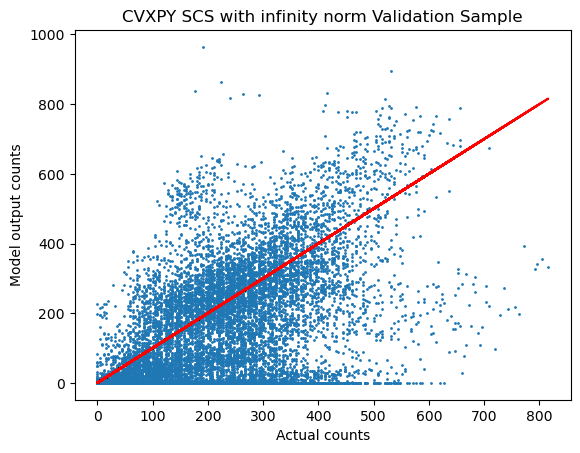

In [283]:
#fig,ax=plt.subplots(1,2,figsize=(10,5))
plt.scatter(Y,yhats, s=1)
plt.plot(Y,Y,"-",color="red")
plt.title('CVXPY SCS with infinity norm Validation Sample')
plt.ylabel("Model output counts")
plt.xlabel("Actual counts")

plt.savefig(data_dir+"/OSM/"+city+"/CVXPY_counts.png")
plt.show()
plt.close()

### Heatmap of OD flow vs time CVXPY

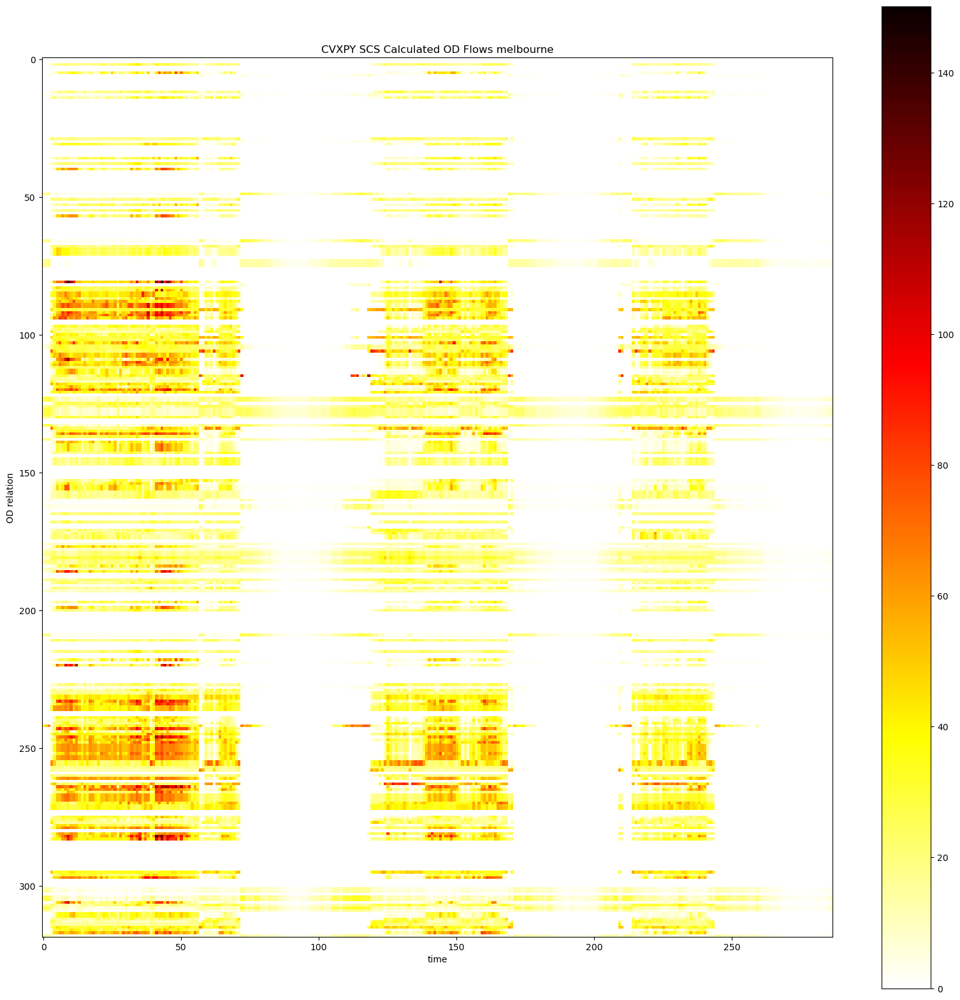

In [285]:
fig, ax = plt.subplots(figsize=(20,20))
im = ax.imshow(od_flow_matrix_x, cmap='hot_r', interpolation='nearest',vmin=0, vmax=np.max(od_flow_matrix_x))

ax.title.set_text('Validation Sample')
ax.set_ylabel("OD relation")
ax.set_xlabel("time")

plt.title("CVXPY SCS Calculated OD Flows "+ city)
plt.colorbar(im)
plt.savefig(data_dir+"/OSM/"+city+"/CVXPY_ODFLow_val_heat.png")
plt.show()
plt.close()

# Try first model using aij incidence matrix rather than the Markov transition matrix of Dey

In [286]:
import torch
from torch import nn
torch_device = (
    "cuda"
    if torch.cuda.is_available()
    else "mps"
    if torch.backends.mps.is_available()
    else "cpu"
)
print(f"Using {torch_device} device")

Using cuda device


# First model is an MLP

In [287]:
# Set run hyperparameters
# Set fixed random number seed
torch.manual_seed(42)
lrate=1e-6#1e-6 aij, 1e-7 P_mat
l1size=512#256 toy 512 melbourne
l2size=1024#256 toy 1024 melbourne
n_epochs=300#3000
l1_lambda=0.01#.01
J=aij.shape[1]# J is number of routes
#J=P_mat.shape[1]
I=aij.shape[0]# I is the number of edges with counts
#Nt=counts100.shape[1]# Nt is number of time slices
xsize=J# X output is number of routes x number of time slices
ysize=I# Number of links with counts
plttitle="MLP Melbourne center model: "
modelname="MLP_aij_cyclic_LR"

# Note that at each instance we input len(counts) values and expect to generate len(routes) values

In [288]:
import os
import torch
from torch import nn
from torch.utils.data import DataLoader
from torchvision import transforms

# Initialize input weights
def w0_(size):
  w0 = size[0]
  weight= 1./np.sqrt(w0)
  #weight=1/w0
 # print(f"w0 weights {weight}")
  w0_matrix=torch.Tensor(size).uniform_(-weight,weight)
 # print(f"init weight matrix {w0_matrix.cpu()}")
  return w0_matrix

class MLP(nn.Module):
  '''
    Multilayer Perceptron.
  '''
  def __init__(self, ysize=ysize, xsize=xsize, l1n=l1size, l2n=l2size):
    super().__init__()

#   Network
    
    self.linear1=nn.Linear(ysize, l1n, bias=True)
    self.linear1.weight.data = w0_(self.linear1.weight.data.size())

    self.linear2=nn.Linear(l1n, l2n, bias=True)
    self.linear2.weight.data = w0_(self.linear2.weight.data.size())
    
    self.linear4=nn.Linear(l2n, xsize, bias=True)
    self.linear4.weight.data = w0_(self.linear4.weight.data.size())
    
    self.relu=nn.ReLU()

  def forward(self, y):
    '''Forward pass'''
    
    x = self.linear1(y)
    x = self.relu(x)
    x = self.linear2(x)
    x = self.relu(x)
    x = self.linear4(x)
    #print(f"self.linear3 {x.grad_fn}")
    x = self.relu(x)
    return x

# Train the MLP
### Would be nice to have day of week, hour of day or time period additionally for a useful model
### This model calculates OD flow based on a set of counts on the road segments
### To get an integer-value model, would I have to categorize each X?

### Maybe apply STSGCN



### Split train, validation, test
- splitting a time series can only be done without shuffling and without cross-validation
- however we are not estimating a time-dependent model with MLP

In [289]:
i_tr=int(0.75*(counts.shape[1]))
i_va=i_tr+int(0.2*(counts.shape[1]))
print(i_tr, i_va)

1080 1368


In [290]:
# Prepare  dataset

# Train
ytrain=torch.from_numpy(counts[:,0:i_tr]).float().to(torch_device)# leaf, not requires grad
print(f"ytrain is on device: {ytrain.get_device()}")
trainloader = torch.utils.data.DataLoader(ytrain.T, batch_size=1)
#print(f"ytrain {ytrain.grad_fn} {ytrain.is_leaf}")
# Validation
yval=torch.from_numpy(counts[:,i_tr+1:i_va]).float().to(torch_device)# leaf, not requires grad
print(f"ytrain is on device: {yval.get_device()}")
valloader = torch.utils.data.DataLoader(yval.T, batch_size=1)
# Test
ytest=torch.from_numpy(counts[:,i_va+1:]).float().to(torch_device)# leaf, not requires grad
print(f"ytrain is on device: {ytest.get_device()}")
testloader = torch.utils.data.DataLoader(ytest.T, batch_size=1)
print(f"trainsize: {ytrain.shape[1]}, valsize: {yval.shape[1]}, testsize: {ytest.shape[1]}")


ytrain is on device: 0
ytrain is on device: 0
ytrain is on device: 0
trainsize: 1080, valsize: 287, testsize: 71


In [293]:
# Initialize the MLP
#mlp=MLP(ysize,xsize,l1size,l2size)
mlp=MLP()
mlp.to(torch_device)
#print(f"mlp is on device: {next(mlp.parameters()).device}")

print(mlp)
  
# Define the loss function and optimizer
loss_function = nn.MSELoss()
#loss_function = nn.L1Loss()

optimizer = torch.optim.Adam(mlp.parameters(), lr=lrate)
scheduler = torch.optim.lr_scheduler.CyclicLR(optimizer, base_lr=1e-6, max_lr=1e-4,step_size_up=15,mode="exp_range", cycle_momentum=False)

#optimizer = torch.optim.SGD(mlp.parameters(), lr=lrate)

# Run the training loop

trainloss_trace=[]
valloss_trace=[]
avtrainloss_trace=[]
avvalloss_trace=[]
yhats_train=np.zeros((ytrain.shape[1],ytrain.shape[0]))# ytrain.T*0.
out_train_cpu=np.zeros((ytrain.shape[1],J))#x.value.T*0
yhats_val=np.zeros((yval.shape[1],yval.shape[0]))#yval.T*0.
out_val_cpu=np.zeros((yval.shape[1],J))#x.value.T*0

# Set the adjacency matrix (edges x routes) or the transition matrix (edges x od's)

Atorch=torch.from_numpy(aij.T).float().to(torch_device) # Transpose adjacency matrix
#Atorch=torch.from_numpy(P_mat.T).float().to(torch_device) # Transpose adjacency matrix
    
for epoch in range(0, n_epochs): # 5 epochs at maximum
  train_epoch_loss=0.  
  val_epoch_loss=0.
  # Print epoch
  #if(epoch % 100 == 0):
  print(f'Starting epoch {epoch+1}')
    
# Train
  for i, data in enumerate(trainloader):# iterate through time steps

    inputs = data.float() # there are no targets/labels
    #print(f"inputs on device: {inputs.get_device()}")
    inputs = inputs.to(torch_device)
    #print(f"inputs cast to device: {inputs.get_device()}")
   
  # Zero the gradients
    optimizer.zero_grad()
      
  # Perform forward pass
    #print(f"ytrain[:,i] {ytrain[:,i].grad_fn} {ytrain[:,i].is_leaf}")
    outputs = mlp(inputs)
    
  # Calculate loss
    yhat = (outputs @ Atorch).to(torch_device)# grad, no leaf

  #yhat = torch.tensor(Atorch @ outputs,dtype=torch.float,requires_grad=True).to(device)# no grad, leaf
  #print(f"outputs {outputs.grad_fn} {outputs.is_leaf}")
   # print(f"yhat {yhat.grad_fn} {yhat.is_leaf}")

    loss = loss_function(yhat,inputs)
  # L1 regularization
    l1_norm = sum(torch.linalg.norm(p, 1) for p in mlp.parameters())
    loss = loss + l1_lambda * l1_norm
  #loss=loss_function(outputs,targets)
  
# Perform backward pass
    loss.backward()

# Perform optimization
    optimizer.step()
    scheduler.step()
          
  # Print statistics
    train_epoch_loss += loss.item()
    trainloss_trace.append(loss.item())
    #print(loss.item())

    if(epoch==n_epochs-1):
        yhats_train[i,:]=yhat.detach().cpu().numpy()
        out_train_cpu[i,:]=outputs.detach().cpu().numpy()
  avtrainloss_trace.append(train_epoch_loss/i)

# Validation
  for i, data in enumerate(valloader):
    inputs = data.float()
    inputs = inputs.to(torch_device)
    mlp.eval()
    with torch.no_grad():
      outputs = mlp(inputs)
      yhat = (outputs @ Atorch).to(torch_device)
      loss = loss_function(yhat, inputs)
# L1 regularization
      l1_norm = sum(torch.linalg.norm(p, 1) for p in mlp.parameters())      
      loss = loss + l1_lambda * l1_norm
      val_epoch_loss += loss.item()
      valloss_trace.append(loss.item())
    mlp.train()
    valloss_trace.append(loss.item())
    if(epoch==n_epochs-1):
      yhats_val[i,:]=yhat.detach().cpu().numpy()
      out_val_cpu[i,:]=outputs.detach().cpu().numpy()
  avvalloss_trace.append(val_epoch_loss/i)
# Process is complete.
print("Done training")


MLP(
  (linear1): Linear(in_features=67, out_features=512, bias=True)
  (linear2): Linear(in_features=512, out_features=1024, bias=True)
  (linear4): Linear(in_features=1024, out_features=627, bias=True)
  (relu): ReLU()
)
Starting epoch 1
Starting epoch 2
Starting epoch 3
Starting epoch 4
Starting epoch 5
Starting epoch 6
Starting epoch 7
Starting epoch 8
Starting epoch 9
Starting epoch 10
Starting epoch 11
Starting epoch 12
Starting epoch 13
Starting epoch 14
Starting epoch 15
Starting epoch 16
Starting epoch 17
Starting epoch 18
Starting epoch 19
Starting epoch 20
Starting epoch 21
Starting epoch 22
Starting epoch 23
Starting epoch 24
Starting epoch 25
Starting epoch 26
Starting epoch 27
Starting epoch 28
Starting epoch 29
Starting epoch 30
Starting epoch 31
Starting epoch 32
Starting epoch 33
Starting epoch 34
Starting epoch 35
Starting epoch 36
Starting epoch 37
Starting epoch 38
Starting epoch 39
Starting epoch 40
Starting epoch 41
Starting epoch 42
Starting epoch 43
Starting epo

In [294]:
# save torch model
#torch.save(mlp.state_dict(), data_dir+"/OSM/"+city+"/"+modelname+".pth")

#Load:

#model = TheModelClass(*args, **kwargs)
#model.load_state_dict(torch.load(PATH))
#model.eval()

# save output
np.savez(data_dir+"/OSM/"+city+"/"+modelname+"_out",yhats_train=yhats_train, yhats_val=yhats_val,out_train_cpu=out_train_cpu, 
         out_val_cpu=out_val_cpu,avtrainloss_trace=avtrainloss_trace, avvalloss_trace=avvalloss_trace)
# load with np.load(filename)

In [295]:
yhat.shape

torch.Size([1, 67])

# Learning Curve: The train and validation losses are strongly dependent on the samples used to train/validate
### 70/20 validation loss > train loss vs 80/20 it is flipped. At 75/20 it looks "normal"
### The reason could be due to loss_train being averaged over many iters while training;
### while loss_val is only the final model of the train iters for all val instances
### Though long training reduces loss gradually, there is no sign of overfitting causing validation loss to diverge from train loss
### Would batches >1 with batch-average training loss give a better picture and maybe produce better convergence

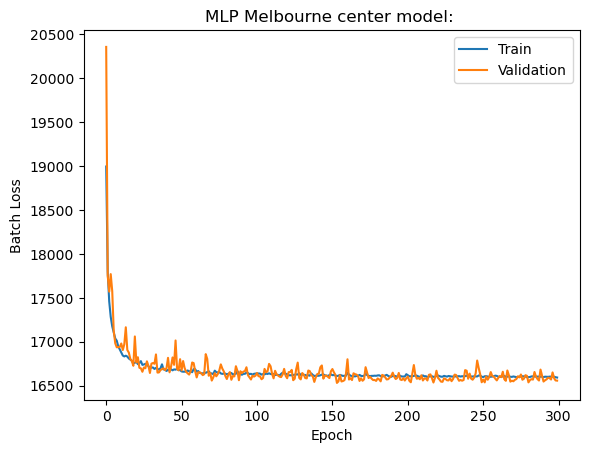

In [298]:
plt.plot(range(n_epochs),avtrainloss_trace, label="Train")
plt.plot(range(n_epochs),avvalloss_trace, label="Validation")
plt.title(plttitle)
plt.ylabel("Batch Loss")
plt.xlabel("Epoch")
plt.legend()
plt.savefig(data_dir+"/OSM/"+city+"/"+modelname+"_loss.png")
plt.show()

# Calculated vs. Measured Link Counts
- These should be reproduced perfectly from the model
- Zeros are probably detectors that are not on routes
- There are fewer zero model outputs with more routes-per-OD

In [299]:
print(yhats_train.shape,ytrain.shape)

(1080, 67) torch.Size([67, 1080])


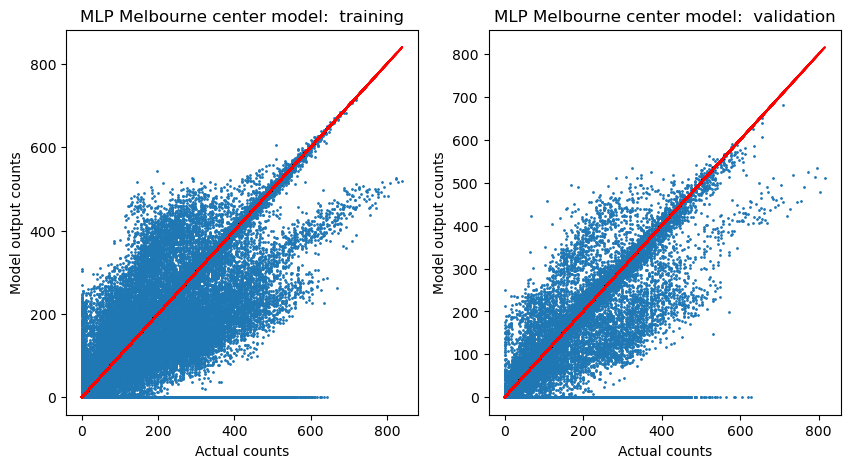

In [300]:
fig,ax=plt.subplots(1,2,figsize=(10,5))
ax[0].scatter(ytrain.detach().cpu().numpy(),yhats_train.T, s=1)
ax[0].plot(ytrain.detach().cpu().numpy(),ytrain.detach().cpu().numpy(),"-",color="red")
ax[0].title.set_text(plttitle+' training')
ax[0].set_ylabel("Model output counts")
ax[0].set_xlabel("Actual counts")

ax[1].scatter(yval.detach().cpu().numpy(),yhats_val.T,s=1)
ax[1].plot(yval.detach().cpu().numpy(),yval.detach().cpu().numpy(),"-",color="red")
ax[1].title.set_text(plttitle+" validation")
ax[1].set_ylabel("Model output counts")
ax[1].set_xlabel("Actual counts")
plt.savefig(data_dir+"/OSM/"+city+"/"+modelname+"_counts.png")
plt.show()




### Which routes and what model behavior are causing this dispersion?

# Route flows from the model
- These are the most likely route flows given the underdetermined system based on link counts

In [301]:
np.set_printoptions(suppress=True)
print(f"{np.array2string(out_train_cpu.T,precision=1, floatmode='fixed')}")
print("-----------------")
#if((x.value == None)==False):
#    print(f"{np.array2string(x.value,precision=1, floatmode='fixed')}")

[[  0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0
    0.0   0.1   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.1
    0.1   0.0   0.1   0.0   0.1   0.0   0.0   0.1   0.0   0.0   0.1   0.0
    0.2   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0
    0.0   0.1   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.1   0.0   0.0
    0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0
    0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0
    0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0
    0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0
    0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.1   0.1   0.0   0.0
    0.0   0.0   0.0   0.1   0.2   0.0   0.2   0.1   0.0   0.1   0.1   0.1
    0.1   0.0   0.0   0.1   0.2   0.1   0.0   0.0   0.0   0.0   0.0   0.0
    0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0
    0.0   0.0   0.0   0.0   0.0   0.0 

In [ ]:
#   if((x.value == None)==False):
#       plt.scatter(x.value, out_train_cpu.T)
#       plt.plot(x.value, x.value, "-", color="red")
#       plt.title(plttitle)
#       plt.ylabel("Route Flow")
#       plt.xlabel("cvxpy route flow")

# The OD flows are sums of the route flows over each OD for a_ij, they are out_xxx_cpu for P_mat
- They represent the most likely flows given the underdetermined system based on the link counts

In [ ]:
(out_train_cpu.shape)

In [303]:
#np.set_printoptions(suppress=True)
print(od_pairs)
od_flow_matrix_train_mlp=od_flow_from_route_flow(od_pairs,out_train_cpu.T)
od_flow_matrix_val_mlp=od_flow_from_route_flow(od_pairs,out_val_cpu.T)
print(f"{np.array2string(od_flow_matrix_train_mlp,precision=1, floatmode='fixed')}")
print("-----------------")
print(f"{np.array2string(od_flow_matrix_val_mlp,precision=1, floatmode='fixed')}")
#if((x.value == None)==False):
#    print(od_flow_matrix_x)

[(114607252, 174792857), (114607252, 174812848), (114607252, 2177124606), (114607252, 2190483580), (114607252, 145261423), (114607252, 2181275340), (114607252, 313278043), (114607252, 846547082), (114607252, 3313134384), (114607252, 1833110279), (114607252, 9105320429), (114607252, 130015096), (114607252, 1449431464), (114607252, 26034664), (114607252, 277089929), (114607252, 2180785617), (114607252, 113536277), (130015096, 174792857), (130015096, 174812848), (130015096, 2177124606), (130015096, 2190483580), (130015096, 145261423), (130015096, 2181275340), (130015096, 313278043), (130015096, 846547082), (130015096, 3313134384), (130015096, 1833110279), (130015096, 113536277), (130015096, 9105320429), (130015096, 1449431464), (130015096, 26034664), (130015096, 277089929), (130015096, 2180785617), (130015096, 114607252), (145261423, 2177124606), (174792857, 174812848), (174792857, 2181275340), (174792857, 313278043), (174792857, 2177124606), (174792857, 2190483580), (174792857, 114607252

In [ ]:
# If P_mat which is dim (I, OD)
#od_flow_matrix_train_mlp=out_train_cpu.T
#od_flow_matrix_val_mlp=out_val_cpu.T

### Hours of traffic in the counts

In [ ]:
print(ytrain.shape[1]*900/3600., yval.shape[1]*900/3600.)

### The OD flows. Maybe plot them on the network

In [ ]:
print(np.sum(od_flow_matrix_train_mlp,axis=1).astype(int))

In [ ]:
np.argmax(np.sum(od_flow_matrix_train_mlp,axis=1))

In [ ]:
od_flow_matrix_train_mlp.shape

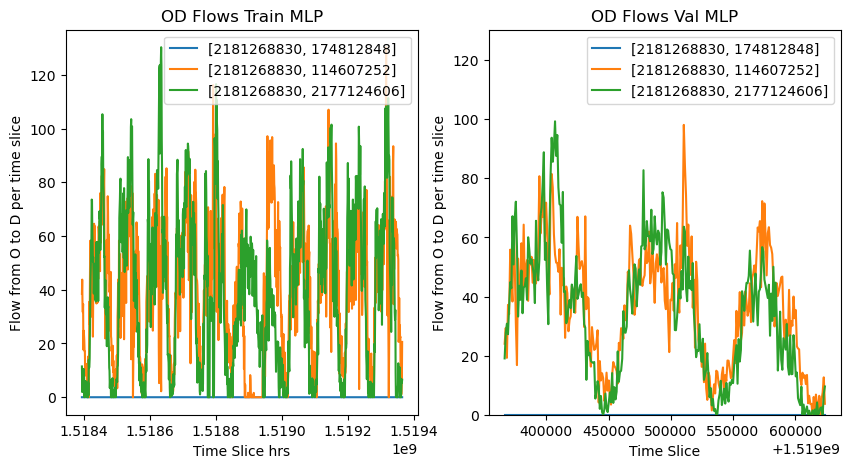

In [304]:
#xx_tr=np.array(range(0,od_flow_matrix_train_mlp.shape[1]))/4.
xx_tr=counts_time[0:i_tr]
#xx_val=np.array(range(0,od_flow_matrix_val_mlp.shape[1]))/4.
xx_val=counts_time[i_tr+1:i_va]
ymax=0
fig,ax=plt.subplots(1,2,figsize=(10,5))
for ii in range(232,235):#range(counts.shape[0]):
    y=od_flow_matrix_train_mlp[ii,:]
    y[np.where(np.isnan(y))]=0
    if(ymax < np.max(y)):
        ymax=np.max(y)
    ax[0].plot(xx_tr,od_flow_matrix_train_mlp[ii,:], label=str(list(od_pairs[ii])))
plt.ylim(0,ymax)
ax[0].set_xlabel("Time Slice hrs")
ax[0].set_ylabel("Flow from O to D per time slice")
ax[0].legend()
ax[0].title.set_text("OD Flows Train MLP")

for ii in range(232,235):#range(counts.shape[0]):
    y=od_flow_matrix_val_mlp[ii,:]
    y[np.where(np.isnan(y))]=0
    if(ymax < np.max(y)):
        ymax=np.max(y)
    ax[1].plot(xx_val,od_flow_matrix_val_mlp[ii,:], label=str(list(od_pairs[ii])))
plt.ylim(0,ymax)
plt.xlabel("Time Slice")
plt.ylabel("Flow from O to D per time slice")
plt.legend()
plt.title("OD Flows Val MLP")
plt.savefig(data_dir+"/OSM/"+city+"/"+modelname+"_ODflows.png")
plt.show()

In [ ]:
#   if((x.value == None)==False):
#       plt.scatter(od_flow_matrix_x,od_flow_matrix_train_mlp)
#       plt.plot(od_flow_matrix_x, od_flow_matrix_x, "-",color="red")
#       plt.title(plttitle)
#       plt.ylabel("OD Flow MLP")
#       plt.xlabel("OD Flow cvxpy")

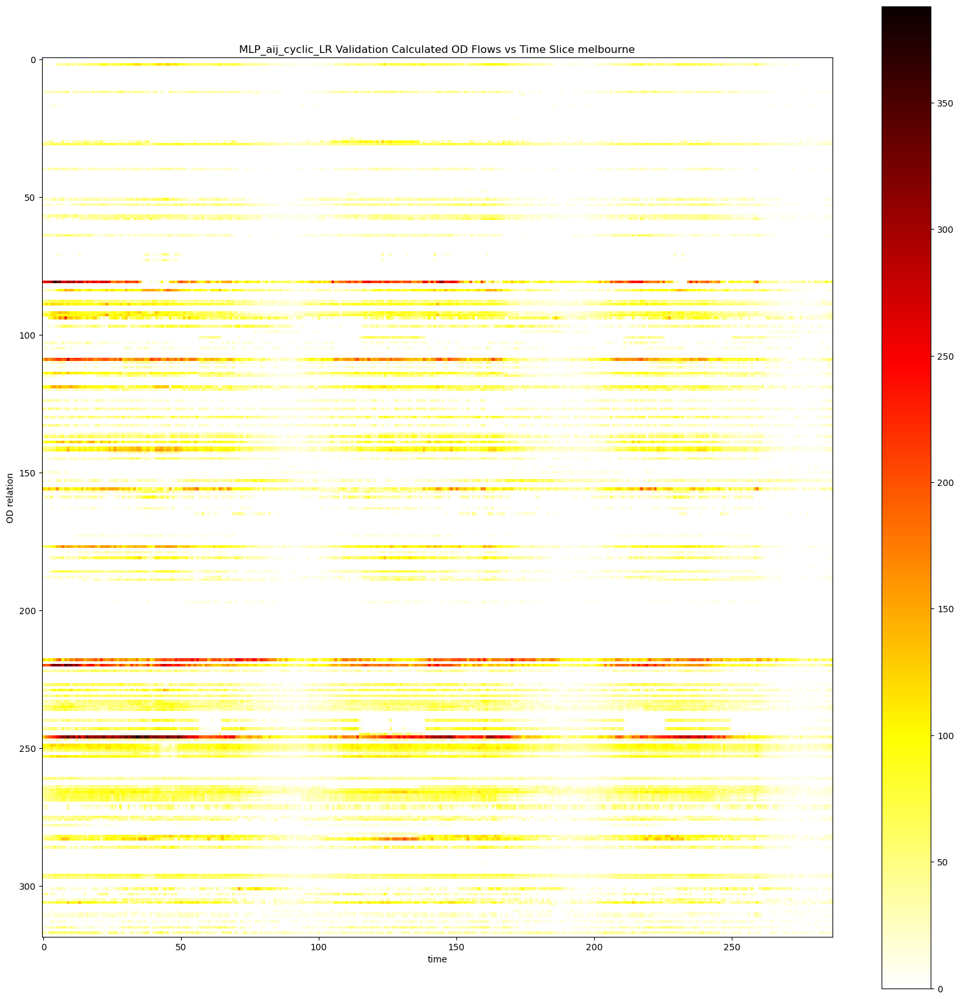

In [305]:
fig, ax = plt.subplots(figsize=(20,20))
im = ax.imshow(od_flow_matrix_val_mlp, cmap='hot_r', interpolation='nearest',vmin=0, vmax=np.max(od_flow_matrix_val_mlp))

ax.title.set_text('Time 30')
ax.set_ylabel("OD relation")
ax.set_xlabel("time")

plt.title(modelname + " Validation Calculated OD Flows vs Time Slice "+ city)
plt.colorbar(im)
plt.savefig(data_dir+"/OSM/"+city+"/"+modelname+"_ODFLow_val_heat.png")
plt.show()
plt.close()

# Issues: many 0-value route flows from MLP
### These are centrally-located nodes which are on routes, random which ones though
### Layer Bias = True
- Setting layer bias to true improves agreement with counts and there are fewer 0-value route flows
### Decrease learning rate
- 1e-6 needs 2000 epochs, 5/16 0-values if left to minimize loss (only 2 if 1000 epochs but not min loss)
### Increase learning rate
- 1e-2 fast learning drop in 3 epochs, bumps 5,40 epochs, still 0-value route flows
### Shuffle counts input with Dataloader does this affect order of X outputs?
- Something is really wrong with this result as the counts now also have zeroes
### L1 loss instead of MLE (L2)
- A less-even decrease in loss, slower loss decline, still 5 0-value routes just different ones
- Note L1-loss is "built in" to the system (Krzhansky)
### L1-Regularization with MSE (Lasso), sweep lambda
- As in CompressedSensing_1.ipynb
- Regularization is suited for sparse solution
- Best lambda 0.01: best loss also gives fewest zero-value route flows
### Forcing NN to integer-value solutions
- Gradients would be unpredictable
- Round off float results?
- Constrain model and input to UINT for inference on CPU but no training
- Logit/Sigmoid output layer for categorical int output

In [ ]:
def run_model(l1_lambda):
# Prepare  dataset

#trainloader = torch.utils.data.DataLoader(dataset, batch_size=10, shuffle=True, num_workers=1)

    ytrain=torch.from_numpy(counts).float().to(torch_device)# leaf, not requires grad
    print(f"ytrain is on device: {ytrain.get_device()}")
    trainloader = torch.utils.data.DataLoader(ytrain.T)
#trainloader = torch.utils.data.DataLoader(ytrain.T, batch_size=1, shuffle=False, num_workers=1)


#print(f"ytrain {ytrain.grad_fn} {ytrain.is_leaf}")

# Initialize the MLP
#mlp=MLP(ysize,xsize,l1size,l2size)
    mlp=MLP()
    mlp.to(torch_device)
  #  print(f"mlp is on device: {next(mlp.parameters()).device}")

  #  print(mlp)

# Define the loss function and optimizer
    loss_function = nn.MSELoss()
#loss_function = nn.L1Loss()

    optimizer = torch.optim.Adam(mlp.parameters(), lr=lrate)
#optimizer = torch.optim.SGD(mlp.parameters(), lr=lrate)

# Run the training loop

    loss_trace=[]
    avloss_trace=[]
    yhats=counts.T*0.
    out_cpu=x.value.T*0
    
    for epoch in range(0, n_epochs): # 5 epochs at maximum
        batch_loss=0.  
  # Print epoch
  #if(epoch % 100 == 0):
        #print(f'Starting epoch {epoch+1}')
    
# Train
        for i, data in enumerate(trainloader):# iterate through time steps

            inputs = data.float() # there are no targets/labels
    #print(f"inputs on device: {inputs.get_device()}")
            inputs = inputs.to(torch_device)
    #print(f"inputs cast to device: {inputs.get_device()}")
   
  # Zero the gradients
            optimizer.zero_grad()
      
  # Perform forward pass
    #print(f"ytrain[:,i] {ytrain[:,i].grad_fn} {ytrain[:,i].is_leaf}")
            outputs = mlp(inputs)
  
            Atorch=torch.from_numpy(aij.T).float().to(torch_device) # Transpose adjacency matrix
    
  # Calculate loss
            yhat = (outputs @ Atorch).to(torch_device)# grad, no leaf

  #yhat = torch.tensor(Atorch @ outputs,dtype=torch.float,requires_grad=True).to(device)# no grad, leaf
  #print(f"outputs {outputs.grad_fn} {outputs.is_leaf}")
   # print(f"yhat {yhat.grad_fn} {yhat.is_leaf}")

            loss = loss_function(yhat,inputs)
  # L1 regularization
            l1_norm = sum(torch.linalg.norm(p, 1) for p in mlp.parameters())
            loss = loss + l1_lambda * l1_norm
  #loss=loss_function(outputs,targets)
  
# Perform backward pass
            loss.backward()

# Perform optimization
            optimizer.step()
      
  # Print statistics
            batch_loss += loss.item()
            loss_trace.append(loss.item())
    #print(loss.item())

            if(epoch==n_epochs-1):
                yhats[i,:]=yhat.detach().cpu().numpy()
                out_cpu[i,:]=outputs.detach().cpu().numpy()
        avloss_trace.append(batch_loss/i)
# Process is complete.
    print("Done training")
    return(avloss_trace, yhats, out_cpu)

### Sweep over lambdas for L1 Norm weight

In [ ]:
#minloss=9999999.
#for i in range(-5,3):
#    l1_lambda=10.**i
#    v1,v2,v3=run_model(l1_lambda)
#    if(np.min(v1)<minloss):
#        minloss=np.min(v1)
#        minlambda=l1_lambda
#        print(f"minloss {minloss} minlambda {minlambda}")

# Best lamdba is 0.01
# Check that the MLP has learned itself out with the final lambda

In [ ]:
#plt.plot(range(5*n_epochs),loss_trace)
plt.plot(range(n_epochs),v1)
plt.title(plttitle)
plt.ylabel("Batch Loss")
plt.xlabel("Epoch")